In [1]:
## 20240308 NF/FF Flights with fixed pulsing cadence over WLC... (use WLC Site named for each polarization!)
## Group 1: ch0=Bicolog, ch1=Telescope_Y_NSpol
    ## 'FLY001Airdata.csv' - Altitude ~60m, Yaw ~0deg  --> FFNS
    ## 'FLY002Airdata.csv' - Altitude ~10m, Yaw ~0deg   --> NFNS
## Group 2: ch0=Telescope_X_EWpol, ch1=Bicolog
    ## 'FLY003Airdata.csv' - Altitude ~10m, Yaw ~90deg  --> NFEW
    ## 'FLY004Airdata.csv' - Altitude ~60m, Yaw ~90deg --> FFEW

##From loadD3Adata_Dallas.py:
from matplotlib.pyplot import *
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
from matplotlib.ticker import MultipleLocator

import numpy as np
import h5py
##From WT:
import datetime
import pytz
import os
import glob
from matplotlib import colors
import pandas
import csv
import pickle
%matplotlib inline
import beamcals
from beamcals import corr
from beamcals import concat
from beamcals import drone
from beamcals import bicolog
# from beamcals import beammap
from beamcals import reduce_ccclass
import beamcals.plotting_utils as pu
import beamcals.fitting_utils as fu
import beamcals.geometry_utils as gu
import beamcals.time_utils as tu
import beamcals.reduce_ccclass as rc
from beamcals.sites import site
wlcsiteEW=site.site('../beamcals/beamcals/sites/WLC_config_EW20230519.npz')
wlcsiteNS=site.site('../beamcals/beamcals/sites/WLC_config_NS20230519.npz')

#phase unwrap:
from skimage.restoration import unwrap_phase

# Display settings:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

from scipy.interpolate import griddata
from copy import deepcopy

In [2]:
#  _                                                             
# | |                                                            
# | |__   ___  __ _ _ __ ___  _ __ ___   __ _ _ __   _ __  _   _ 
# | '_ \ / _ \/ _` | '_ ` _ \| '_ ` _ \ / _` | '_ \ | '_ \| | | |
# | |_) |  __/ (_| | | | | | | | | | | | (_| | |_) || |_) | |_| |
# |_.__/ \___|\__,_|_| |_| |_|_| |_| |_|\__,_| .__(_) .__/ \__, |
#                                            | |    | |     __/ |
#                                            |_|    |_|    |___/ 
        
## 20230411_WT: introducing class and adding it to the package....

## Class for position-space sorting/averaging of beammap flight data, from time domain data:

from matplotlib.pyplot import *
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
from matplotlib.ticker import MultipleLocator
import numpy as np
import h5py
import hdf5plugin
import os
import glob
from matplotlib import colors
import pandas
import csv
import datetime
import pytz
import bisect
import pygeodesy
import yaml
from scipy.signal import square
from scipy.stats import pearsonr
import glob
import pickle
from scipy.stats import binned_statistic_2d
from scipy.interpolate import griddata
import pykrige.kriging_tools as kt
from pykrige.ok import OrdinaryKriging
## Import packages from our own module:
from beamcals import corr
from beamcals import drone
from beamcals import bicolog
from beamcals import concat
from beamcals import beammap
import beamcals.plotting_utils as pu
import beamcals.fitting_utils as fu
import beamcals.geometry_utils as gu
import beamcals.time_utils as tu
from beamcals.sites import site

## Class for position-space sorting/averaging of beammap flight data, from time domain data:
#defines coordinate vector from xmax to xmin spaced roughly by xres:
def cedges(args):
    cmin,cmax,cres=args
    return np.linspace(cmin,cmax,int((cmax-cmin)/cres)+1)

class Beammap:
    def __init__(self,concatlist=[],gfitlist=[],ampcorrlist=[],\
                 coordsys='cartesian',d0args=[-100,100,5],d1args=[-100,100,5],\
                 #coordsys='polar',d0args=[0,360,10],d1args=[0,25,1],\
                 Fargs=[0,1024,1],f_index_cc=900,\
                 operation='coadd',inputstyle='pickle',normalization='none',vplot=True,\
                 pickle_directory='/hirax/GBO_Analysis_Outputs/flight_pickles/',\
                 gfit_directory='/hirax/GBO_Analysis_Outputs/main_beam_fits/',\
                 flightmasterpath='/hirax/GBO_Analysis_Outputs/GBO_flights_forscripts.yaml',\
                 ampcorr_directory='/hirax/GBO_Analysis_Outputs/amplitude_corrections/',include_cross_data=False):
        ## enable format of input to be load from 'pickle' filestring or bin/map using concat 'class':        
        self.concat_list=concatlist
        self.gfit_list=gfitlist
        self.ampcorr_list=ampcorrlist      
        nchanslist=np.zeros(len(concatlist))
        if inputstyle=='pickle':
            for h,cstring in enumerate(concatlist):
                ## using the with loop structure, the pickle file is closed after ccc is loaded:
                with open(pickle_directory+cstring, "rb") as f:
                    CONCATCLASS=pickle.load(f)
                nchanslist[h]=CONCATCLASS.n_channels
                self.FLYNUM=cstring.split('FLY')[1].split('_')[0]
        elif inputstyle=='class':
            CONCATCLASS=concatlist[0]
            for h,cstring in enumerate(concatlist):
                nchanslist[h]=cstring.n_channels
                self.FLYNUM=cstring.FLYTAG.split('FLY')[1].split('.')[0]
        ## determine which channel is co-pol, for frequency dependent centroid corrections:
        with open(flightmasterpath, 'r') as flightmaster:
            doccs = yaml.safe_load(flightmaster)
            for j,fstr in enumerate(doccs['flight_info']['flights']):
                if self.FLYNUM in fstr:
                    self.copoldir=doccs['flight_info']['pols'][j]
        #get variables that should be kept along from the first concat class:         
        self.name=CONCATCLASS.name
        self.Data_Directory=CONCATCLASS.Data_Directory
        self.Gain_Directory=CONCATCLASS.Gain_Directory
        self.filenames=CONCATCLASS.filenames
        self.gainfile=CONCATCLASS.gainfile
        self.Drone_Directory=CONCATCLASS.Drone_Directory
        self.FLYTAG=CONCATCLASS.FLYTAG
        self.n_dishes=CONCATCLASS.n_dishes
        self.n_channels=int(np.nanmin(nchanslist))
        self.n_concats=len(concatlist)
        self.chmap=CONCATCLASS.chmap
        self.automap=CONCATCLASS.automap
        self.crossmap=CONCATCLASS.crossmap
        self.origin=CONCATCLASS.origin
        #self.prime_origin=CONCATCLASS.prime_origin ## omit, it breaks the pickle
        self.dish_keystrings=CONCATCLASS.dish_keystrings
        self.dish_coords=CONCATCLASS.dish_coords
        self.dish_pointings=CONCATCLASS.dish_pointings
        self.dish_polarizations=CONCATCLASS.dish_polarizations
        self.fmin,self.fmax,self.fstep=Fargs
        self.faxis=np.arange(self.fmin,self.fmax,self.fstep)
        self.n_freqs=len(self.faxis)
        self.freq=CONCATCLASS.freq[self.faxis]
        find=np.where(self.faxis==f_index_cc)[0][0]
        self.operation=operation
        ## Determine Coordinate System: coordsys='cartesian' or 'polar':
        if coordsys=='cartesian':
            Xargs=d0args
            Yargs=d1args
            #create x,y cartesian vectors (edges and centers) and grids for the beammap:
            xedges,yedges=(cedges(Xargs),cedges(Yargs))
            xedgesgrid,yedgesgrid=np.meshgrid(xedges,yedges,indexing='ij')
            xcenters,ycenters=(cedges(Xargs)[:-1]+Xargs[2]/2.0,cedges(Yargs)[:-1]+Yargs[2]/2.0)
            xcentersgrid,ycentersgrid=np.meshgrid(xcenters,ycenters,indexing='ij')        
            #need to extend this to dimensionality of channels in concatclass.V
            self.d0_edges=np.zeros(xedges.shape+(self.n_channels,))
            self.d1_edges=np.zeros(yedges.shape+(self.n_channels,))
            self.d0_edges_grid=np.zeros((xedgesgrid.shape+(self.n_channels,)))
            self.d1_edges_grid=np.zeros((yedgesgrid.shape+(self.n_channels,)))
            self.d0_centers=np.zeros(xcenters.shape+(self.n_channels,))
            self.d1_centers=np.zeros(ycenters.shape+(self.n_channels,))
            self.d0_centers_grid=np.zeros((xcentersgrid.shape+(self.n_channels,)))
            self.d1_centers_grid=np.zeros((ycentersgrid.shape+(self.n_channels,)))
            for i in range(self.n_channels):
                self.d0_edges[:,i]=xedges
                self.d0_centers[:,i]=xcenters
                self.d1_edges[:,i]=yedges
                self.d1_centers[:,i]=ycenters
                self.d0_centers_grid[:,:,i]=xcentersgrid
                self.d1_centers_grid[:,:,i]=ycentersgrid
                self.d0_edges_grid[:,:,i]=xedgesgrid
                self.d1_edges_grid[:,:,i]=yedgesgrid
        if coordsys=='polar':
            theta_args=d0args
            phi_args=d1args
            #create x,y cartesian vectors (edges and centers) and grids for the beammap:
            thetaedges,phiedges=(cedges(theta_args),cedges(phi_args))
            thetaedgesgrid,phiedgesgrid=np.meshgrid(thetaedges,phiedges,indexing='ij')
            thetacenters,phicenters=(cedges(theta_args)[:-1]+theta_args[2]/2.0,cedges(phi_args)[:-1]+phi_args[2]/2.0)
            thetacentersgrid,phicentersgrid=np.meshgrid(thetacenters,phicenters,indexing='ij')        
            #need to extend this to dimensionality of channels in concatclass.V
            self.d0_edges=np.zeros(thetaedges.shape+(self.n_channels,))
            self.d1_edges=np.zeros(phiedges.shape+(self.n_channels,))
            self.d0_edges_grid=np.zeros((thetaedgesgrid.shape+(self.n_channels,)))
            self.d1_edges_grid=np.zeros((phiedgesgrid.shape+(self.n_channels,)))
            self.d0_centers=np.zeros(thetacenters.shape+(self.n_channels,))
            self.d1_centers=np.zeros(phicenters.shape+(self.n_channels,))
            self.d0_centers_grid=np.zeros((thetacentersgrid.shape+(self.n_channels,)))
            self.d1_centers_grid=np.zeros((phicentersgrid.shape+(self.n_channels,)))
            for i in range(self.n_channels):
                self.d0_edges[:,i]=thetaedges
                self.d0_centers[:,i]=thetacenters
                self.d1_edges[:,i]=phiedges
                self.d1_centers[:,i]=phicenters
                self.d0_centers_grid[:,:,i]=thetacentersgrid
                self.d1_centers_grid[:,:,i]=phicentersgrid
                self.d0_edges_grid[:,:,i]=thetaedgesgrid
                self.d1_edges_grid[:,:,i]=phiedgesgrid    
        ## now need frequency dependent offset terms in shape (freq, channel, concat) to mimic V
        self.x_offsets=np.NAN*np.ones((len(self.freq),self.n_channels,self.n_concats))
        self.y_offsets=np.NAN*np.ones((len(self.freq),self.n_channels,self.n_concats))        
        ## create arrays for V mean, V std, and histo: shape is (gridx, gridy, freq, chans, concatlist)
        self.V_LC_mean=np.NAN*np.ones((len(self.d0_centers[:,0]),len(self.d1_centers[:,0]),len(self.freq),self.n_channels,self.n_concats))
        self.V_LC_std=np.NAN*np.ones((len(self.d0_centers[:,0]),len(self.d1_centers[:,0]),len(self.freq),self.n_channels,self.n_concats))
        self.histogram_LC=np.NAN*np.ones((len(self.d0_centers[:,0]),len(self.d1_centers[:,0]),len(self.freq),self.n_channels,self.n_concats))
        if include_cross_data==True:
            self.V_LC_cross=np.NAN*np.ones((len(self.d0_centers[:,0]),len(self.d1_centers[:,0]),len(self.freq),len(self.crossmap),self.n_concats))
            self.V_LC_cross=self.V_LC_cross.astype(complex) 
        ## Initialize Figure Environment for traceback plot:
        if vplot==True:
            if coordsys=='cartesian':
                fig0,axes0=subplots(nrows=2,ncols=4,figsize=(40,20)) 
            elif coordsys=='polar':
                fig0=figure(figsize=(40,20))
                ax01=fig0.add_subplot(241,projection='polar')
                ax02=fig0.add_subplot(242,projection='polar')
                ax03=fig0.add_subplot(243,projection='polar')
                ax04=fig0.add_subplot(244,projection='polar')
                ax05=fig0.add_subplot(245,projection='polar')
                ax06=fig0.add_subplot(246,projection='polar')
                ax07=fig0.add_subplot(247,projection='polar')
                ax08=fig0.add_subplot(248,projection='polar')
                axes0=[[ax01,ax02,ax03,ax04],[ax05,ax06,ax07,ax08]]
        ## loop through the concat classes (h,ccc=concatclass) and extract hist/V parameters:
        print("start of concat loop is: {}".format(datetime.datetime.now()))
        for h,cstring in enumerate(concatlist):
            ## create automatic verification plot axes:
            if vplot==True:
                if coordsys=='cartesian':
                    fig1,axes=subplots(nrows=2,ncols=4,figsize=(40,20)) 
                elif coordsys=='polar':
                    fig1=figure(figsize=(40,20))
                    ax11=fig1.add_subplot(241,projection='polar')
                    ax12=fig1.add_subplot(242,projection='polar')
                    ax13=fig1.add_subplot(243,projection='polar')
                    ax14=fig1.add_subplot(244,projection='polar')
                    ax15=fig1.add_subplot(245,projection='polar')
                    ax16=fig1.add_subplot(246,projection='polar')
                    ax17=fig1.add_subplot(247,projection='polar')
                    ax18=fig1.add_subplot(248,projection='polar')
                    axes=[[ax11,ax12,ax13,ax14],[ax15,ax16,ax17,ax18]]
            ## using the with loop structure, the pickle file is closed after ccc is loaded:
            if inputstyle=='pickle':
                with open(pickle_directory+cstring, "rb") as f:
                    ccc=pickle.load(f)   
            elif inputstyle=='class':
                ccc=cstring
            t_cut=ccc.inds_on
            if normalization=='none':          
                if vplot==True:
                    if coordsys=='cartesian':
                        ch0coords=ccc.drone_xyz_per_dish_interp[0,t_cut,:]
                        ch1coords=ccc.drone_xyz_per_dish_interp[1,t_cut,:]
                    elif coordsys=='polar':
                        ch0coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[0,k,:]) for k in t_cut])[:,1:]
                        ch1coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[1,k,:]) for k in t_cut])[:,1:]
                    im1x=axes[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                    im1y=axes[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())    
                    im1x0=axes0[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                    im1y0=axes0[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())    
                else:
                    pass
            elif normalization=='Gauss':
                if len(gfitlist)==len(concatlist):
                    ## make sure the normalization is being appropriately applied to the correct file:
                    if concatlist[h].split('_')[0]==gfitlist[h].split('_')[0]:
                        with np.load(gfit_directory+gfitlist[h]) as gff:
                            g_norm=gff['G_popt'][:,:,0]
                            for i in range(self.n_channels):
                                if self.copoldir in 'E':
                                    COPOLIND=np.arange(self.n_channels).reshape(int(self.n_channels/2),2)[int(i/2)][0]
                                    self.x_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,1]-ccc.dish_coords[i][0] # seems like gauss params were found with original xyz, so remove dish offset
                                    self.y_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,3]-ccc.dish_coords[i][1] # seems like gauss params were found with original xyz, so remove dish offset
                                elif self.copoldir in 'N':
                                    COPOLIND=np.arange(self.n_channels).reshape(int(self.n_channels/2),2)[int(i/2)][1]
                                    self.x_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,1]-ccc.dish_coords[i][0] # seems like gauss params were found with original xyz, so remove dish offset
                                    self.y_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,3]-ccc.dish_coords[i][1] # seems like gauss params were found with original xyz, so remove dish offset
                                else:
                                    print('your loop sucks idiot')                                 
                            if vplot==True:
                                if coordsys=='cartesian':
                                    ch0coords=ccc.drone_xyz_per_dish_interp[0,t_cut,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])
                                    ch1coords=ccc.drone_xyz_per_dish_interp[1,t_cut,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])
                                elif coordsys=='polar':
                                    ch0coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[0,k,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])) for k in t_cut])[:,1:]
                                    ch1coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[1,k,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])) for k in t_cut])[:,1:]
                                im1x=axes[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=(1.0/g_norm[0,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                                im1y=axes[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=(1.0/g_norm[1,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())
                                im1x0=axes0[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=(1.0/g_norm[0,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                                im1y0=axes0[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=(1.0/g_norm[1,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())
                            else:
                                pass                                                        
            elif normalization=='Gauss_wcorr':
                if len(gfitlist)==len(concatlist) and len(ampcorrlist)==len(concatlist):
                    ## make sure the normalization is being appropriately applied to the correct file:
                    if concatlist[h].split('_')[0]==gfitlist[h].split('_')[0] and concatlist[h].split('_')[0]==ampcorrlist[h].split('_')[0]:
                        with np.load(gfit_directory+gfitlist[h]) as gff:
                            g_norm=gff['G_popt'][:,:,0]
                            for i in range(self.n_channels):
                                if self.copoldir in 'E':
                                    COPOLIND=np.arange(self.n_channels).reshape(int(self.n_channels/2),2)[int(i/2)][0]
                                    self.x_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,1]-ccc.dish_coords[i][0] # seems like gauss params were found with original xyz, so remove dish offset
                                    self.y_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,3]-ccc.dish_coords[i][1] # seems like gauss params were found with original xyz, so remove dish offset
                                elif self.copoldir in 'N':
                                    COPOLIND=np.arange(self.n_channels).reshape(int(self.n_channels/2),2)[int(i/2)][1]
                                    self.x_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,1]-ccc.dish_coords[i][0] # seems like gauss params were found with original xyz, so remove dish offset
                                    self.y_offsets[:,i,h]=gff['G_popt'][COPOLIND,self.faxis,3]-ccc.dish_coords[i][1] # seems like gauss params were found with original xyz, so remove dish offset
                                else:
                                    print('your loop sucks idiot')                                 
                            if vplot==True:
                                if coordsys=='cartesian':
                                    ch0coords=ccc.drone_xyz_per_dish_interp[0,t_cut,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])
                                    ch1coords=ccc.drone_xyz_per_dish_interp[1,t_cut,:]+np.array([self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0])
                                elif coordsys=='polar':
                                    ch0coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[0,k,:]+np.array(self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0)) for k in t_cut])[:,1:]
                                    ch1coords=np.array([gu.xyz_to_rpt(ccc.drone_xyz_per_dish_interp[1,k,:]+np.array(self.x_offsets[find,i,h],self.y_offsets[find,i,h],0.0)) for k in t_cut])[:,1:]
                                im1x=axes[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=(1.0/g_norm[0,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                                im1y=axes[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=(1.0/g_norm[1,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())
                                im1x0=axes0[0][0].scatter(ch0coords[:,0],ch0coords[:,1],c=(1.0/g_norm[0,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,0],cmap=cm.gnuplot2,norm=LogNorm())
                                im1y0=axes0[1][0].scatter(ch1coords[:,0],ch1coords[:,1],c=(1.0/g_norm[1,f_index_cc])*ccc.V_bgsub[t_cut,f_index_cc,1],cmap=cm.gnuplot2,norm=LogNorm())                               
                            else:
                                pass
                        with open(ampcorr_directory+ampcorrlist[h],'rb') as acf:
                            print(ampcorr_directory+ampcorrlist[h])
                            gcorr_norm=pickle.load(acf)
            ## ATTEMPT TO BYPASS chan,freq LOOPS:
            ## create centroid-corrected per channel and frequency drone coordinate maps on a per-concat basis:
            tmpcoords=np.repeat(ccc.drone_xyz_per_dish_interp[:,:,:,np.newaxis],len(self.freq),axis=3)
            shiftvec=np.array((self.x_offsets[:,:,h],self.y_offsets[:,:,h],np.zeros(self.x_offsets[:,:,h].shape)))
            tmpshifts=np.repeat(np.swapaxes(np.swapaxes(shiftvec,0,2),1,2)[:,np.newaxis,:,:],len(ccc.t),axis=1)
            fccoords=(tmpcoords-tmpshifts)[:,ccc.inds_on]
            if normalization=='none':
                Vvals=ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
                fccoords=tmpcoords[:,ccc.inds_on]
            elif normalization=='Gauss':
                Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]           
            elif normalization=='Gauss_wcorr':    
                Vvals_gcorr=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]      
                Vvals = Vvals_gcorr*gcorr_norm[self.faxis,:]
            ## loop through channels (i,chan) to find indices of nonzero cells in histogram
            for i,chan in enumerate(range(self.n_channels)):
                for j,fr in enumerate(self.faxis):
                    print('autos: Concat:{}/{}, Channel:{}/{}, Frequency:{}/{},           '.format(h+1,self.n_concats,i+1,self.n_channels,j+1,len(self.freq)),end='\r')
                    if coordsys=='cartesian':
                        xf,yf=fccoords[i,:,0,j],fccoords[i,:,1,j]
                    elif coordsys=='polar':
                        polcoords=np.array([gu.xyz_to_rpt(fccoords[i,k,:,j]) for k in range(len(fccoords[i,:,:,j]))])
                        xf,yf=polcoords[:,1],polcoords[:,2]                      
                    valsf=Vvals[:,j,i]    
                    #histo2d,xbins,ybins=np.histogram2d(x,y,bins=[self.x_edges[:,i],self.y_edges[:,i]])
                    self.histogram_LC[:,:,j,i,h]=binned_statistic_2d(x=xf,y=yf,values=valsf,statistic='count',bins=[self.d0_edges[:,i],self.d1_edges[:,i]]).statistic
                    self.V_LC_mean[:,:,j,i,h]=binned_statistic_2d(x=xf,y=yf,values=valsf,statistic='mean',bins=[self.d0_edges[:,i],self.d1_edges[:,i]]).statistic
                    self.V_LC_std[:,:,j,i,h]=binned_statistic_2d(x=xf,y=yf,values=valsf,statistic='std',bins=[self.d0_edges[:,i],self.d1_edges[:,i]]).statistic
            if include_cross_data==True:
                for i,cmind in enumerate(self.crossmap):
                    Vvals_cross=ccc.V_cross_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
                    for j,fr in enumerate(self.faxis):
                        print('cross: Concat:{}/{}, Channel:{}/{}, Frequency:{}/{},           '.format(h+1,self.n_concats,i+1,len(self.crossmap),j+1,len(self.freq)),end='\r')
                        if coordsys=='cartesian':
                            xf,yf=fccoords[i,:,0,j],fccoords[i,:,1,j]
                        elif coordsys=='polar':
                            polcoords=np.array([gu.xyz_to_rpt(fccoords[i,k,:,j]) for k in range(len(fccoords[i,:,:,j]))])
                            xf,yf=polcoords[:,1],polcoords[:,2]
                        valsf_cross=Vvals_cross[:,j,i]  
                        realvals=binned_statistic_2d(x=xf,y=yf,values=np.real(valsf_cross),statistic='mean',bins=[self.d0_edges[:,i],self.d1_edges[:,i]]).statistic
                        imagvals=binned_statistic_2d(x=xf,y=yf,values=np.imag(valsf_cross),statistic='mean',bins=[self.d0_edges[:,i],self.d1_edges[:,i]]).statistic
                        self.V_LC_cross[:,:,j,i,h]=realvals+(1.0j*imagvals)                        
            if vplot==True:
                for i in range(2):
                    ax1,ax2,ax3,ax4=axes[i]
                    im2=ax2.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],self.histogram_LC[:,:,find,i,h],cmap=cm.gnuplot2)
                    im2.set_clim(0,30)
                    im3=ax3.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],self.V_LC_mean[:,:,find,i,h],cmap=cm.gnuplot2,norm=LogNorm())
                    im4=ax4.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],self.V_LC_std[:,:,find,i,h],cmap=cm.gnuplot2,norm=LogNorm())
                    images=[[im1x,im1y][i],im2,im3,im4]
                    titles=['Unbinned Beammaps ({} CH{} {:.2f} MHz)'.format(self.concat_list[h].split('_')[0],i,self.freq[find]),\
                            'Histogram ({} CH{} {:.2f} MHz)'.format(self.concat_list[h].split('_')[0],i,self.freq[find]),\
                            r'Coadded $\bar{x}$'+' Map ({} CH{} {:.2f} MHz)'.format(self.concat_list[h].split('_')[0],i,self.freq[find]),\
                            'Coadded $\sigma$ Map ({} CH{} {:.2f} MHz)'.format(self.concat_list[h].split('_')[0],i,self.freq[find])]
                    cbarlabels=['Power [$ADU^2$]','Counts','Power [$ADU^2$]','Power [$ADU^2$]']
                    for j,ax in enumerate([ax1,ax2,ax3,ax4]):
                        ax.set_title(titles[j])
                        ax.set_facecolor('k')
                        if coordsys=='cartesian':
                            ax.set_xlabel('$x,[m]$')
                            ax.set_ylabel('$y, [m]$')
                            divider=make_axes_locatable(ax)
                            cax=divider.append_axes("right", size="3%", pad=0.05)
                            cbar=fig1.colorbar(images[j],cax=cax)
                        if coordsys=='polar':
                            cbar=fig1.colorbar(images[j],ax=ax,aspect=50)
                        cbar.set_label(cbarlabels[j])
                tight_layout()                
        print("end of concat loop is: {}".format(datetime.datetime.now()))
        if operation=='coadd':
            self.V_LC_operation=np.NAN*np.ones(self.V_LC_mean[:,:,:,:,0].shape)
            self.V_LC_operation=np.nanmean(self.V_LC_mean,axis=4)
        elif operation=='difference':
            if len(concatlist)==2:
                self.V_LC_operation=np.NAN*np.ones(self.V_LC_mean[:,:,:,:,0].shape)
                self.V_LC_operation=np.nansum(np.array([self.V_LC_mean[:,:,:,:,0],-1*self.V_LC_mean[:,:,:,:,1]]),axis=0)
            else:
                print("--> V_LC_operation can only be instantiated if the length of concatlist is exactly 2")
        if vplot==True:
            for i in range(2):
                ax1,ax2,ax3,ax4=axes0[i]
                im2=ax2.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],np.nansum(self.histogram_LC[:,:,find,i,:],axis=2),cmap=cm.gnuplot2)
                im2.set_clim(0,30)
                im3=ax3.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],self.V_LC_operation[:,:,find,i],cmap=cm.gnuplot2,norm=LogNorm())
                im4=ax4.pcolormesh(self.d0_edges_grid[:,:,i],self.d1_edges_grid[:,:,i],np.nanmean(self.V_LC_std[:,:,find,i,:],axis=2),cmap=cm.gnuplot2,norm=LogNorm())
                images=[[im1x0,im1y0][i],im2,im3,im4]
                titles=['Unbinned Beammaps ({} CH{} {:.2f} MHz)'.format(self.name,i,self.freq[find]),\
                        'Histogram ({} CH{} {:.2f} MHz)'.format(self.name,i,self.freq[find]),\
                        r'Coadded $\bar{x}$'+' Map ({} CH{} {:.2f} MHz)'.format(self.name,i,self.freq[find]),\
                        'Coadded $\sigma$ Map ({} CH{} {:.2f} MHz)'.format(self.name,i,self.freq[find])]
                cbarlabels=['Power [$ADU^2$]','Counts','Power [$ADU^2$]','Power [$ADU^2$]']
                for j,ax in enumerate([ax1,ax2,ax3,ax4]):
                    ax.set_title(titles[j])
                    ax.set_facecolor('k')
                    if coordsys=='cartesian':
                        ax.set_xlabel('$x,[m]$')
                        ax.set_ylabel('$y, [m]$')
                        divider=make_axes_locatable(ax)
                        cax=divider.append_axes("right", size="3%", pad=0.05)
                        cbar=fig1.colorbar(images[j],cax=cax)
                    if coordsys=='polar':
                        cbar=fig1.colorbar(images[j],ax=ax,aspect=50)
                    cbar.set_label(cbarlabels[j])
            tight_layout()

    def complex_interpolation(self, d0_interp, d1_interp, method='linear',variogram_model='spherical',outputs=False,Fargs=[0,0]):

            '''
            Interpolates a complex beam along a grid defined by 1-D vectors x-interp, y-interp.
            x_interp and y_interp: 1-D vectors that define a grid to which the beam is interpolated
            method: 'linear' for linear interpolation (faster) or 'krig' for Krig interpolation
            variogram_model: variogram model for krig interpolation. Options: 'linear', 'power', 'gaussian', 'spherical', 'exponential', 'hole-effect'
            outputs: if True, provides output plots for the indicated frequencies
            Fargs: provide a list [fmin,fmax] with the starting and ending frequency indices for which you want to see output plots
            '''
            # if there is only one concat class, interpolates the mean. if not, interpolates the coadded/subtracted beam
            if self.n_concats==1:
                new_shape = np.asarray(self.V_LC_cross.shape)[0:4]
                V_LC = np.reshape(self.V_LC_cross,new_shape)
            else:
                V_LC=self.V_LC_cross
                new_shape = np.asarray(self.V_LC_cross.shape)[0:4]
                V_LC = np.reshape(self.V_LC_cross,new_shape)
            V_LC_real = V_LC.real
            V_LC_im = V_LC.imag
            # checks if beam is complex 
            if np.sum(V_LC_im)==0:
                complex_beam = False
            elif np.sum(V_LC_im)!=0:
                complex_beam = True
            # creates arrays for interpolated values (either linear or krig interpolation)       
            if method in ['linear','cubic']:
                self.beam_linear_interp = np.zeros(V_LC.shape).astype(complex)
                if complex_beam:
                    self.beam_linear_interp_amp = np.zeros(V_LC.shape)
                    self.beam_linear_interp_phase = np.zeros(V_LC.shape)
                    self.beam_linear_interp_phase_unwrapped = np.zeros(V_LC.shape)
            if method == 'krig':
                self.Krig_Interp = np.zeros(V_LC.shape).astype(complex)
                if complex_beam:
                    self.Krig_Interp_amp = np.zeros(V_LC.shape)
                    self.Krig_Interp_phase = np.zeros(V_LC.shape)
                    self.Krig_Interp_phase_unwrapped = np.zeros(V_LC.shape)
            # loops through and interpolates for all frequencies and channels
            for f_index in range(len(self.faxis)):
                for chanind in range(V_LC.shape[3]):
                    # removes NaNs from the beam
                    noNans = np.isfinite(V_LC[:,:,f_index,chanind]) # all x, y, chosen frequency and channel
                    V_LC_selected = V_LC[noNans,f_index,chanind]
                    # doesn't run if the whole grid is made up of NaNs
                    if np.sum(noNans) != 0:
                        d0_noNan = self.d0_centers_grid[noNans,chanind]
                        d1_noNan = self.d1_centers_grid[noNans,chanind]
                        # separating to real and imaginary
                        V_LC_selected_real = V_LC_selected.real
                        if complex_beam==True:
                            V_LC_selected_im = V_LC_selected.imag
                        if method in ['linear','cubic']:
                            # linear interpolation
                            d0_interp_grid,d1_interp_grid=np.meshgrid(d0_interp,d1_interp,indexing='ij')
                            beam_linear_interp_real = griddata((d0_noNan,d1_noNan), V_LC_selected_real, (d0_interp_grid,d1_interp_grid), method=method)
                            if complex_beam:
                                # for complex beam, interpolates real and imaginary components separately, calculates amplitude and phase
                                beam_linear_interp_im = griddata((d0_noNan,d1_noNan), V_LC_selected_im, (d0_interp_grid,d1_interp_grid), method=method)
                                self.beam_linear_interp[:,:,f_index,chanind] = beam_linear_interp_real + 1.0j*beam_linear_interp_im
                                self.beam_linear_interp_amp[:,:,f_index,chanind] = np.abs(self.beam_linear_interp[:,:,f_index,chanind])
                                self.beam_linear_interp_phase[:,:,f_index,chanind] = np.angle(self.beam_linear_interp[:,:,f_index,chanind])
                                self.beam_linear_interp_phase_unwrapped[:,:,f_index,chanind]=np.unwrap(self.beam_linear_interp_phase[:,:,f_index,chanind])
                            else:
                                self.beam_linear_interp[:,:,f_index,chanind] = beam_linear_interp_real
                        if method == 'krig':
                            # krig interpolation
                            if np.count_nonzero(V_LC_selected_real) > 0:
                                beam_OK_real = OrdinaryKriging(d0_noNan,d1_noNan,V_LC_selected_real,variogram_model=variogram_model)
                                Krig_Interp_real,self.real_interp_variance = beam_OK_real.execute("grid",d0_interp,d1_interp)
                            else:
                                Krig_Interp_real = np.zeros(d0_interp.shape)
                            if complex_beam:
                                # adding condition to not try interpolation if the imaginary component is all zeros
                                if np.count_nonzero(V_LC_selected_im) > 0:
                                    beam_OK_im = OrdinaryKriging(d0_noNan,d1_noNan,V_LC_selected_im,variogram_model=variogram_model)
                                    Krig_Interp_im,self.im_interp_variance = beam_OK_im.execute("grid",d0_interp,d1_interp)
                                else:
                                    Krig_Interp_im = np.zeros(Krig_Interp_real.shape)
                                self.Krig_Interp[:,:,f_index,chanind] = Krig_Interp_real + 1j*Krig_Interp_im
                                self.Krig_Interp_amp[:,:,f_index,chanind] = np.abs(self.Krig_Interp[:,:,f_index,chanind])
                                self.Krig_Interp_phase[:,:,f_index,chanind] = np.angle(self.Krig_Interp[:,:,f_index,chanind])
                                self.Krig_Interp_phase_unwrapped[:,:,f_index,chanind] = np.unwrap(self.Krig_Interp_phase[:,:,f_index,chanind])
                            else:
                                self.Krig_Interp[:,:,f_index,chanind] = Krig_Interp_real
            if outputs==True:
                self.fmin=Fargs[0]
                self.fmax=Fargs[1]
                if self.fmin==self.fmax:
                    freq_indices=[self.fmin]
                else:
                    freq_indices=np.arange(self.fmin,self.fmax+1,1)
                # provides output plots for all frequencies between self.fmin, self.fmax
                for f_index in freq_indices:
                    if complex_beam:
                        fig,ax=subplots(self.V_LC_cross.shape[3],4,figsize=(15,5*self.V_LC_cross.shape[3]))
                        tight_layout()
                        if self.V_LC_cross.shape[3]==1:
                            chan_i = 0
                            ax[0].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],np.abs(V_LC_real[:,:,f_index,chan_i]+1j*V_LC_im[:,:,f_index,chan_i]),cmap=cm.gnuplot2,norm=LogNorm())
                            ax[0].set_title('Amplitude: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            ax[1].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],np.unwrap(np.angle(V_LC_real[:,:,f_index,chan_i]+1j*V_LC_im[:,:,f_index,chan_i])),cmap=cm.gnuplot2,norm=LogNorm())
                            ax[1].set_title('Phase: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            if method in ['linear','cubic']:
                                ax[2].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp_amp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                                ax[3].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp_phase_unwrapped[:,:,f_index,chan_i],cmap=cm.gnuplot2)
                            if method=='krig':
                                ax[chan_i,2].pcolormesh(d0_interp,d1_interp,self.Krig_Interp_amp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                                ax[chan_i,3].pcolormesh(d0_interp, d1_interp,self.Krig_Interp_phase_unwrapped[:,:,f_index,chan_i],cmap=cm.gnuplot2)
                            ax[2].set_title('Interpolated amplitude: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            ax[3].set_title('Interpolated phase: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            for i in range(4):
                                ax[i].set_aspect('equal')
                        else:
                            for chan_i in range(self.V_LC_cross.shape[3]):
                                ax[chan_i,0].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],np.abs(V_LC_real[:,:,f_index,chan_i]+1j*V_LC_im[:,:,f_index,chan_i]),cmap=cm.gnuplot2,norm=LogNorm())
                                ax[chan_i,0].set_title('Amplitude: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                                ax[chan_i,1].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],np.unwrap(np.angle(V_LC_real[:,:,f_index,chan_i]+1j*V_LC_im[:,:,f_index,chan_i])),cmap=cm.gnuplot2,norm=LogNorm())
                                ax[chan_i,1].set_title('Phase: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                                if method in ['linear','cubic']:
                                    ax[chan_i,2].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp_amp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                                    ax[chan_i,3].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp_phase_unwrapped[:,:,f_index,chan_i],cmap=cm.gnuplot2)
                                if method=='krig':
                                    ax[chan_i,2].pcolormesh(d0_interp,d1_interp,self.Krig_Interp_amp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                                    ax[chan_i,3].pcolormesh(d0_interp, d1_interp,self.Krig_Interp_phase_unwrapped[:,:,f_index,chan_i],cmap=cm.gnuplot2)
                                ax[chan_i,2].set_title('Interpolated amplitude: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                                ax[chan_i,3].set_title('Interpolated phase: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                                for i in range(4):
                                    ax[i].set_aspect('equal')
                    else:
                        fig,ax=subplots(self.V_LC_cross.shape[3],2,figsize=(20,5*self.V_LC_cross.shape[3]))
                        if self.V_LC_cross.shape[3]==1:
                            ax[0].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],V_LC_real[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            ax[0].set_title('Beam: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            ax[1].set_title('Interpolated beam: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            if method in ['linear','cubic']:
                                ax[1].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            if method=='krig':
                                ax[1].pcolormesh(d0_interp,d1_interp,self.Krig_Interp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            for i in range(2):
                                ax[i].set_aspect('equal')
                        for chan_i in range(self.V_LC_cross.shape[3]):
                            chan_i = 0
                            ax[chan_i,0].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],V_LC_real[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            ax[chan_i,0].set_title('Beam: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            ax[chan_i,1].set_title('Interpolated beam: Channel {}, {:.2f} Hz'.format(chan_i,self.freq[f_index]))
                            if method in ['linear','cubic']:
                                ax[chan_i,1].pcolormesh(d0_interp,d1_interp,self.beam_linear_interp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            if method=='krig':
                                ax[chan_i,1].pcolormesh(d0_interp,d1_interp,self.Krig_Interp[:,:,f_index,chan_i],cmap=cm.gnuplot2,norm=LogNorm())
                            for i in range(2):
                                ax[chan_i,i].set_aspect('equal')
    
    def krig_complex_interpolation(self, freqs, d0_interp, d1_interp, variogram_model='spherical', outputs=False, Fargs=[0,0]):
        # if there is only one concat class, interpolates the mean. if not, interpolates the coadded/subtracted beam
        if self.n_concats==1:
            new_shape = np.asarray(self.V_LC_cross.shape)[0:4]
            V_LC = np.reshape(self.V_LC_cross,new_shape)
        else:
            V_LC=self.V_LC_cross
            new_shape = np.asarray(self.V_LC_cross.shape)[0:4]
            V_LC = np.reshape(self.V_LC_cross,new_shape)
        V_LC_real = V_LC.real
        V_LC_im = V_LC.imag
        # checks if beam is complex 
        if np.sum(V_LC_im)==0:
            complex_beam = False
        elif np.sum(V_LC_im)!=0:
            complex_beam = True
        # creates arrays for interpolated values
        if hasattr(self, 'Krig_Interp'):
            print('Krig interpolation already performed')
        else:
            self.Krig_Interp = np.zeros(V_LC.shape).astype(complex)
            if complex_beam:
                self.Krig_Interp_amp = np.zeros(V_LC.shape)
                self.Krig_Interp_phase = np.zeros(V_LC.shape)
                self.Krig_Interp_phase_unwrapped = np.zeros(V_LC.shape)
                self.used_krig_freqs = []
        # loops through and interpolates for all frequencies and channels
        for f_index in freqs:
            if f_index in self.used_krig_freqs:
                print(f"Frequency {f_index} has already been interpolated")
            else:
                self.used_krig_freqs.append(f_index)
                print(f"Starting freq index: {f_index}")
                for chanind in range(V_LC.shape[3]):
                    # removes NaNs from the beam
                    noNans = np.isfinite(V_LC[:,:,f_index,chanind]) # all x, y, chosen frequency and channel
                    V_LC_selected = V_LC[noNans,f_index,chanind]
                    # doesn't run if the whole grid is made up of NaNs
                    if np.sum(noNans) != 0:
                        d0_noNan = self.d0_centers_grid[noNans,chanind]
                        d1_noNan = self.d1_centers_grid[noNans,chanind]
                        # separating to real and imaginary
                        V_LC_selected_real = V_LC_selected.real
                        if complex_beam==True:
                            V_LC_selected_im = V_LC_selected.imag
                        # krig interpolation
                        if np.count_nonzero(V_LC_selected_real) > 0:
                            beam_OK_real = OrdinaryKriging(d0_noNan,d1_noNan,V_LC_selected_real,variogram_model=variogram_model)
                            Krig_Interp_real,self.real_interp_variance = beam_OK_real.execute("grid",d0_interp,d1_interp)
                        else:
                            Krig_Interp_real = np.zeros(d0_interp.shape)
                        if complex_beam:
                            # adding condition to not try interpolation if the imaginary component is all zeros
                            if np.count_nonzero(V_LC_selected_im) > 0:
                                beam_OK_im = OrdinaryKriging(d0_noNan,d1_noNan,V_LC_selected_im,variogram_model=variogram_model)
                                Krig_Interp_im,self.im_interp_variance = beam_OK_im.execute("grid",d0_interp,d1_interp)
                            else:
                                Krig_Interp_im = np.zeros(Krig_Interp_real.shape)
                            self.Krig_Interp[:,:,f_index,chanind] = Krig_Interp_real + 1j*Krig_Interp_im
                            self.Krig_Interp_amp[:,:,f_index,chanind] = np.abs(self.Krig_Interp[:,:,f_index,chanind])
                            self.Krig_Interp_phase[:,:,f_index,chanind] = np.angle(self.Krig_Interp[:,:,f_index,chanind])
                            self.Krig_Interp_phase_unwrapped[:,:,f_index,chanind] = np.unwrap(self.Krig_Interp_phase[:,:,f_index,chanind])
                        else:
                            self.Krig_Interp[:,:,f_index,chanind] = Krig_Interp_real
                
## Ongoing issues/targets: n_dishes degeneracy in siteclass --> move to channel based approach...
## Laura's Objectives:
## X - standard deviation 
## gaussian normalization, centroid matching, & radial binning: laura's gaussian fitting ipynb
## Polar transformation
## Interpolation
## Slices in coordinates: x,y,theta,phi            


In [3]:
#Define some nice functions for this notebook: we use this to fit the phase fringes

from scipy.interpolate import griddata

def unwrap2d(phi_arr,wrap_args=(False,False)):
    naninds=np.isnan(phi_arr)
    mask_arr=np.zeros_like(phi_arr,dtype=bool)
    mask_arr[naninds]=True    
    phi_mask=np.ma.array(phi_arr,mask=mask_arr)
    phi_mask[naninds]=0.0
    phi_unwrap=unwrap_phase(phi_mask,wrap_around=wrap_args)
    phi_out=phi_unwrap.data-np.nanmean(phi_unwrap.data)
    phi_out[naninds]=np.nan
    phi_arr[naninds]=np.nan
    return(phi_out)

from scipy.optimize import least_squares
from scipy.optimize import curve_fit

# Solve for ABC st (drnpos•[A,B,C])==np.angle(V01) for drnpos in cut boundaries where geometric 
# phase contribution is nonnegligible

def Fringe_Fit(P,dronepos,V):
    A,B,C,D,E,F,G=P
    phase=(np.dot(dronepos+np.array([D,E,F])/np.abs(dronepos+np.array([D,E,F])),[A,B,C]))+G
    return phase-V

def Fringe(P,dronepos):
    A,B,C,D,E,F,G=P
    phase=(np.dot(dronepos+np.array([D,E,F])/np.abs(dronepos+np.array([D,E,F])),[A,B,C]))+G
    return phase

def Fringe_Fit(P,dronepos,V,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi-V

def Fringe(P,dronepos,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi

In [4]:
## These file paths should work if you're on rubin
pckldir="/hirax/20240308_WLC_NFandFF/products/pickles/"
gfitdir="/hirax/20240308_WLC_NFandFF/products/gfits/"
pcklarr=np.sort(os.listdir(pckldir))
gfitarr=np.sort(os.listdir(gfitdir))
print(pcklarr[:])
print(gfitarr[:])

['FLY001Airdata_20240308T172037Z_ver_20240409T153507_concat.pkl'
 'FLY002Airdata_20240308T183549Z_ver_20240409T154916_concat.pkl'
 'FLY003Airdata_20240308T191730Z_ver_20240409T161221_concat.pkl'
 'FLY004Airdata_20240308T195926Z_ver_20240409T162601_concat.pkl']
['FLY001Airdata_20240308T172037Z_2dGauss_and_Airy_Params.npz'
 'FLY002Airdata_20240308T183549Z_2dGauss_and_Airy_Params.npz'
 'FLY003Airdata_20240308T191730Z_2dGauss_and_Airy_Params.npz'
 'FLY004Airdata_20240308T195926Z_2dGauss_and_Airy_Params.npz']


In [5]:
#WL and Nyquist:
print('wavelengths:',(3e10/667.1875e6),(3e10/800.0e6))
print('Nyquist:',(3e10/667.1875e6)/2,(3e10/800.0e6)/2)

wavelengths: 44.96487119437939 37.5
Nyquist: 22.482435597189696 18.75


start of concat loop is: 2024-11-25 13:51:48.842947
end of concat loop is: 2024-11-25 13:55:48.92421024,           


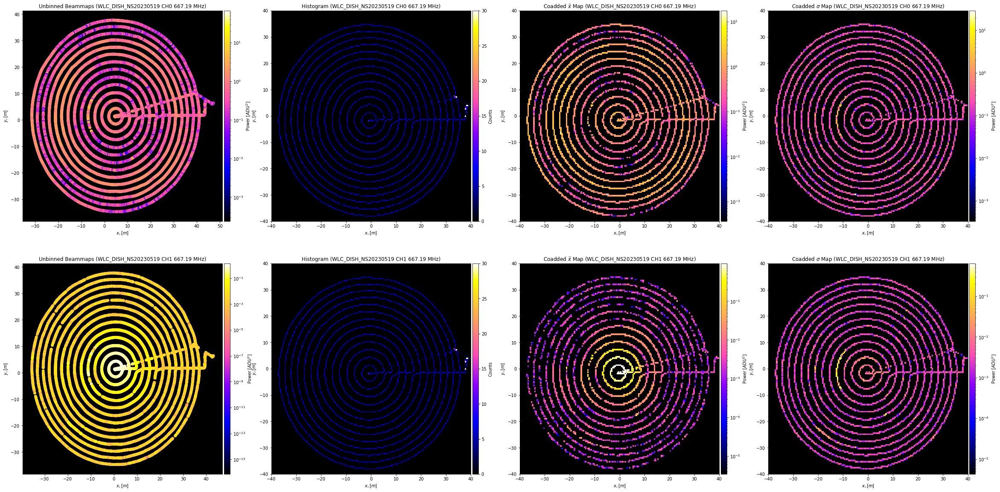

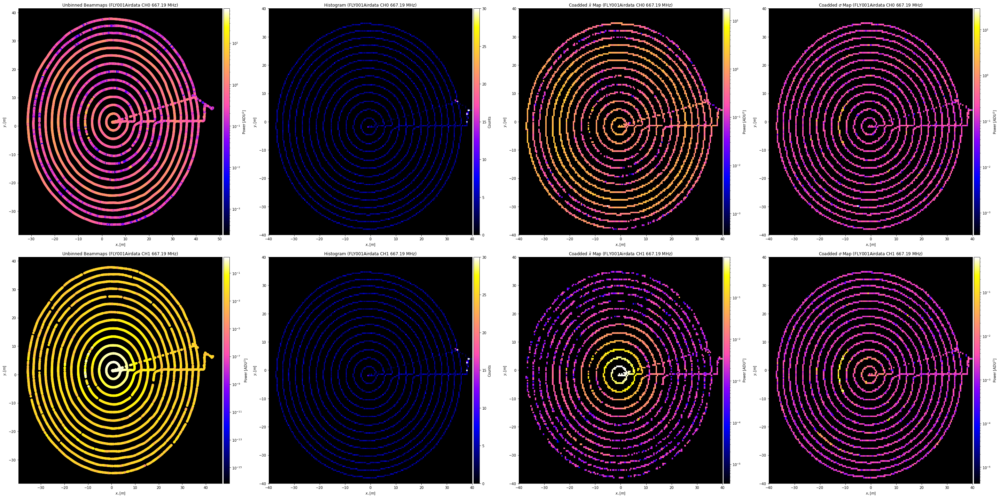

In [76]:
# Create the beammap class for FF Flight 1:

FFNSbeam=beammap.Beammap(concatlist=[pcklarr[0]],gfitlist=[gfitarr[0]],\
                         ## These parameters might be interesting to explore: [xmin,xmax,dx],[ymin,ymax,dy], frequency plotted
                         d0args=[-40,40,0.45],d1args=[-40,40,0.45],f_index_cc=340,\
                         normalization='Gauss',operation='coadd',
                         pickle_directory="/hirax/20240308_WLC_NFandFF/products/pickles/",\
                         gfit_directory="/hirax/20240308_WLC_NFandFF/products/gfits/",\
                         flightmasterpath="20240308_WLC_flights_forscripts.yaml",\
                         vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
# thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20240308_WLC_NFandFF/products/beam_pickles/",include_cross_data=True)
# print(thingy.tmppath)
# with open(thingy.tmppath, 'wb') as outp:
#     pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
# print('DONE')

In [6]:
## Call the interpolation function from the beammap class

FFNSbeam.complex_interpolation(d0_interp=FFNSbeam.d0_centers[:,0], d1_interp=FFNSbeam.d1_centers[:,0],method='cubic',variogram_model='spherical',outputs=False,Fargs=[340,340])

/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:1540: RuntimeWarning: invalid value encountered in remainder
  ddmod = mod(dd + pi, 2*pi) - pi


<ipython-input-106-784ad50f04f2>:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-106-784ad50f04f2>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-106-784ad50f04f2>:7: MatplotlibDeprecationWar

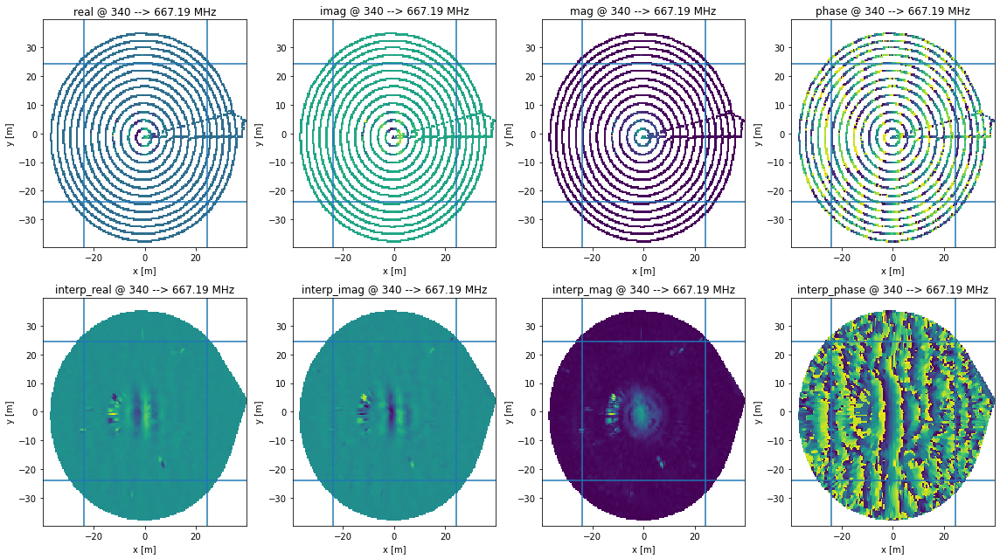

In [106]:
## plot the results of the interpolation and find where to cut to eliminate NAN values:

fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,9))
find=340
ax1.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.V_LC_cross.real[:,:,find,0,0])
ax2.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.V_LC_cross.imag[:,:,find,0,0])
ax3.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],np.abs(FFNSbeam.V_LC_cross)[:,:,find,0,0])#,norm=LogNorm())
ax4.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],np.angle(FFNSbeam.V_LC_cross)[:,:,find,0,0])

ax5.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.beam_linear_interp.real[:,:,find,0])
ax6.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.beam_linear_interp.imag[:,:,find,0])
ax7.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.beam_linear_interp_amp[:,:,find,0])#,norm=LogNorm())
ax8.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],FFNSbeam.beam_linear_interp_phase[:,:,find,0])

titles=['real','imag','mag','phase','interp_real','interp_imag','interp_mag','interp_phase']
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i]+' @ {} --> {:.2f} MHz'.format(find,FFNSbeam.freq[find]))
    ax.set_xlabel('x [m]')
    ax.set_ylabel('y [m]')
    ## Plot the lines where we will do the reassignment/dimension change
    ax.axvline(FFNSbeam.d0_centers_grid[35,0,0])
    ax.axhline(FFNSbeam.d1_centers_grid[0,35,0])
    ax.axvline(FFNSbeam.d0_centers_grid[-35,0,0])
    ax.axhline(FFNSbeam.d1_centers_grid[0,-35,0])
    
tight_layout()

In [107]:
## This is where we reassign the arrays to a restricted range (inside the lines above)--this is to remove NaNs before interpolating
## Careful not to run this twice, or things will start to break!

stop # comment this out after you've run it once
xmin,xmax,ymin,ymax=[35,-35,35,-35]
FFNSbeam.beam_linear_interp=FFNSbeam.beam_linear_interp[xmin:xmax,ymin:ymax]
FFNSbeam.beam_linear_interp_amp=FFNSbeam.beam_linear_interp_amp[xmin:xmax,ymin:ymax]
FFNSbeam.beam_linear_interp_phase=FFNSbeam.beam_linear_interp_phase[xmin:xmax,ymin:ymax]
FFNSbeam.beam_linear_interp_phase_unwrapped=FFNSbeam.beam_linear_interp_phase_unwrapped[xmin:xmax,ymin:ymax]
FFNSbeam.histogram_LC=FFNSbeam.histogram_LC[xmin:xmax,ymin:ymax]
FFNSbeam.V_LC_cross=FFNSbeam.V_LC_cross[xmin:xmax,ymin:ymax]
FFNSbeam.V_LC_mean=FFNSbeam.V_LC_mean[xmin:xmax,ymin:ymax]
FFNSbeam.V_LC_operation=FFNSbeam.V_LC_operation[xmin:xmax,ymin:ymax]
FFNSbeam.V_LC_std=FFNSbeam.V_LC_std[xmin:xmax,ymin:ymax]
FFNSbeam.d0_centers_grid=FFNSbeam.d0_centers_grid[xmin:xmax,ymin:ymax]
FFNSbeam.d0_edges_grid=FFNSbeam.d0_edges_grid[xmin:xmax,ymin:ymax]
FFNSbeam.d1_centers_grid=FFNSbeam.d1_centers_grid[xmin:xmax,ymin:ymax]
FFNSbeam.d1_edges_grid=FFNSbeam.d1_edges_grid[xmin:xmax,ymin:ymax]
    
FFNSbeam.d0_centers=FFNSbeam.d0_centers[xmin:xmax]
FFNSbeam.d0_edges=FFNSbeam.d0_edges[xmin:xmax]
FFNSbeam.d1_centers=FFNSbeam.d1_centers[ymin:ymax]
FFNSbeam.d1_edges=FFNSbeam.d1_edges[ymin:ymax]

### The cell here is the main part where we unwrap the phase

There's some more fitting and stuff further down, but this is the main part!

<ipython-input-113-53300398c4f0>:11: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
<ipython-input-113-53300398c4f0>:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1unwrap,cmap='gnuplot2')
<ipython-input-113-53300398c4f0>:13: MatplotlibDeprecationWarning: shading='flat

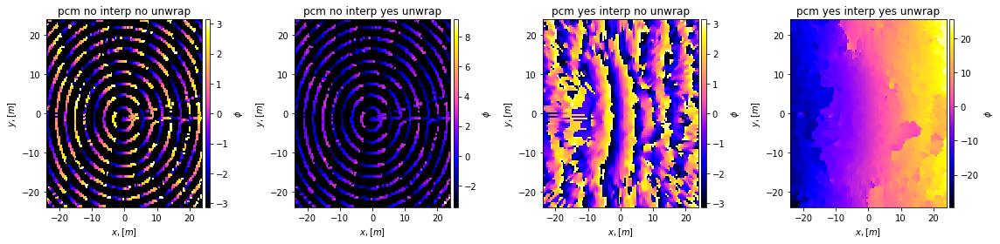

In [113]:
# Perform the phase unwrapping and plot the results, hopefully it appears as a gradient!
## pick a frequency by changing 'find', but be careful to change it in the other places it appears...

fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
find=331
phi1=np.angle(FFNSbeam.V_LC_cross[:,:,find,0,0])
phi1unwrap=unwrap2d(phi1)
phi_i=FFNSbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

im1=ax1.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2=ax2.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1unwrap,cmap='gnuplot2')
im3=ax3.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im4=ax4.pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2')
images=[im1,im2,im3,im4]
titles=["pcm no interp no unwrap","pcm no interp yes unwrap","pcm yes interp no unwrap","pcm yes interp yes unwrap"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
# for ax in [ax2,ax5,ax6]:
#     ax.plot(range(-20,20),range(-20,20),'r-',linewidth=10)
tight_layout()


(A,B,C)=(6.488050,0.501271,-0.000122)
G=0.000


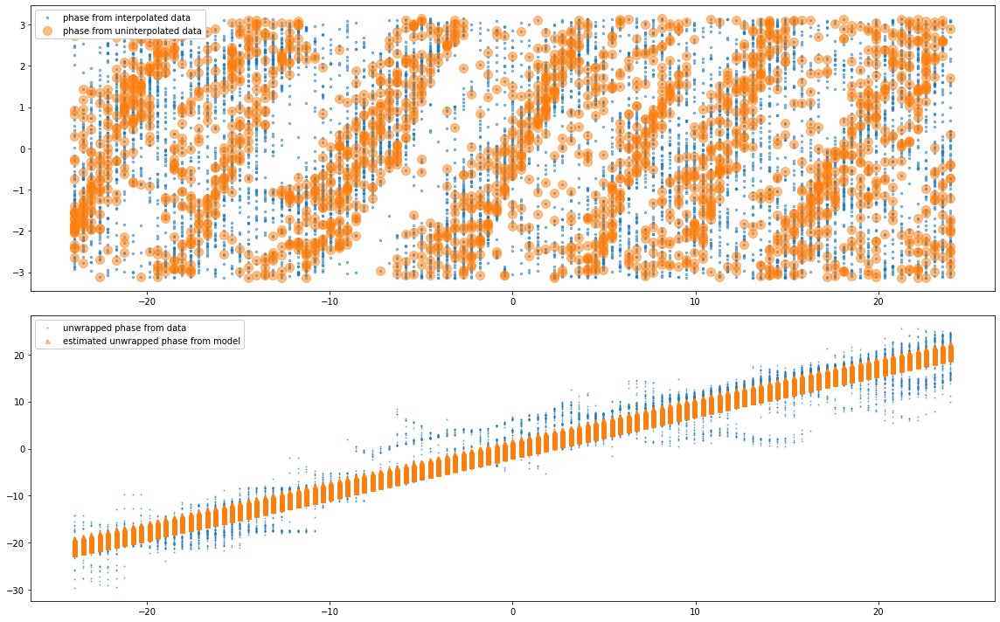

In [114]:
## Plot the wrapped and unwrapped phase, and see if a linear regression fits to the data... it should have a slope!

find=331

dx=FFNSbeam.d0_centers_grid[:,:,0]
dy=FFNSbeam.d1_centers_grid[:,:,0]
wl=(3.0e8/(FFNSbeam.freq[find]*1e6))
dc=(FFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcabs=np.abs(FFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()

phi1=np.angle(FFNSbeam.V_LC_cross[:,:,find,0,0])
phi1unwrap=unwrap2d(phi1)
phi_i=FFNSbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

dcang=phi_iunwrap.flatten()

dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(100*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))


def Fringe_Fit(P,dronepos,V,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi-V

def Fringe(P,dronepos,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi

popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
print("(A,B,C)=({:f},{:f},{:f})".format(popt[0],popt[1],popt[2]))
# print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(popt[3]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
ax1.plot(dcoords[:,0],phi_i.flatten(),'.',alpha=0.5,markersize=5,label='phase from interpolated data')
ax1.plot(dcoords[:,0],phi1.flatten(),'.',alpha=0.5,markersize=20,label='phase from uninterpolated data')
ax1.legend(loc=2,framealpha=1)
ax2.plot(dcoords[:,0],dcang,'.',alpha=0.5,markersize=2,label='unwrapped phase from data')
ax2.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'^',alpha=0.5,markersize=5,label='estimated unwrapped phase from model')
ax2.legend(loc=2,framealpha=1)
tight_layout()


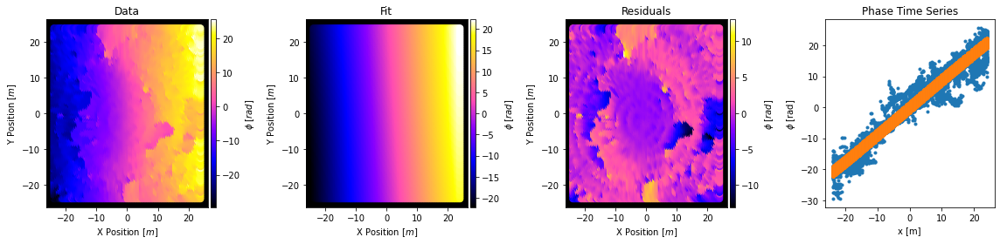

In [115]:
## Plot some stuff

fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im2=ax2.scatter(dx,dy,s=50,c=Fringe(popt,unitvects,wl),cmap='gnuplot2')
im3=ax3.scatter(dx,dy,s=50,c=(dcang-Fringe(popt,unitvects,wl)),cmap='gnuplot2')
ax4.plot(dcoords[:,0],dcang,'.')
ax4.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


<ipython-input-116-76aa03843eb7>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1 = ax[0].pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
<ipython-input-116-76aa03843eb7>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2 = ax[1].pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
<ipython-input-116-76aa03843eb7>:5: MatplotlibDeprecationWarning: shading='flat

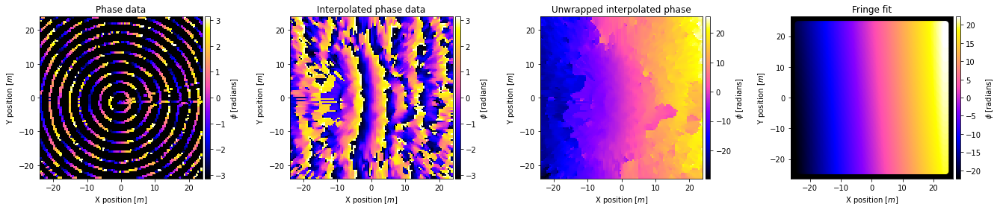

In [116]:
# plots for presentation
fig, ax = subplots(nrows=1,ncols=4, figsize=(23, 4))
im1 = ax[0].pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2 = ax[1].pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im3 = ax[2].pcolormesh(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2') # the unwrapped interped data
im4 = ax[3].scatter(dx,dy,s=50,c=Fringe(popt,unitvects,wl),cmap='gnuplot2') # the fringe fit
# possibly add the final phase after it's subtracted?

images=[im1,im2,im3,im4]
titles=['Phase data','Interpolated phase data','Unwrapped interpolated phase','Fringe fit']
for i, ax in enumerate(ax):
    ax.set_facecolor('k')
    ax.set_xlabel('X position $[m]$')
    ax.set_ylabel('Y position $[m]$')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right',size='3%',pad=0.05)
    cbar=fig.colorbar(images[i],cax=cax)
    cbar.set_label('$\phi$ [radians]')
    ax.set_title(titles[i])
    ax.set_aspect('equal')

In [117]:
## Fitting loop for the fringing formula?

dx=FFNSbeam.d0_centers_grid[:,:,0]
dy=FFNSbeam.d1_centers_grid[:,:,0]
dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(97*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))

## I think this loop breaks when np.NaN occurs in the phi_i stage of the loop... going to check testbeam.beam_linear_interp_phase[:,:,find,0] for nan for each find...
fringepopt=np.NaN*np.ones((140,4))
fringedata=np.NaN*np.ones((107,107,140))
for k,find in enumerate(range(250,390)):
    print("{},{}".format(k,find),end='\r')
    wl=(3.0e8/(FFNSbeam.freq[find]/1e-6))
    dc=(FFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
    dcabs=np.abs(FFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
    phi_i=FFNSbeam.beam_linear_interp_phase[:,:,find,0]
    if True in np.isnan(FFNSbeam.beam_linear_interp_phase[:,:,find,0]):
        print('true, breaking loop to skip index {}'.format(k))
    else:
        phi_iunwrap=unwrap2d(phi_i,wrap_args=(False,True))
        dcang=phi_iunwrap.flatten()
        fringedata[:,:,k]=phi_iunwrap
        popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
        fringepopt[k,:]=popt    

true, breaking loop to skip index 136
true, breaking loop to skip index 138
true, breaking loop to skip index 139


I wouldn't make the gif if I were you but you can do it if you want. I didn't change some variable names from earlier parts of the code, so anytime you see testbeam you should change it to FFNSbeam. 

MovieWriter ffmpeg unavailable; using Pillow instead.


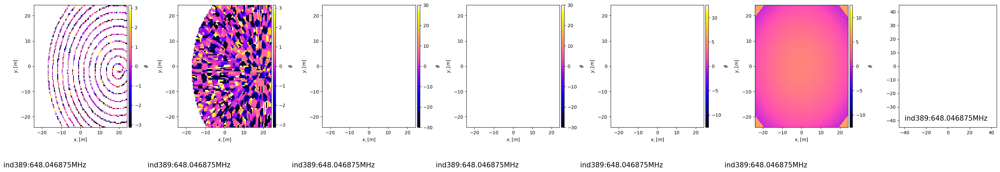

In [15]:
## Make the gif:
## can skip if annoying!

from matplotlib.animation import FuncAnimation
fig,[ax1,ax2,ax3,ax4,ax5,ax6,ax7]=subplots(nrows=1,ncols=7,figsize=(30,4.5))
cax1 = ax1.pcolormesh(dx, dy, np.angle(testbeam.V_LC_cross[:,:,250,0,0]), vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax2 = ax2.pcolormesh(dx, dy, testbeam.beam_linear_interp_phase[:,:,250,0], vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax3 = ax3.pcolormesh(dx, dy, fringedata[:,:,0], vmin=-30, vmax=30, cmap='gnuplot2')
cax4 = ax4.pcolormesh(dx, dy, Fringe(fringepopt[0,:],unitvects,wl).reshape(dx.shape), vmin=-30, vmax=30, cmap='gnuplot2')
cax5 = ax5.pcolormesh(dx, dy, fringedata[:,:,0]-Fringe(fringepopt[0,:],unitvects,wl).reshape(dx.shape), vmin=-4*np.pi, vmax=4*np.pi, cmap='gnuplot2')
cax6 = ax6.pcolormesh(dx, dy, (-2*(3e8/(testbeam.freq[250]*1e6))*np.sqrt((dx**2.0)+(dy**2.0)+(97.0**2.0)))%(2.0*np.pi), vmin=-4*np.pi, vmax=4*np.pi, cmap='gnuplot2')

images=[cax1,cax2,cax3,cax4,cax5,cax6]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$","$\phi$","$\phi$"]

for j,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6]):
    #ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
    
txt1=ax1.text(-40,-40, "", fontsize=15)
txt2=ax2.text(-40,-40, "", fontsize=15)
txt3=ax3.text(-40,-40, "", fontsize=15)
txt4=ax4.text(-40,-40, "", fontsize=15)
txt5=ax5.text(-40,-40, "", fontsize=15)
txt6=ax6.text(-40,-40, "", fontsize=15)
tight_layout()


def animate(vvv):
    cax1.set_array(np.angle(testbeam.V_LC_cross[:,:,250+vvv,0,0]))
    cax2.set_array(testbeam.beam_linear_interp_phase[:,:,250+vvv,0])
    cax3.set_array(fringedata[:,:,vvv])
    cax4.set_array(Fringe(fringepopt[vvv],unitvects,wl).reshape(dx.shape))
    cax5.set_array(fringedata[:,:,vvv]-Fringe(fringepopt[vvv],unitvects,wl).reshape(dx.shape))
    cax6.set_array((-2*(3e8/(testbeam.freq[vvv+250]*1e6))*np.sqrt((dx**2.0)+(dy**2.0)+(97.0**2.0)))%(2.0*np.pi))
    
    ax7.clear()
    ax7.plot(dcoords[:,0],fringedata[:,:,vvv].flatten(),'.')
    ax7.plot(dcoords[:,0],Fringe(np.array(fringepopt[vvv,:]),unitvects,(3.0e8/(testbeam.freq[vvv+250]/1e-6))).flatten(),'.')
    ax7.set_xlim(-45,45)
    ax7.set_ylim(-45,45)
    txt7=ax7.text(-40,-40, "", fontsize=15)
    
    txt1.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt2.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt3.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt4.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt5.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt6.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt7.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    print("{}".format(vvv),end='\r')

anim = FuncAnimation(fig, animate, interval=300, frames=140)
anim.save('../../Desktop/FFphase0308.gif')
show()

<ipython-input-14-33a01552558b>:19: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
<ipython-input-14-33a01552558b>:22: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')


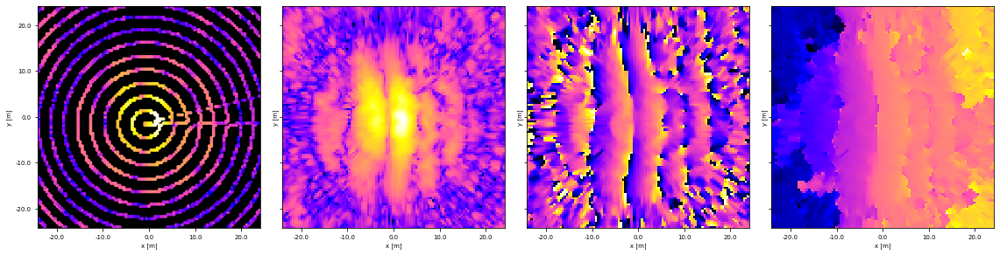

In [14]:
## This was where i was making plots for a presentation, nothing vital here!
# Will made these and it's just more plots of the phase
FFNSbeam.beam_linear_interp_phase_unwrapped.shape

fig,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4),sharex=True,sharey=True)
ax1.set_facecolor('k')
find=270
ax1.scatter(FFNSbeam.d0_centers_grid[:,:,0],FFNSbeam.d1_centers_grid[:,:,0],c=np.abs(FFNSbeam.V_LC_cross[:,:,find,0,0]),cmap='gnuplot2',s=8,norm=LogNorm())
#ax1.pcolormesh(testbeam.x_edges_grid[:,:,0],testbeam.y_edges_grid[:,:,0],(testbeam.V_LC_mean[:,:,find,0,0]),cmap='gnuplot2',norm=LogNorm())
ax2.pcolormesh(FFNSbeam.d0_edges_grid[:,:,0],FFNSbeam.d1_edges_grid[:,:,0],(FFNSbeam.beam_linear_interp_amp[:,:,find,0]),cmap='gnuplot2',norm=LogNorm())
ax1.set_xlim(ax2.get_xlim())
ax1.set_ylim(ax2.get_ylim())
ax3.pcolormesh(FFNSbeam.d0_edges_grid[:,:,0],FFNSbeam.d1_edges_grid[:,:,0],FFNSbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
ax4.pcolormesh(FFNSbeam.d0_edges_grid[:,:,0],FFNSbeam.d1_edges_grid[:,:,0],fringedata[:,:,find-250],cmap='gnuplot2')

for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    #ax.title(fontsize='x-small')
    ax.set_xlabel('x [m]',fontsize='x-small')
    ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
    #ax.set_xticks([])
    ax.set_ylabel('y [m]',fontsize='x-small')
    ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')
    #ax.set_yticks([])
    ax.set(aspect='equal')


tight_layout()


<ipython-input-118-b4da4836de8f>:14: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(dx, dy, fringedata[:,:,zez])
<ipython-input-118-b4da4836de8f>:15: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1].pcolormesh(dx, dy, Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape),cmap='gnuplot2')
<ipython-input-118-b4da4836de8f>:19: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Eith

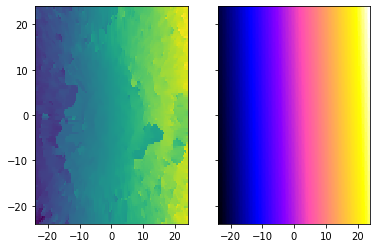

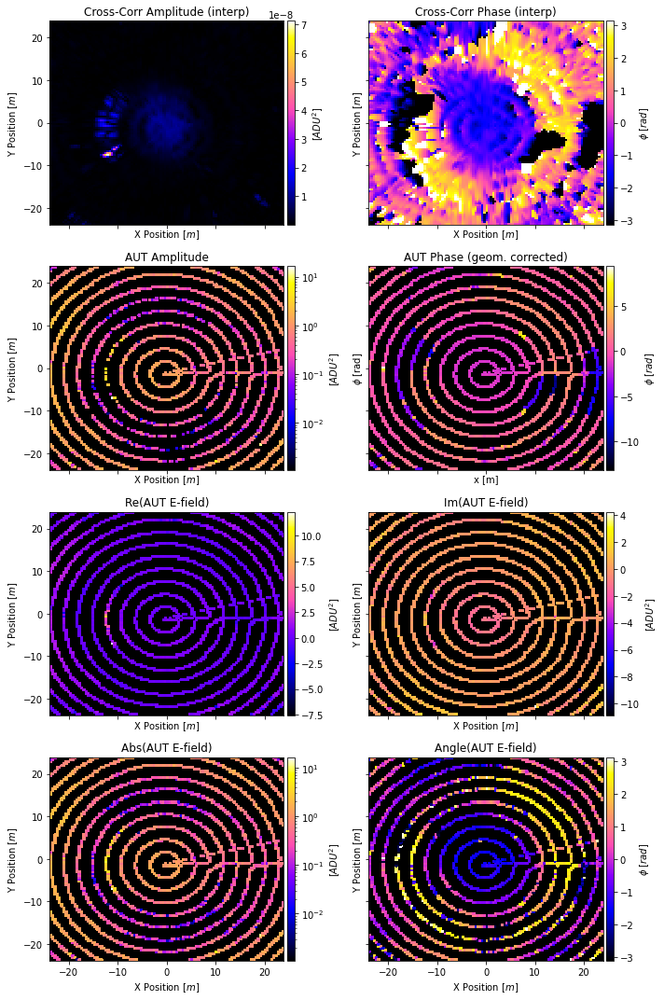

In [118]:
# here, we put the phase and the amplitude together into a complex electric field

find=331
wl=(3.0e10/(FFNSbeam.freq[find]/1e-6))
zez=find-250
# zez=0
ampl=FFNSbeam.V_LC_mean[:,:,250+zez,0,0]
nanmask=ampl/ampl
phase=fringedata[:,:,zez]-Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape)
phasefactor=np.e**(1.0j*phase)
cplxEfieldNSFF=ampl*phasefactor

fig,ax=subplots(nrows=1,ncols=2,sharex=True,sharey=True)
ax[0].pcolormesh(dx, dy, fringedata[:,:,zez])
ax[1].pcolormesh(dx, dy, Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape),cmap='gnuplot2')


fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)
im1=ax1.pcolormesh(dx, dy, FFNSbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
im2=ax2.pcolormesh(dx, dy, phase, cmap='gnuplot2',vmin=-np.pi, vmax=np.pi)
im3=ax3.pcolormesh(dx, dy, ampl, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dx, dy, nanmask*phase, cmap='gnuplot2')
im5=ax5.pcolormesh(dx, dy, np.real(cplxEfieldNSFF), cmap='gnuplot2')
im6=ax6.pcolormesh(dx, dy, np.imag(cplxEfieldNSFF), cmap='gnuplot2')
im7=ax7.pcolormesh(dx, dy, np.abs(cplxEfieldNSFF),cmap='gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dx, dy, np.angle(cplxEfieldNSFF), cmap='gnuplot2')

images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["Cross-Corr Amplitude (interp)","Cross-Corr Phase (interp)","AUT Amplitude","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


In [6]:
# NEARFIELD FLIGHT 1: 
#   NS Polarization
#   18m Altitude

# This altitude thing may be entirely wrong


All the steps here are basically the same, just for the NF, so it's not annotated as much.

In [7]:
## To prepare data for the NF2FF code, we need to determine the electric field in both polarizations:
## NF File 1: ch0=Bicolog, ch1=Telescope_Y_NSpol --> ## 'FLY781.csv' - Altitude ~18m, Yaw ~0deg --> NFNS18
## NF File 2: ch0=Telescope_X_EWpol, ch1=Bicolog
    ## 'FLY782.csv' - Altitude ~18m, Yaw ~90deg  --> NFEW18
    ## 'FLY783.csv' - Altitude ~20m, Yaw ~90deg  --> NFEW20   
    
print(pcklarr)


['FLY001Airdata_20240308T172037Z_ver_20240409T153507_concat.pkl'
 'FLY002Airdata_20240308T183549Z_ver_20240409T154916_concat.pkl'
 'FLY003Airdata_20240308T191730Z_ver_20240409T161221_concat.pkl'
 'FLY004Airdata_20240308T195926Z_ver_20240409T162601_concat.pkl']


start of concat loop is: 2025-01-09 15:40:05.727436


<ipython-input-2-28c1fcd841c4>:306: RuntimeWarning: divide by zero encountered in reciprocal
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
<ipython-input-2-28c1fcd841c4>:306: RuntimeWarning: invalid value encountered in multiply
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]


end of concat loop is: 2025-01-09 15:44:18.78622224,           


<ipython-input-2-28c1fcd841c4>:367: RuntimeWarning: Mean of empty slice
  self.V_LC_operation=np.nanmean(self.V_LC_mean,axis=4)


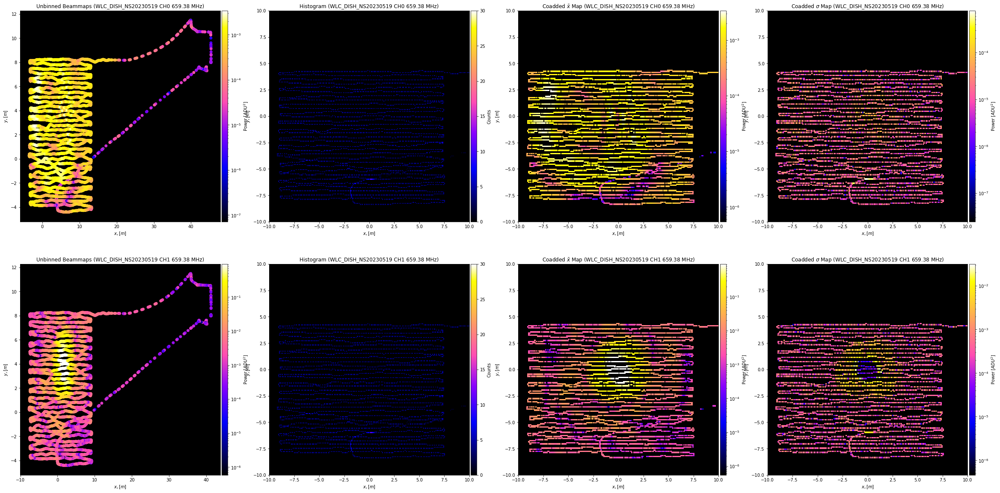

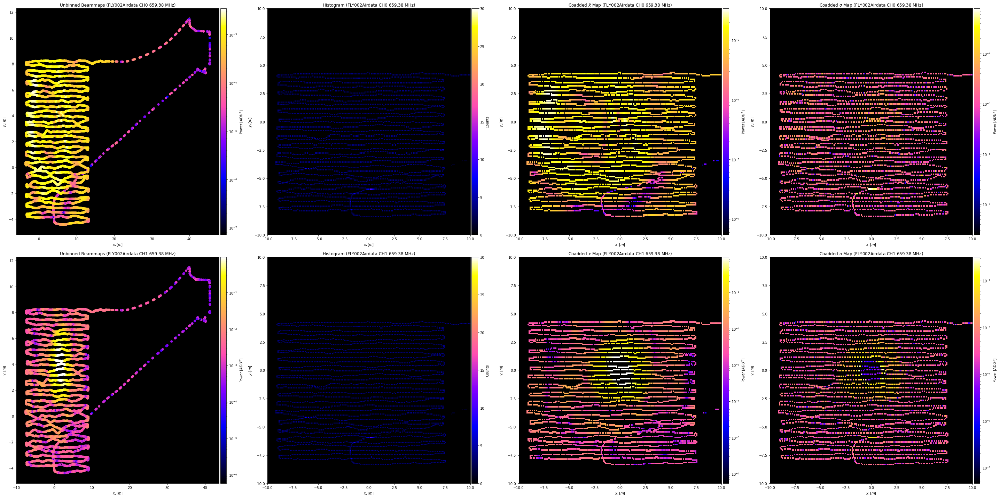

In [9]:
# Create the beammap class for NF Flight 1:

NFNSbeam=Beammap(concatlist=[pcklarr[1]],gfitlist=[gfitarr[1]],\
                         d0args=[-10,10,0.1],d1args=[-10,10,0.1],f_index_cc=360,\
                         normalization='Gauss',operation='coadd',
                         pickle_directory="/hirax/20240308_WLC_NFandFF/products/pickles/",\
                         gfit_directory="/hirax/20240308_WLC_NFandFF/products/gfits/",\
                         flightmasterpath="20240308_WLC_flights_forscripts.yaml",\
                         vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
# thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/beam_pickles/",include_cross_data=True)
# print(thingy.tmppath)
# with open(thingy.tmppath, 'wb') as outp:
#     pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
# print('DONE')

In [12]:
NFNSbeam.__dict__.keys()

dict_keys(['concat_list', 'gfit_list', 'ampcorr_list', 'FLYNUM', 'copoldir', 'name', 'Data_Directory', 'Gain_Directory', 'filenames', 'gainfile', 'Drone_Directory', 'FLYTAG', 'n_dishes', 'n_channels', 'n_concats', 'chmap', 'automap', 'crossmap', 'origin', 'dish_keystrings', 'dish_coords', 'dish_pointings', 'dish_polarizations', 'fmin', 'fmax', 'fstep', 'faxis', 'n_freqs', 'freq', 'operation', 'd0_edges', 'd1_edges', 'd0_edges_grid', 'd1_edges_grid', 'd0_centers', 'd1_centers', 'd0_centers_grid', 'd1_centers_grid', 'x_offsets', 'y_offsets', 'V_LC_mean', 'V_LC_std', 'histogram_LC', 'V_LC_cross', 'V_LC_operation'])

In [13]:
# loading the pickle file to get more information about the flight
picklename = "/hirax/20240308_WLC_NFandFF/products/pickles/FLY002Airdata_20240308T183549Z_ver_20240409T154916_concat.pkl"
with open(picklename, 'rb') as picklefile:
    concat_data = pickle.load(picklefile)

In [15]:
concat_data.__dict__.keys()

dict_keys(['name', 'chmap', 'automap', 'crossmap', 'Data_Directory', 'Gain_Directory', 'filenames', 'gainfile', 'Drone_Directory', 'FLYTAG', 'freq', 't_arr_datetime', 't', 't_delta_dji', 't_delta_pulse', 'n_dishes', 'n_channels', 'origin', 'dish_keystrings', 'dish_coords', 'dish_pointings', 'dish_polarizations', 'inds_off', 'inds_on', 'inds_span', 'pulse_dutycycle', 'pulse_period', 'switch_signal', 'switch_signal_interp', 'drone_xyz_LC_interp', 'drone_xyz_per_dish_interp', 'drone_yaw_interp', 'V_bgsub', 'G_popt', 'V_cross_bgsub', 'tmppath'])

In [17]:
concat_data.drone_xyz_LC_interp.shape

(50816, 3)

7.3101161607500655
12.310116160750066


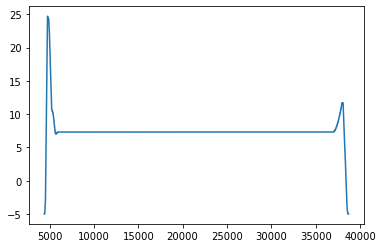

In [23]:
plot(concat_data.drone_xyz_LC_interp[:,2])
print(concat_data.drone_xyz_LC_interp[25000,2])
print(concat_data.drone_xyz_LC_interp[25000,2] - (-5))

(2, 50816, 3)


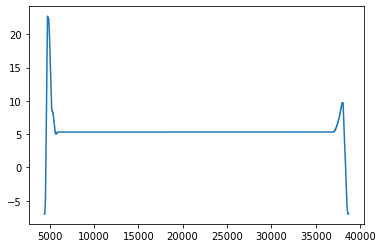

In [25]:
print(concat_data.drone_xyz_per_dish_interp.shape)
plot(concat_data.drone_xyz_per_dish_interp[0,:,2])

In [151]:
# reassigning method so we don't have to run beammap over and over
NFNSbeam.__class__ = Beammap

In [24]:
# make copies of the beammap class to test different interpolation schemes
# options for variogram model are 'linear', 'power', 'gaussian', 'spherical', 'exponential', 'hole-effect'
NFNSbeam_linear = deepcopy(NFNSbeam)
NFNSbeam_power = deepcopy(NFNSbeam)
NFNSbeam_gaussian = deepcopy(NFNSbeam)
NFNSbeam_spherical = deepcopy(NFNSbeam)
NFNSbeam_exponential = deepcopy(NFNSbeam)
NFNSbeam_holeeffect = deepcopy(NFNSbeam)

Starting linear


<ipython-input-117-a481daed76c6>:500: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(self.d0_centers_grid[:,:,chan_i],self.d1_centers_grid[:,:,chan_i],np.abs(V_LC_real[:,:,f_index,chan_i]+1j*V_LC_im[:,:,f_index,chan_i]),cmap=cm.gnuplot2,norm=LogNorm())
/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:1540: RuntimeWarning: invalid value encountered in remainder
  ddmod = mod(dd + pi, 2*pi) - pi
<ipython-input-117-a481daed76c6>:502: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.sh

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

/home/am3674/anaconda3/lib/python3.8/site-packages/matplotlib/colors.py:1210: RuntimeWarning: divide by zero encountered in log
  resdat -= np.log(vmin)
/home/am3674/anaconda3/lib/python3.8/site-packages/matplotlib/colors.py:1211: RuntimeWarning: divide by zero encountered in log
  resdat /= (np.log(vmax) - np.log(vmin))


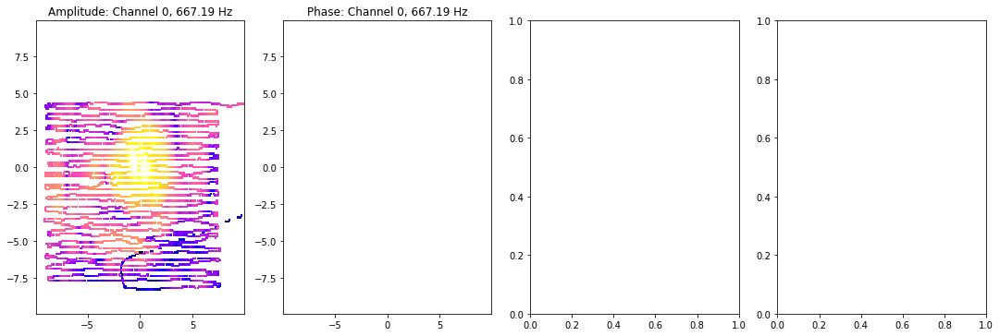

In [122]:
# interpolate using different krige methods--do not do this it takes forever
print("Starting linear")
NFNSbeam_linear.complex_interpolation(d0_interp=NFNSbeam_linear.d0_centers[:,0], d1_interp=NFNSbeam_linear.d1_centers[:,0],method='krig',variogram_model='linear',outputs=False,Fargs=[340,340])
print("Starting power")
NFNSbeam_power.complex_interpolation(d0_interp=NFNSbeam_power.d0_centers[:,0], d1_interp=NFNSbeam_power.d1_centers[:,0],method='krig',variogram_model='power',outputs=False,Fargs=[340,340])
print("starting Gaussian")
NFNSbeam_gaussian.complex_interpolation(d0_interp=NFNSbeam_gaussian.d0_centers[:,0], d1_interp=NFNSbeam_gaussian.d1_centers[:,0],method='krig',variogram_model='gaussian',outputs=False,Fargs=[340,340])
print("starting Spherical")
NFNSbeam_spherical.complex_interpolation(d0_interp=NFNSbeam_spherical.d0_centers[:,0], d1_interp=NFNSbeam_spherical.d1_centers[:,0],method='krig',variogram_model='spherical',outputs=False,Fargs=[340,340])
print("starting exponential")
NFNSbeam_exponential.complex_interpolation(d0_interp=NFNSbeam_exponential.d0_centers[:,0], d1_interp=NFNSbeam_exponential.d1_centers[:,0],method='krig',variogram_model='exponential',outputs=False,Fargs=[340,340])
print("starting hole effect")
NFNSbeam_holeeffect.complex_interpolation(d0_interp=NFNSbeam_holeeffect.d0_centers[:,0], d1_interp=NFNSbeam_holeeffect.d1_centers[:,0],method='krig',variogram_model='spherical',outputs=False,Fargs=[340,340])

In [80]:
# the normal interpolation
NFNSbeam.complex_interpolation(d0_interp=NFNSbeam.d0_centers[:,0], d1_interp=NFNSbeam.d1_centers[:,0],method='cubic',variogram_model='spherical',outputs=False,Fargs=[331,331])
# please tell me why 

/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:1540: RuntimeWarning: invalid value encountered in remainder
  ddmod = mod(dd + pi, 2*pi) - pi


In [14]:
NFNSbeam.Krig_Interp

AttributeError: 'Beammap' object has no attribute 'Krig_Interp'

In [26]:
NFNSbeam_linear.Krig_Interp

AttributeError: 'Beammap' object has no attribute 'Krig_Interp'

In [27]:
# trying my new function to interpolate only a couple frequencies--doing it for all frequencies to see how they look
NFNSbeam_exponential.krig_complex_interpolation([250,330,331], NFNSbeam_exponential.d0_centers[:,0], NFNSbeam_exponential.d1_centers[:,0], variogram_model='exponential')
NFNSbeam_linear.krig_complex_interpolation([250,330,331], NFNSbeam_linear.d0_centers[:,0], NFNSbeam_linear.d1_centers[:,0], variogram_model='linear')
NFNSbeam_power.krig_complex_interpolation([250,330,331], NFNSbeam_power.d0_centers[:,0], NFNSbeam_power.d1_centers[:,0], variogram_model='power')
NFNSbeam_spherical.krig_complex_interpolation([250,330,331], NFNSbeam_spherical.d0_centers[:,0], NFNSbeam_spherical.d1_centers[:,0], variogram_model='spherical')
NFNSbeam_gaussian.krig_complex_interpolation([250,330,331], NFNSbeam_gaussian.d0_centers[:,0], NFNSbeam_gaussian.d1_centers[:,0], variogram_model='gaussian')
NFNSbeam_holeeffect.krig_complex_interpolation([250,330,331], NFNSbeam_gaussian.d0_centers[:,0], NFNSbeam_gaussian.d1_centers[:,0], variogram_model='hole-effect')

Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331


<ipython-input-40-bd6944862568>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_amp[:,:,find,0],norm=LogNorm(), cmap='gnuplot2')
<ipython-input-40-bd6944862568>:8: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase[:,:,find,0],cmap='gnuplot2')
<ipython-input-40-bd6944862568>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y

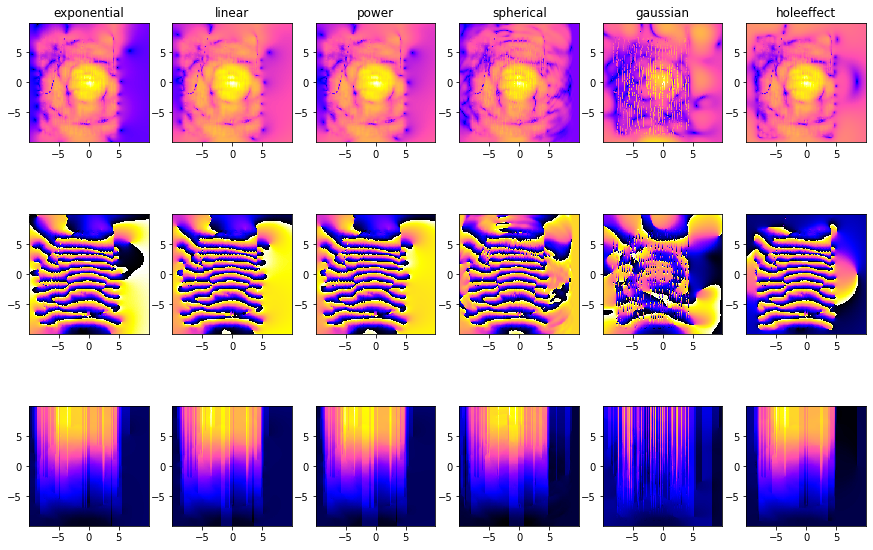

In [40]:
find=331
fig, ax = subplots(3, 6,figsize=(15,10))
beammaps = [NFNSbeam_exponential, NFNSbeam_linear, NFNSbeam_power, NFNSbeam_spherical, NFNSbeam_gaussian, NFNSbeam_holeeffect]
d0_interp = NFNSbeam.d0_centers_grid[:,:,0]
d1_interp = NFNSbeam.d1_centers_grid[:,:,0]
for i, beammap in enumerate(beammaps):
    ax[0][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_amp[:,:,find,0],norm=LogNorm(), cmap='gnuplot2')
    ax[1][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase[:,:,find,0],cmap='gnuplot2')
    ax[2][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase_unwrapped[:,:,find,0],cmap='gnuplot2')
    for i2 in range(3):
        ax[i2][i].set_aspect('equal')
titles = ['exponential','linear','power','spherical','gaussian','holeeffect']
for i, title in enumerate(titles):
    ax[0][i].set_title(title)

<ipython-input-49-ed46a0c6d54b>:2: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(d0_interp, d1_interp, NFNSbeam.beam_linear_interp_amp[:,:,find,0],norm=LogNorm(),cmap='gnuplot2')
<ipython-input-49-ed46a0c6d54b>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1].pcolormesh(d0_interp, d1_interp, NFNSbeam.beam_linear_interp_phase[:,:,find,0])
<ipython-input-49-ed46a0c6d54b>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have t

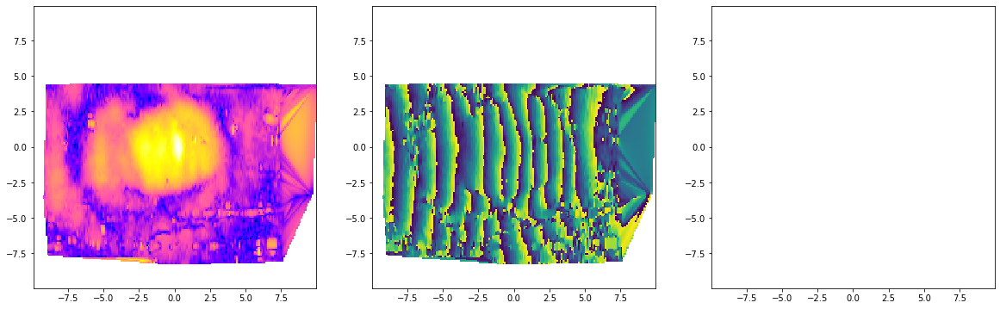

In [49]:
fig, ax = subplots(1,3,figsize=(20,20))
ax[0].pcolormesh(d0_interp, d1_interp, NFNSbeam.beam_linear_interp_amp[:,:,find,0],norm=LogNorm(),cmap='gnuplot2')
ax[1].pcolormesh(d0_interp, d1_interp, NFNSbeam.beam_linear_interp_phase[:,:,find,0])
ax[2].pcolormesh(d0_interp, d1_interp, NFNSbeam.beam_linear_interp_phase_unwrapped[:,:,find,0])
for i in range(3):
    ax[i].set_aspect('equal')

In [9]:
def plot_for_cutoff(beam, find, xargs, yargs, interpolation_method='linear'):
    
    '''
    xargs=[xmin,xmax]
    yargs=[ymin,ymax]
    '''
    
    fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,9))
    ax1.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.real[:,:,find,0,0])
    ax2.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.imag[:,:,find,0,0])
    ax3.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],np.abs(beam.V_LC_cross)[:,:,find,0,0])#,norm=LogNorm())
    ax4.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],np.angle(beam.V_LC_cross)[:,:,find,0,0])

    if interpolation_method=='linear':
        ax5.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.beam_linear_interp.real[:,:,find,0])
        ax6.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.beam_linear_interp.imag[:,:,find,0])
        ax7.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.beam_linear_interp_amp[:,:,find,0])#,norm=LogNorm())
        ax8.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.beam_linear_interp_phase[:,:,find,0])
    elif interpolation_method=='krig':
        ax5.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.Krig_Interp.real[:,:,find,0])
        ax6.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.Krig_Interp.imag[:,:,find,0])
        ax7.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.Krig_Interp_amp[:,:,find,0])#,norm=LogNorm())
        ax8.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.Krig_Interp_phase[:,:,find,0])

    titles=['real','imag','mag','phase','interp_real','interp_imag','interp_mag','interp_phase']
    for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
        ax.set_title(titles[i]+' @ {} --> {:.2f} MHz'.format(find,beam.freq[find]))
        ax.set_xlabel('x [m]')
        ax.set_ylabel('y [m]')
        ## Plot the lines where we will do the reassignment/dimension change
        ax.axvline(beam.d0_centers_grid[xargs[0],0,0])
        ax.axhline(beam.d1_centers_grid[0,yargs[0],0])
        ax.axvline(beam.d0_centers_grid[xargs[1],0,0])
        ax.axhline(beam.d1_centers_grid[0,yargs[1],0])
        ax.set_facecolor('k')

    tight_layout()

<ipython-input-62-ac975f7a5a19>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-62-ac975f7a5a19>:10: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-62-ac975f7a5a19>:11: MatplotlibDeprecationWarning: shading='flat' when

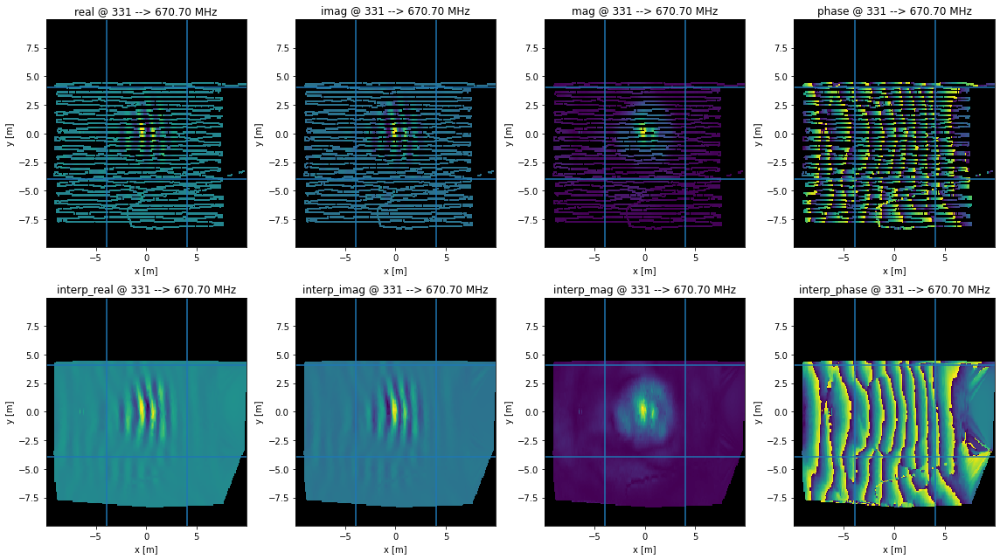

In [67]:
plot_for_cutoff(NFNSbeam,331,[60,-60],[60,-60])

<ipython-input-62-ac975f7a5a19>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-62-ac975f7a5a19>:10: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-62-ac975f7a5a19>:11: MatplotlibDeprecationWarning: shading='flat' when

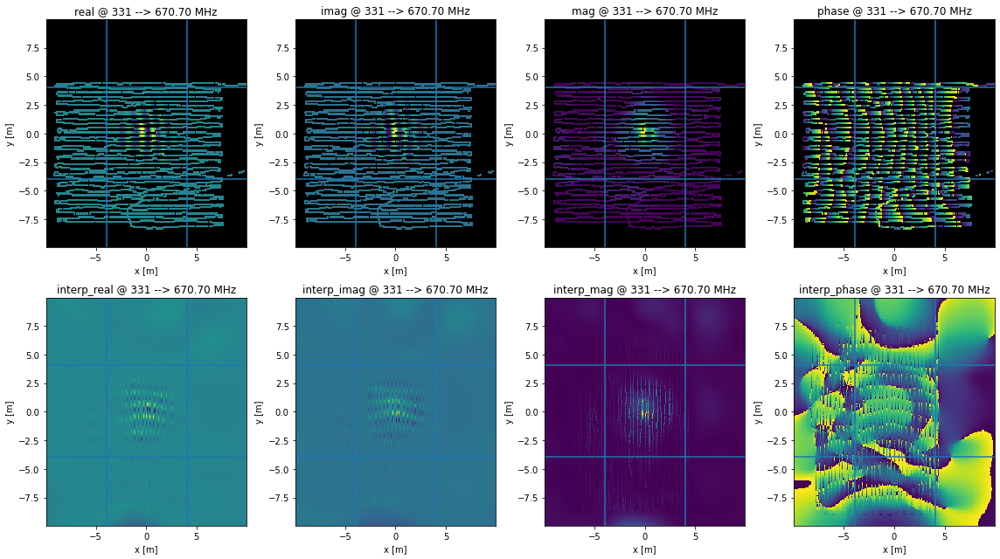

In [72]:
### plot krig results with cutoff
plot_for_cutoff(NFNSbeam_gaussian,331,[60,-60],[60,-60],interpolation_method='krig')

start of concat loop is: 2024-12-10 00:05:08.433205


<ipython-input-2-28c1fcd841c4>:306: RuntimeWarning: divide by zero encountered in reciprocal
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
<ipython-input-2-28c1fcd841c4>:306: RuntimeWarning: invalid value encountered in multiply
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]


end of concat loop is: 2024-12-10 00:08:26.52284524,           


<ipython-input-2-28c1fcd841c4>:367: RuntimeWarning: Mean of empty slice
  self.V_LC_operation=np.nanmean(self.V_LC_mean,axis=4)


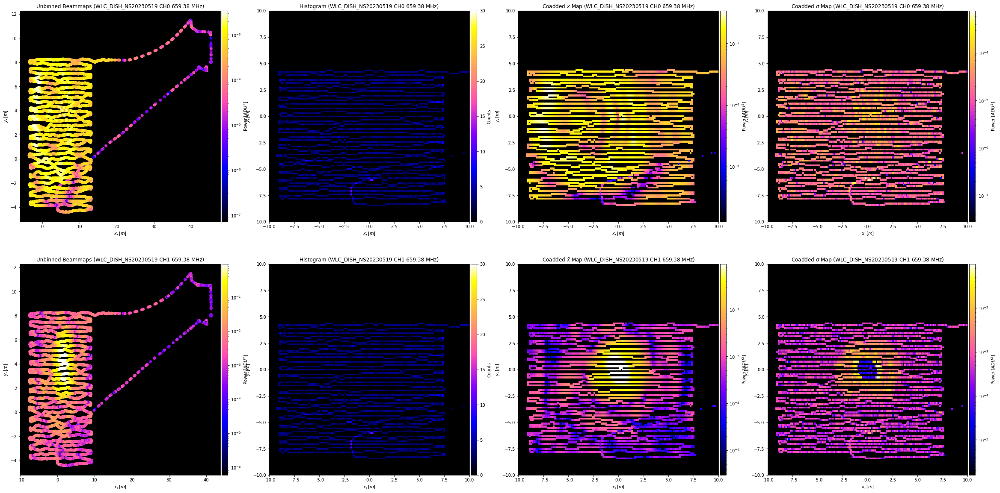

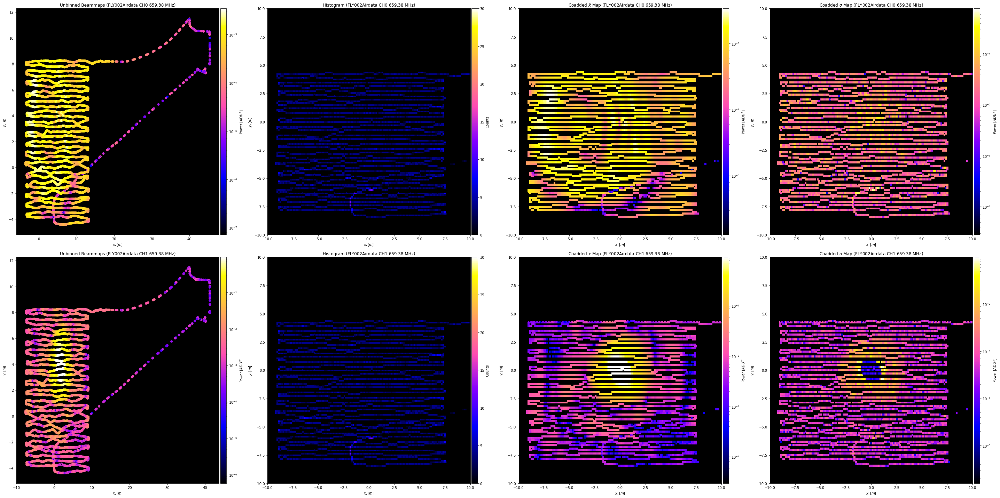

In [15]:
# this is the original, not the finer gridding!!
NFNSbeam=Beammap(concatlist=[pcklarr[1]],gfitlist=[gfitarr[1]],\
                         d0args=[-10,10,0.15],d1args=[-10,10,0.15],f_index_cc=360,\
                         normalization='Gauss',operation='coadd',
                         pickle_directory="/hirax/20240308_WLC_NFandFF/products/pickles/",\
                         gfit_directory="/hirax/20240308_WLC_NFandFF/products/gfits/",\
                         flightmasterpath="20240308_WLC_flights_forscripts.yaml",\
                         vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
# thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/beam_pickles/",include_cross_data=True)
# print(thingy.tmppath)
# with open(thingy.tmppath, 'wb') as outp:
#     pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
# print('DONE')

In [75]:
# make copies of the WIDE beammap class to test different interpolation schemes
# options for variogram model are 'linear', 'power', 'gaussian', 'spherical', 'exponential', 'hole-effect'
NFNSbeam_linear_wide = deepcopy(NFNSbeam_wide)
NFNSbeam_power_wide = deepcopy(NFNSbeam_wide)
NFNSbeam_gaussian_wide = deepcopy(NFNSbeam_wide)
NFNSbeam_spherical_wide = deepcopy(NFNSbeam_wide)
NFNSbeam_exponential_wide = deepcopy(NFNSbeam_wide)
NFNSbeam_holeeffect_wide = deepcopy(NFNSbeam_wide)

In [76]:
# trying my new function to interpolate only a couple frequencies--doing it for all frequencies to see how they look
NFNSbeam_exponential_wide.krig_complex_interpolation([250,330,331], NFNSbeam_exponential_wide.d0_centers[:,0], NFNSbeam_exponential_wide.d1_centers[:,0], variogram_model='exponential')
NFNSbeam_linear_wide.krig_complex_interpolation([250,330,331], NFNSbeam_linear_wide.d0_centers[:,0], NFNSbeam_linear_wide.d1_centers[:,0], variogram_model='linear')
NFNSbeam_power_wide.krig_complex_interpolation([250,330,331], NFNSbeam_power_wide.d0_centers[:,0], NFNSbeam_power_wide.d1_centers[:,0], variogram_model='power')

Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 331
Starting freq index: 250
Starting freq index: 330
Starting freq index: 330
Starting freq index: 331


In [77]:
NFNSbeam_spherical_wide.krig_complex_interpolation([250,330,331], NFNSbeam_spherical_wide.d0_centers[:,0], NFNSbeam_spherical_wide.d1_centers[:,0], variogram_model='spherical')
NFNSbeam_gaussian_wide.krig_complex_interpolation([250,330,331], NFNSbeam_gaussian_wide.d0_centers[:,0], NFNSbeam_gaussian_wide.d1_centers[:,0], variogram_model='gaussian')
NFNSbeam_holeeffect_wide.krig_complex_interpolation([250,330,331], NFNSbeam_gaussian_wide.d0_centers[:,0], NFNSbeam_gaussian_wide.d1_centers[:,0], variogram_model='hole-effect')

Krig interpolation already performed
Frequency 250 has already been interpolated
Frequency 330 has already been interpolated
Frequency 331 has already been interpolated
Krig interpolation already performed
Frequency 250 has already been interpolated
Frequency 330 has already been interpolated
Frequency 331 has already been interpolated
Krig interpolation already performed
Frequency 250 has already been interpolated
Frequency 330 has already been interpolated
Frequency 331 has already been interpolated


<ipython-input-78-8b1aa0b842ed>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_amp[:,:,find,0],norm=LogNorm(), cmap='gnuplot2')
<ipython-input-78-8b1aa0b842ed>:8: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase[:,:,find,0],cmap='gnuplot2')
<ipython-input-78-8b1aa0b842ed>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y

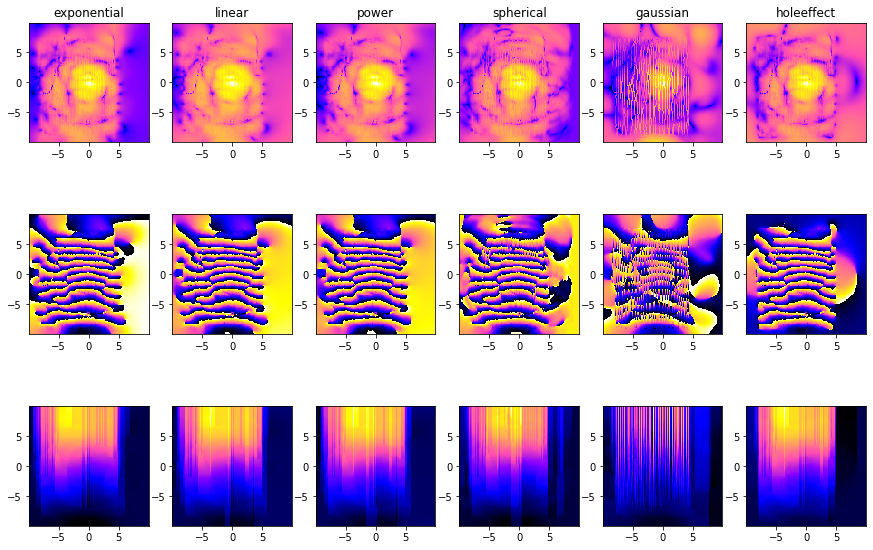

In [78]:
find=331
fig, ax = subplots(3, 6,figsize=(15,10))
beammaps = [NFNSbeam_exponential_wide, NFNSbeam_linear_wide, NFNSbeam_power_wide, NFNSbeam_spherical_wide, NFNSbeam_gaussian_wide, NFNSbeam_holeeffect_wide]
d0_interp = NFNSbeam_wide.d0_centers_grid[:,:,0]
d1_interp = NFNSbeam_wide.d1_centers_grid[:,:,0]
for i, beammap in enumerate(beammaps):
    ax[0][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_amp[:,:,find,0],norm=LogNorm(), cmap='gnuplot2')
    ax[1][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase[:,:,find,0],cmap='gnuplot2')
    ax[2][i].pcolormesh(d0_interp, d1_interp, beammap.Krig_Interp_phase_unwrapped[:,:,find,0],cmap='gnuplot2')
    for i2 in range(3):
        ax[i2][i].set_aspect('equal')
titles = ['exponential','linear','power','spherical','gaussian','holeeffect']
for i, title in enumerate(titles):
    ax[0][i].set_title(title)

In [9]:
NFNSbeam.beam_linear_interp_amp.shape

(200, 200, 1024, 1)

In [86]:
# NFNSbeam = deepcopy(NFNSbeam_wide)

In [16]:
NFNSbeam.complex_interpolation(d0_interp=NFNSbeam.d0_centers[:,0], d1_interp=NFNSbeam.d1_centers[:,0],method='cubic',variogram_model='spherical',outputs=False,Fargs=[331,331])

<ipython-input-9-ac975f7a5a19>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-9-ac975f7a5a19>:10: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(beam.d0_centers_grid[:,:,0],beam.d1_centers_grid[:,:,0],beam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-9-ac975f7a5a19>:11: MatplotlibDeprecationWarning: shading='flat' when X 

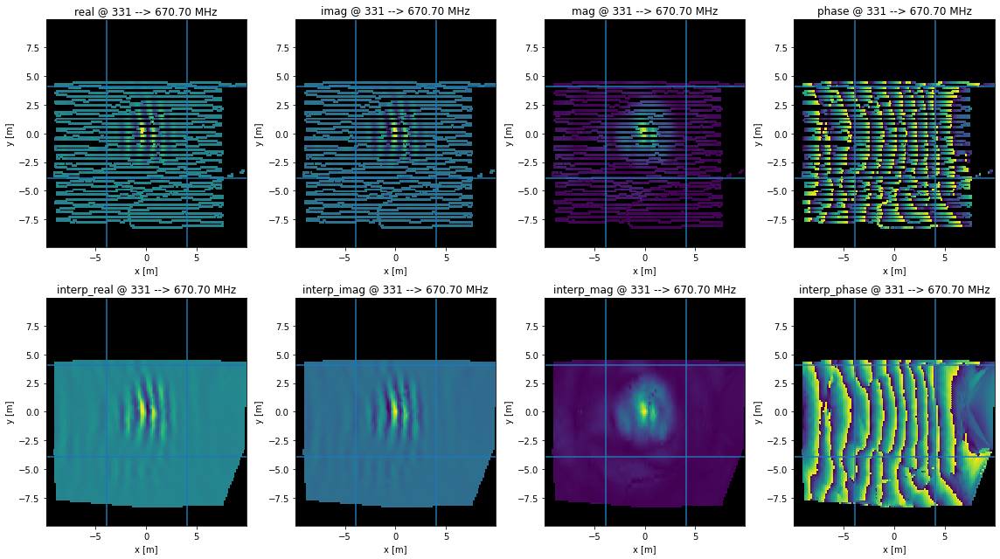

In [17]:
plot_for_cutoff(NFNSbeam,331,[40,-40],[40,-40])

In [18]:
stop
xmin,xmax,ymin,ymax=[40,-40,40,-40]
NFNSbeam.beam_linear_interp=NFNSbeam.beam_linear_interp[xmin:xmax,ymin:ymax]
NFNSbeam.beam_linear_interp_amp=NFNSbeam.beam_linear_interp_amp[xmin:xmax,ymin:ymax]
NFNSbeam.beam_linear_interp_phase=NFNSbeam.beam_linear_interp_phase[xmin:xmax,ymin:ymax]
NFNSbeam.beam_linear_interp_phase_unwrapped=NFNSbeam.beam_linear_interp_phase_unwrapped[xmin:xmax,ymin:ymax]
NFNSbeam.histogram_LC=NFNSbeam.histogram_LC[xmin:xmax,ymin:ymax]
NFNSbeam.V_LC_cross=NFNSbeam.V_LC_cross[xmin:xmax,ymin:ymax]
NFNSbeam.V_LC_mean=NFNSbeam.V_LC_mean[xmin:xmax,ymin:ymax]
NFNSbeam.V_LC_operation=NFNSbeam.V_LC_operation[xmin:xmax,ymin:ymax]
NFNSbeam.V_LC_std=NFNSbeam.V_LC_std[xmin:xmax,ymin:ymax]
NFNSbeam.d0_centers_grid=NFNSbeam.d0_centers_grid[xmin:xmax,ymin:ymax]
NFNSbeam.d0_edges_grid=NFNSbeam.d0_edges_grid[xmin:xmax,ymin:ymax]
NFNSbeam.d1_centers_grid=NFNSbeam.d1_centers_grid[xmin:xmax,ymin:ymax]
NFNSbeam.d1_edges_grid=NFNSbeam.d1_edges_grid[xmin:xmax,ymin:ymax]
    
    
NFNSbeam.d0_centers=NFNSbeam.d0_centers[xmin:xmax]
NFNSbeam.d0_edges=NFNSbeam.d0_edges[xmin:xmax]
NFNSbeam.d1_centers=NFNSbeam.d1_centers[ymin:ymax]
NFNSbeam.d1_edges=NFNSbeam.d1_edges[ymin:ymax]

In [90]:
NFNSbeam.beam_linear_interp_amp.shape

(13, 13, 1024, 1)

<ipython-input-53-8a0c25f6a7ec>:8: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi1NS,cmap='gnuplot2')
<ipython-input-53-8a0c25f6a7ec>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phiunwrapNS,cmap='gnuplot2')
<ipython-input-53-8a0c25f6a7ec>:10: MatplotlibDeprecationWarning: shading='flat' 

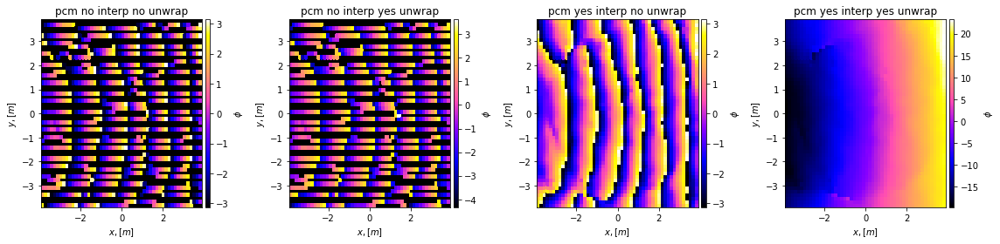

In [53]:
fig,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
find=331
phi1NS=np.angle(NFNSbeam.V_LC_cross[:,:,find,0,0])
phiunwrapNS=unwrap2d(phi1NS,wrap_args=(False,True))
phi_iNS=NFNSbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrapNS=unwrap2d(phi_iNS,wrap_args=(False,True))

im1=ax1.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi1NS,cmap='gnuplot2')
im2=ax2.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phiunwrapNS,cmap='gnuplot2')
im3=ax3.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi_iNS,cmap='gnuplot2')
im4=ax4.pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi_iunwrapNS,cmap='gnuplot2')
images=[im1,im2,im3,im4]
titles=["pcm no interp no unwrap","pcm no interp yes unwrap","pcm yes interp no unwrap","pcm yes interp yes unwrap"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
# for ax in [ax2,ax5,ax6]:
#     ax.plot(range(-20,20),range(-20,20),'r-',linewidth=10)
tight_layout()


(A,B,C)=(36.364338,1.973444,0.000035)
G=0.000


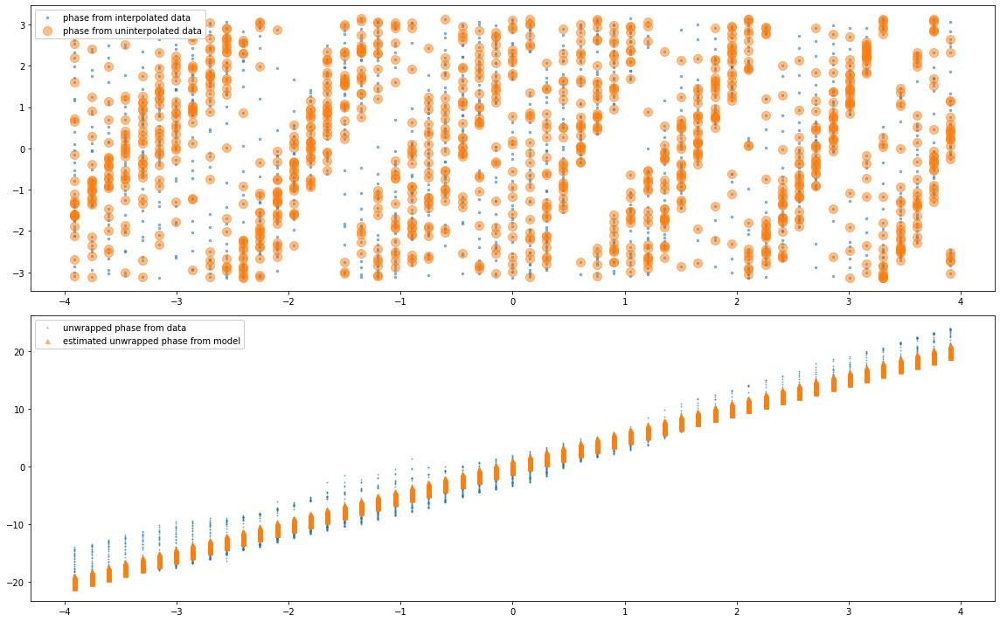

In [54]:
find=331
dxNS=NFNSbeam.d0_centers_grid[:,:,0]
dyNS=NFNSbeam.d1_centers_grid[:,:,0]
wlNS=(3.0e8/(NFNSbeam.freq[find]*1e6)) # keep this in m if you don't want everything to break!!
dcNS=(NFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcabsNS=np.abs(NFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()

phi1NS=np.angle(NFNSbeam.V_LC_cross[:,:,find,0,0])
phi1unwrapNS=unwrap2d(phi1NS)
phi_iNS=NFNSbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrapNS=unwrap2d(phi_iNS)

dcangNS=phi_iunwrapNS.flatten()

dcoordsNS=np.zeros((dxNS.shape[0]*dxNS.shape[1],3))
dcoordsNS[:,0]=dxNS.flatten()
dcoordsNS[:,1]=dyNS.flatten()
dcoordsNS[:,2]=(100*np.ones((dxNS.shape[0]*dxNS.shape[1]))).flatten()
unitvectsNS=dcoordsNS*np.outer(np.nansum((dcoordsNS)**2.0,axis=1)**-0.5,np.ones(3))


def Fringe_Fit(P,dronepos,V,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi-V

def Fringe(P,dronepos,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi

poptNS=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvectsNS[~np.isnan(dcangNS)],dcangNS[~np.isnan(dcangNS)],wlNS]).x
print("(A,B,C)=({:f},{:f},{:f})".format(poptNS[0],poptNS[1],poptNS[2]))
# print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(poptNS[3]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
ax1.plot(dcoordsNS[:,0],phi_iNS.flatten(),'.',alpha=0.5,markersize=5,label='phase from interpolated data')
ax1.plot(dcoordsNS[:,0],phi1NS.flatten(),'.',alpha=0.5,markersize=20,label='phase from uninterpolated data')
ax1.legend(loc=2,framealpha=1)
ax2.plot(dcoordsNS[:,0],dcangNS,'.',alpha=0.5,markersize=2,label='unwrapped phase from data')
ax2.plot(dcoordsNS[:,0],Fringe(np.array(poptNS),unitvectsNS,wlNS),'^',alpha=0.5,markersize=5,label='estimated unwrapped phase from model')
ax2.legend(loc=2,framealpha=1)
tight_layout()

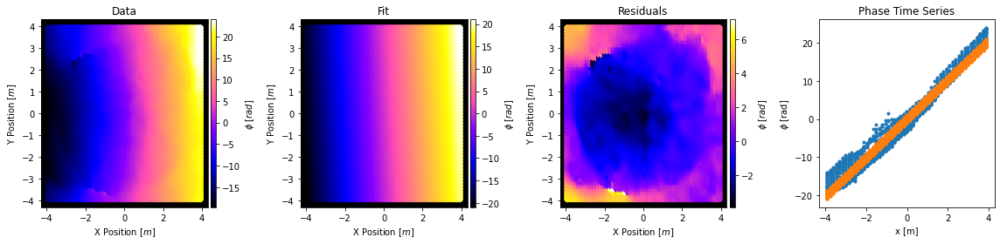

In [55]:
## Plot some stuff

fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dxNS,dyNS,s=50,c=dcangNS,cmap='gnuplot2')
im2=ax2.scatter(dxNS,dyNS,s=50,c=Fringe(poptNS,unitvectsNS,wlNS),cmap='gnuplot2')
im3=ax3.scatter(dxNS,dyNS,s=50,c=(dcangNS-Fringe(poptNS,unitvectsNS,wlNS)),cmap='gnuplot2')
ax4.plot(dcoordsNS[:,0],dcangNS,'.')
ax4.plot(dcoordsNS[:,0],Fringe(np.array(poptNS),unitvectsNS,wlNS),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


In [56]:
## Fitting loop for the fringing formula?

#stop

dxNS=NFNSbeam.d0_centers_grid[:,:,0]
dyNS=NFNSbeam.d1_centers_grid[:,:,0]
dcoordsNS=np.zeros((dxNS.shape[0]*dxNS.shape[1],3))
dcoordsNS[:,0]=dxNS.flatten()
dcoordsNS[:,1]=dyNS.flatten()
dcoordsNS[:,2]=(97*np.ones((dxNS.shape[0]*dxNS.shape[1]))).flatten()
unitvectsNS=dcoordsNS*np.outer(np.nansum((dcoordsNS)**2.0,axis=1)**-0.5,np.ones(3))

## I think this loop breaks when np.NaN occurs in the phi_i stage of the loop... going to check testbeam.beam_linear_interp_phase[:,:,find,0] for nan for each find...
fringepoptNS=np.NaN*np.ones((140,4))
fringedataNS=np.NaN*np.ones((NFNSbeam.V_LC_cross.shape[0],NFNSbeam.V_LC_cross.shape[1],140))
for k,find in enumerate(range(250,390)):
    print("{},{}".format(k,find),end='\r')
    wlNS=(3.0e8/(NFNSbeam.freq[find]/1e-6))
    dcNS=(NFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
    dcabsNS=np.abs(NFNSbeam.V_LC_cross[:,:,find,0,0]).flatten()
    phi_iNS=NFNSbeam.beam_linear_interp_phase[:,:,find,0]
    if True in np.isnan(NFNSbeam.beam_linear_interp_phase[:,:,find,0]):
        print('true, breaking loop to skip index {}'.format(k))
    else:
        phi_iunwrapNS=unwrap2d(phi_iNS,wrap_args=(False,True))
        dcangNS=phi_iunwrapNS.flatten()
        fringedataNS[:,:,k]=phi_iunwrapNS
        poptNS=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvectsNS[~np.isnan(dcangNS)],dcangNS[~np.isnan(dcangNS)],wlNS]).x
        fringepoptNS[k,:]=poptNS

true, breaking loop to skip index 58
true, breaking loop to skip index 72
true, breaking loop to skip index 74
true, breaking loop to skip index 75


NameError: name 'dx' is not defined

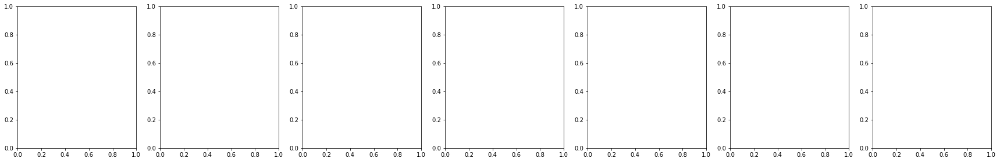

In [57]:
## Make the gif:
## can skip if annoying!

from matplotlib.animation import FuncAnimation
fig,[ax1,ax2,ax3,ax4,ax5,ax6,ax7]=subplots(nrows=1,ncols=7,figsize=(30,4.5))
cax1 = ax1.pcolormesh(dx, dy, np.angle(testbeam.V_LC_cross[:,:,250,0,0]), vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax2 = ax2.pcolormesh(dx, dy, testbeam.beam_linear_interp_phase[:,:,250,0], vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax3 = ax3.pcolormesh(dx, dy, fringedata[:,:,0], vmin=-30, vmax=30, cmap='gnuplot2')
cax4 = ax4.pcolormesh(dx, dy, Fringe(fringepopt[0,:],unitvects,wl).reshape(dx.shape), vmin=-30, vmax=30, cmap='gnuplot2')
cax5 = ax5.pcolormesh(dx, dy, fringedata[:,:,0]-Fringe(fringepopt[0,:],unitvects,wl).reshape(dx.shape), vmin=-4*np.pi, vmax=4*np.pi, cmap='gnuplot2')
cax6 = ax6.pcolormesh(dx, dy, (-2*(3e8/(testbeam.freq[250]*1e6))*np.sqrt((dx**2.0)+(dy**2.0)+(97.0**2.0)))%(2.0*np.pi), vmin=-4*np.pi, vmax=4*np.pi, cmap='gnuplot2')

images=[cax1,cax2,cax3,cax4,cax5,cax6]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$","$\phi$","$\phi$"]

for j,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6]):
    #ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
    
txt1=ax1.text(-5,-5, "", fontsize=15)
txt2=ax2.text(-5,-5, "", fontsize=15)
txt3=ax3.text(-5,-5, "", fontsize=15)
txt4=ax4.text(-5,-5, "", fontsize=15)
txt5=ax5.text(-5,-5, "", fontsize=15)
txt6=ax6.text(-5,-5, "", fontsize=15)
tight_layout()


def animate(vvv):
    cax1.set_array(np.angle(testbeam.V_LC_cross[:,:,250+vvv,0,0]))
    cax2.set_array(testbeam.beam_linear_interp_phase[:,:,250+vvv,0])
    cax3.set_array(fringedata[:,:,vvv])
    cax4.set_array(Fringe(fringepopt[vvv],unitvects,wl).reshape(dx.shape))
    cax5.set_array(fringedata[:,:,vvv]-Fringe(fringepopt[vvv],unitvects,wl).reshape(dx.shape))
    cax6.set_array((-2*(3e8/(testbeam.freq[vvv+250]*1e6))*np.sqrt((dx**2.0)+(dy**2.0)+(97.0**2.0)))%(2.0*np.pi))
    
    ax7.clear()
    ax7.plot(dcoords[:,0],fringedata[:,:,vvv].flatten(),'.')
    ax7.plot(dcoords[:,0],Fringe(np.array(fringepopt[vvv,:]),unitvects,(3.0e8/(testbeam.freq[vvv+250]/1e-6))).flatten(),'.')
    ax7.set_xlim(-7,7)
    ax7.set_ylim(-30,30)
    txt7=ax7.text(-5,-5, "", fontsize=15)
    
    txt1.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt2.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt3.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt4.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt5.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt6.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt7.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    print("{}".format(vvv),end='\r')

anim = FuncAnimation(fig, animate, interval=300, frames=140)
anim.save('../../Desktop/NFphase0308.gif')
show()

<ipython-input-58-732d3ebede90>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
<ipython-input-58-732d3ebede90>:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')


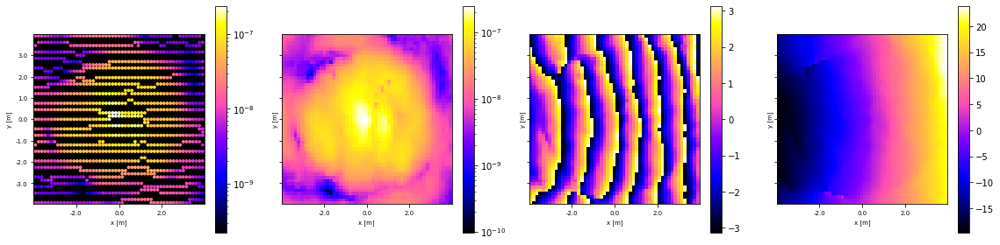

In [58]:
NFNSbeam.beam_linear_interp_phase_unwrapped.shape

fig,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4),sharex=True,sharey=True)
ax1.set_facecolor('k')
find=331
pcm1=ax1.scatter(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],c=np.abs(NFNSbeam.V_LC_cross[:,:,find,0,0]),cmap='gnuplot2',s=8,norm=LogNorm())
#ax1.pcolormesh(testbeam.x_edges_grid[:,:,0],testbeam.y_edges_grid[:,:,0],(testbeam.V_LC_mean[:,:,find,0,0]),cmap='gnuplot2',norm=LogNorm())
pcm2=ax2.pcolormesh(NFNSbeam.d0_edges_grid[:,:,0],NFNSbeam.d1_edges_grid[:,:,0],(NFNSbeam.beam_linear_interp_amp[:,:,find,0]),cmap='gnuplot2',norm=LogNorm())
ax1.set_xlim(ax2.get_xlim())
ax1.set_ylim(ax2.get_ylim())
pcm3=ax3.pcolormesh(NFNSbeam.d0_edges_grid[:,:,0],NFNSbeam.d1_edges_grid[:,:,0],NFNSbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
pcm4=ax4.pcolormesh(NFNSbeam.d0_edges_grid[:,:,0],NFNSbeam.d1_edges_grid[:,:,0],fringedataNS[:,:,find-250],cmap='gnuplot2')
pcms=[pcm1,pcm2,pcm3,pcm4]

for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    #ax.title(fontsize='x-small')
    ax.set_xlabel('x [m]',fontsize='x-small')
    ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
    #ax.set_xticks([])
    ax.set_ylabel('y [m]',fontsize='x-small')
    ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')
    #ax.set_yticks([])
    ax.set(aspect='equal')
    colorbar(mappable=pcms[i],ax=ax)


tight_layout()


In [59]:
##  NF2FF Instructions
##  1. Preparation and Preliminary Measurements
##  2. Design a Flightpath optimized for NF Sampling 
##  3. Execute testflights and collect data
##  4. Analyze data using the Drone, Corr, and Concat Classes
##  5. Produce yaml, gfit, and pickle files of reduced data
##  6. Initialize the beammap class for each flight using the 0x1 (cross) data
##  7. Interpolate beammap data so that every cell contains data
##  8. Trim the interpolated beammap so that no nans are present
##  9. Execute the unwrap function on the interpolated data to unwrap the phase
## 10. Perform fit on the wrapped/unwrapped phase measurements
## 11. Subtract best-fit geometric phase from the unwrapped phase to obtain residual AUT phase
## 12. Reconstruct E-Field from AUT by complexifying the sqrt(auto=0x0) with the residual AUT phase

find=331
wlNS=(3.0e10/(NFNSbeam.freq[find]/1e-6)) # this is in cm!!
zez=find-250
amplNS=NFNSbeam.V_LC_mean[:,:,250+zez,1,0]
nanmaskNS=amplNS/amplNS
phaseNS=fringedataNS[:,:,zez]-Fringe(fringepoptNS[zez],dcoordsNS,wlNS).reshape(dxNS.shape)
phasefactorNS=np.e**(1.0j*phaseNS)
phaseNS_masked = nanmaskNS*phaseNS
phasefactorNS_masked = np.exp(1.0j*phaseNS_masked)
# cplxEfieldNS=amplNS*phasefactorNS
cplxEfieldNS=amplNS*phasefactorNS_masked



In [60]:
print(nanmaskNS)

[[ 1. nan nan ... nan nan  1.]
 [ 1. nan nan ...  1. nan  1.]
 [ 1. nan nan ...  1. nan  1.]
 ...
 [nan  1. nan ... nan nan  1.]
 [nan  1. nan ...  1. nan  1.]
 [nan  1. nan ...  1. nan nan]]


In [61]:
# making a logical mask to select only existing amplitude values
existing_mask = (np.nan_to_num(nanmaskNS)).astype(int)
existing_mask = (existing_mask != 0)
print(np.any(np.isnan(existing_mask))) # checks if the mask has any NaNs
print(np.all(np.isin(existing_mask, [0, 1]))) # checks if the mask is only 0s and 1s
# flatten everything to mask better
dx_flattened = dxNS.flatten()
dy_flattened = dyNS.flatten()
ampl_flattened = amplNS.flatten()
mask_flattened = existing_mask.flatten()
dx_masked = dx_flattened[mask_flattened]
dy_masked = dy_flattened[mask_flattened]
amplNS_masked = ampl_flattened[mask_flattened]
print(np.any(np.isnan(amplNS_masked))) # checks if the masked amplitude has any NaNS=

False
True
False


In [29]:
print(existing_mask)
print(amplNS)

[[ True False False ... False False  True]
 [ True False False ...  True False  True]
 [ True False False ...  True False  True]
 ...
 [False  True False ... False False  True]
 [False  True False ...  True False  True]
 [False  True False ...  True False False]]
[[0.01003642        nan        nan ...        nan        nan 0.01223815]
 [0.00991744        nan        nan ... 0.00983327        nan 0.01222807]
 [0.00933814        nan        nan ... 0.00800571        nan 0.01024967]
 ...
 [       nan 0.00404893        nan ...        nan        nan 0.01245627]
 [       nan 0.00243603        nan ... 0.01186604        nan 0.01566135]
 [       nan 0.00134233        nan ... 0.0155764         nan        nan]]


In [30]:
print(mask_flattened)
print(ampl_flattened)
print(amplNS_masked)

[ True False False ...  True False False]
[0.01003642        nan        nan ... 0.0155764         nan        nan]
[0.01003642 0.00422032 0.00107199 ... 0.00925446 0.01049983 0.0155764 ]


In [31]:
print(dx_masked.shape)
print(dy_masked.shape)
print(amplNS_masked.shape)

(1144,)
(1144,)
(1144,)


In [32]:
print(amplNS_masked)

[0.01003642 0.00422032 0.00107199 ... 0.00925446 0.01049983 0.0155764 ]


ValueError: not enough values to unpack (expected 2, got 1)

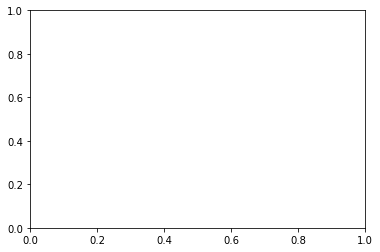

In [33]:
# trying to plot the masked version
pcolormesh(dx_masked, dy_masked, amplNS_masked)

In [62]:
# now interpolate the data to the grid
amplNS_interped = griddata((dx_masked, dy_masked), amplNS_masked, (dxNS, dyNS))

# some extra steps to deal with weird NaNs at the edges
nan_mask = np.isnan(amplNS_interped) # find the NaNs
amplNS_interped[nan_mask] = griddata((dx_masked, dy_masked), amplNS_masked, (dxNS, dyNS), method='nearest')[nan_mask]

In [35]:
# checking for NaNs
print(np.any(np.isnan(amplNS_masked)))
print(amplNS_masked.shape)
print(dx_masked.shape)
print(dy_masked.shape)

False
(1144,)
(1144,)
(1144,)


In [37]:
# trying out different krig interpolations
amplNS_krig_interper_spherical = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='spherical')
amplNS_krig_spherical_interped, krige_variance = amplNS_krig_interper_spherical.execute('grid', dxNS[:,0], dyNS[0,:])

# gaussian
amplNS_krig_interper_gaussian = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='gaussian')
amplNS_krig_gaussian_interped, krige_variance = amplNS_krig_interper_gaussian.execute('grid', dxNS[:,0], dyNS[0,:])

# linear
amplNS_krig_interper_linear = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='linear')
amplNS_krig_linear_interped, krige_variance = amplNS_krig_interper_linear.execute('grid', dxNS[:,0], dyNS[0,:])

# power
amplNS_krig_interper_power = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='power')
amplNS_krig_power_interped, krige_variance = amplNS_krig_interper_power.execute('grid', dxNS[:,0], dyNS[0,:])

# exponential
amplNS_krig_interper_exponential = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='exponential')
amplNS_krig_exponential_interped, krige_variance = amplNS_krig_interper_exponential.execute('grid', dxNS[:,0], dyNS[0,:])

# hole effect
amplNS_krig_interper_hole = OrdinaryKriging(dx_masked, dy_masked, amplNS_masked, variogram_model='hole-effect')
amplNS_krig_hole_interped, krige_variance = amplNS_krig_interper_hole.execute('grid', dxNS[:,0], dyNS[0,:])

IndexError: list index out of range

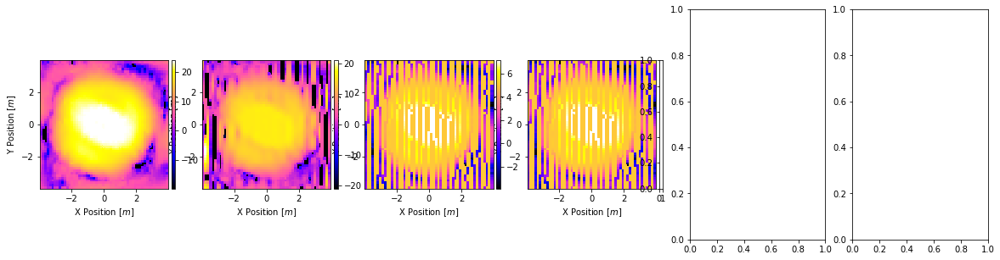

In [38]:
# plotting all the results
fig, ax = subplots(1, 6, figsize=(20,5))

krig_interped = [amplNS_krig_spherical_interped, amplNS_krig_gaussian_interped, amplNS_krig_linear_interped, amplNS_krig_power_interped, amplNS_krig_exponential_interped, amplNS_krig_hole_interped]


for i, krig_interped in enumerate(krig_interped):
    ax[i].pcolormesh(dxNS, dyNS, krig_interped, norm=LogNorm(), cmap='gnuplot2',shading='auto')
    ax[i].set_xlabel('X Position $[m]$')
    ax[i].set_ylabel('Y Position $[m]$')
    ax[i].set_aspect('equal')
    ax[i].set_facecolor('k')
    divider=make_axes_locatable(ax[i])
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)

In [39]:
print(np.any(np.isnan(amplNS_krig_hole_interped)))
print(np.any(np.isnan(amplNS_krig_exponential_interped)))
print(np.any(np.isnan(amplNS_krig_gaussian_interped)))

False
False
False


<ipython-input-63-c0be7f96160e>:2: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
<ipython-input-63-c0be7f96160e>:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1].pcolormesh(dxNS, dyNS, amplNS_interped, norm=LogNorm(), cmap='gnuplot2')


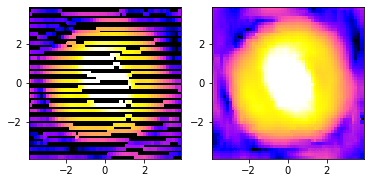

In [63]:
fig, ax = subplots(1,2)
ax[0].pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
ax[0].set_aspect('equal')
ax[0].set_facecolor('k')
ax[1].pcolormesh(dxNS, dyNS, amplNS_interped, norm=LogNorm(), cmap='gnuplot2')
ax[1].set_aspect('equal')
ax[1].set_facecolor('k')

In [41]:
print(amplNS_krig_interped.shape)
print(amplNS_interped.shape)
print(amplNS_krig_interped)

NameError: name 'amplNS_krig_interped' is not defined

In [64]:
# make a complex E field using the interpolated data and phase
phasefactorNS = np.exp(1.0j*phaseNS)
# cplxEfieldNS=amplNS*phasefactorNS
cplxEfieldNS_interped=amplNS_interped*phasefactorNS

In [65]:
# make it for the krig interped data

# hole effect
phasefactorNS = np.exp(1.0j*phaseNS)
cplxEfieldNS_krig_interped_hole = amplNS_krig_hole_interped*phasefactorNS

# exponential
cplxEfieldNS_krig_interped_exp = amplNS_krig_exponential_interped*phasefactorNS

<ipython-input-68-2cfd802ce009>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1 = ax[0].pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi1NS,cmap='gnuplot2')
<ipython-input-68-2cfd802ce009>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2 = ax[1].pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],NFNSbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
<ipython-input-68-2cfd802ce009>:5: Matp

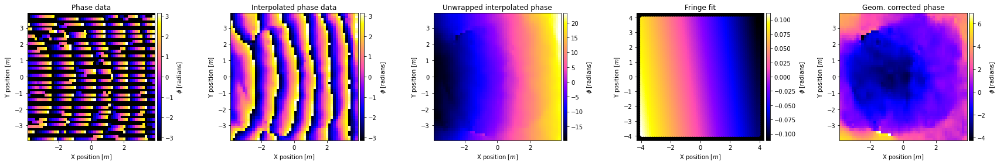

In [68]:
# big phase plot for presentation
fig, ax = subplots(nrows=1,ncols=5, figsize=(30, 4))
im1 = ax[0].pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],phi1NS,cmap='gnuplot2')
im2 = ax[1].pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],NFNSbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
im3 = ax[2].pcolormesh(NFNSbeam.d0_centers_grid[:,:,0],NFNSbeam.d1_centers_grid[:,:,0],unwrap2d(NFNSbeam.beam_linear_interp_phase[:,:,find,0]),cmap='gnuplot2') # the unwrapped interped data
im4 = ax[3].scatter(dxNS,dyNS,s=50,c=Fringe(poptNS,unitvectsNS,wlNS),cmap='gnuplot2') # the fringe fit
im5 = ax[4].pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
# possibly add the final phase after it's subtracted?

images=[im1,im2,im3,im4,im5]
titles=['Phase data','Interpolated phase data','Unwrapped interpolated phase','Fringe fit','Geom. corrected phase']
for i, ax in enumerate(ax):
    ax.set_facecolor('k')
    ax.set_xlabel('X position $[m]$')
    ax.set_ylabel('Y position $[m]$')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right',size='3%',pad=0.05)
    cbar=fig.colorbar(images[i],cax=cax)
    cbar.set_label('$\phi$ [radians]')
    ax.set_title(titles[i])
    ax.set_aspect('equal')

<ipython-input-51-e00e14d47a8e>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
<ipython-input-51-e00e14d47a8e>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(dxNS, dyNS, nanmaskNS*phaseNS, cmap='gnuplot2')
<ipython-input-51-e00e14d47a8e>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either speci

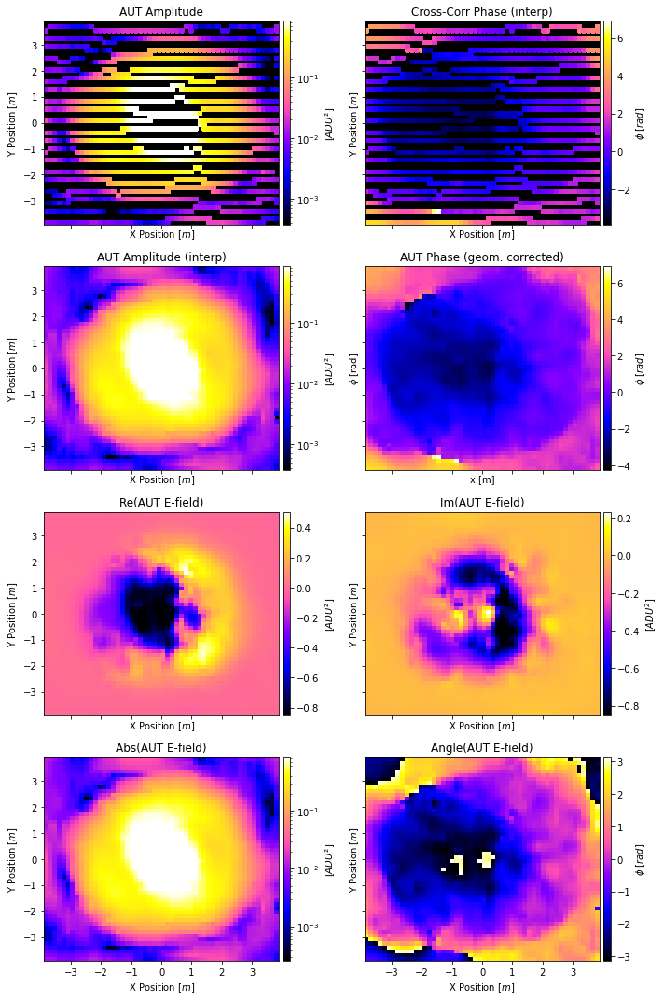

In [51]:
fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)


im1=ax1.pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
# im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im2=ax2.pcolormesh(dxNS, dyNS, nanmaskNS*phaseNS, cmap='gnuplot2')
im3=ax3.pcolormesh(dxNS, dyNS, amplNS_interped, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im5=ax5.pcolormesh(dxNS, dyNS, np.real(cplxEfieldNS_interped), cmap='gnuplot2')
im6=ax6.pcolormesh(dxNS, dyNS, np.imag(cplxEfieldNS_interped), cmap='gnuplot2')
im7=ax7.pcolormesh(dxNS, dyNS, np.abs(cplxEfieldNS_interped), cmap = 'gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dxNS, dyNS, np.angle(cplxEfieldNS_interped), cmap = 'gnuplot2')


images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["AUT Amplitude","Cross-Corr Phase (interp)","AUT Amplitude (interp)","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

<ipython-input-86-de59b0433c04>:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
<ipython-input-86-de59b0433c04>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(dxNS, dyNS, nanmaskNS*phaseNS, cmap='gnuplot2')
<ipython-input-86-de59b0433c04>:8: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either speci

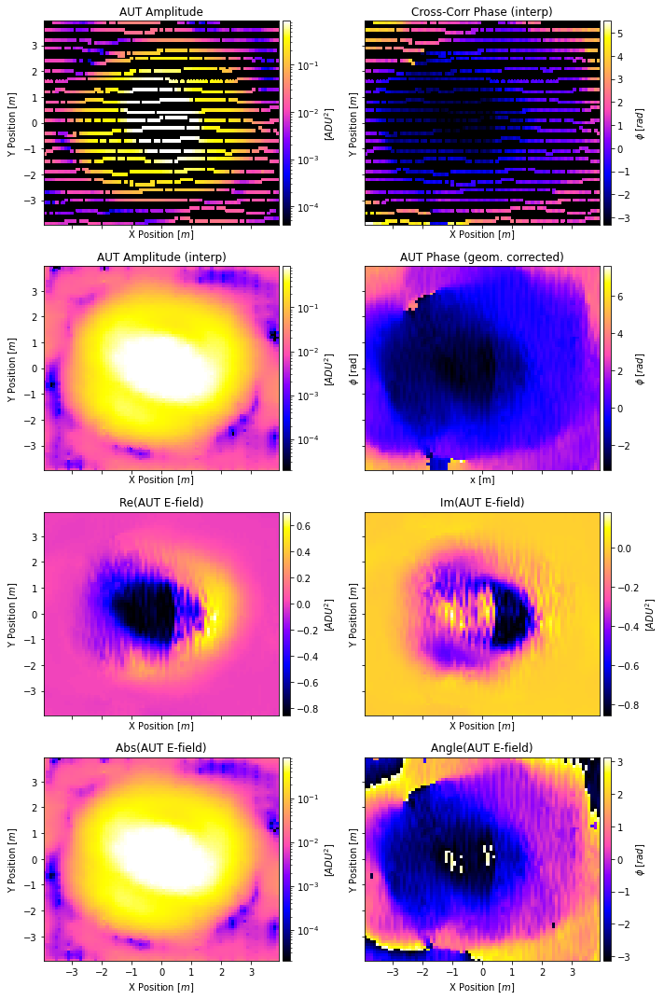

In [86]:
# plotting krig interped version--hole
fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)


im1=ax1.pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
# im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im2=ax2.pcolormesh(dxNS, dyNS, nanmaskNS*phaseNS, cmap='gnuplot2')
im3=ax3.pcolormesh(dxNS, dyNS, amplNS_krig_exponential_interped, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im5=ax5.pcolormesh(dxNS, dyNS, np.real(cplxEfieldNS_krig_interped_exp), cmap='gnuplot2')
im6=ax6.pcolormesh(dxNS, dyNS, np.imag(cplxEfieldNS_krig_interped_exp), cmap='gnuplot2')
im7=ax7.pcolormesh(dxNS, dyNS, np.abs(cplxEfieldNS_krig_interped_exp), cmap = 'gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dxNS, dyNS, np.angle(cplxEfieldNS_krig_interped_exp), cmap = 'gnuplot2')


images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["AUT Amplitude","Cross-Corr Phase (interp)","AUT Amplitude (interp)","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

<ipython-input-40-b8348fc0df6e>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(dxNS, dyNS, NFNSbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
<ipython-input-40-b8348fc0df6e>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
<ipython-input-40-b8348fc0df6e>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.

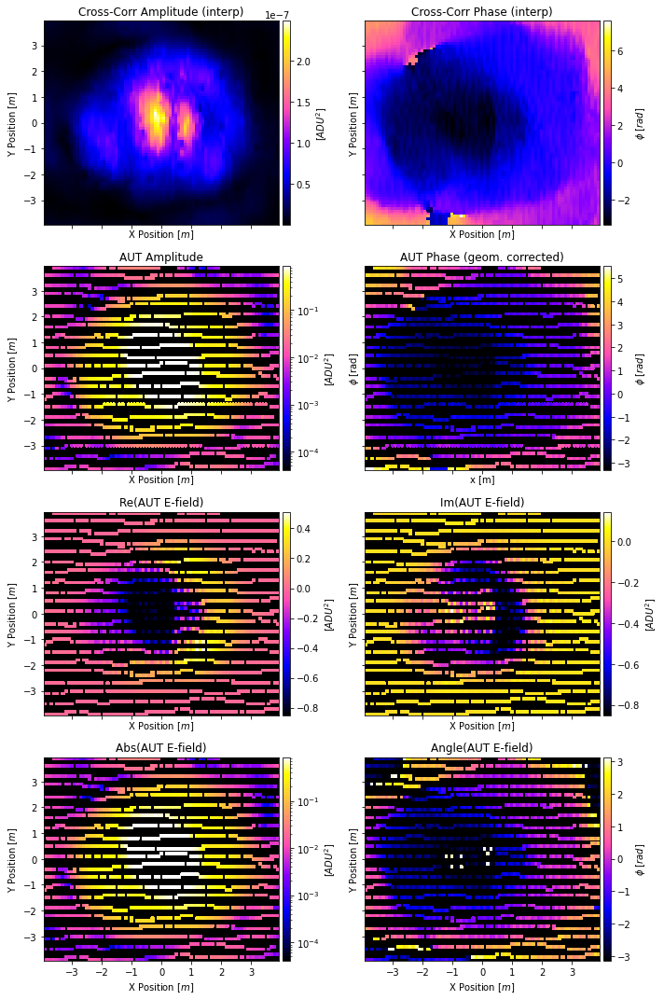

In [40]:
fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)


im1=ax1.pcolormesh(dxNS, dyNS, NFNSbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
# im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im3=ax3.pcolormesh(dxNS, dyNS, amplNS, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dxNS, dyNS, nanmaskNS*phaseNS, cmap='gnuplot2')
im5=ax5.pcolormesh(dxNS, dyNS, np.real(cplxEfieldNS), cmap='gnuplot2')
im6=ax6.pcolormesh(dxNS, dyNS, np.imag(cplxEfieldNS), cmap='gnuplot2')
im7=ax7.pcolormesh(dxNS, dyNS, np.abs(cplxEfieldNS), cmap = 'gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dxNS, dyNS, np.angle(cplxEfieldNS), cmap = 'gnuplot2')



images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["Cross-Corr Amplitude (interp)","Cross-Corr Phase (interp)","AUT Amplitude","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

In [41]:
## To prepare data for the NF2FF code, we need to determine the electric field in both polarizations:
## NF File 1: ch0=Bicolog, ch1=Telescope_Y_NSpol --> ## 'FLY781.csv' - Altitude ~18m, Yaw ~0deg --> NFNS18
## NF File 2: ch0=Telescope_X_EWpol, ch1=Bicolog
    ## 'FLY782.csv' - Altitude ~18m, Yaw ~90deg  --> NFEW18
    ## 'FLY783.csv' - Altitude ~20m, Yaw ~90deg  --> NFEW20 

start of concat loop is: 2024-12-08 14:40:31.829138


<ipython-input-137-28c1fcd841c4>:306: RuntimeWarning: divide by zero encountered in reciprocal
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
<ipython-input-137-28c1fcd841c4>:306: RuntimeWarning: invalid value encountered in multiply
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]


/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:229: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:211: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True, where=where)


end of concat loop is: 2024-12-08 14:44:33.20588324,           


<ipython-input-137-28c1fcd841c4>:367: RuntimeWarning: Mean of empty slice
  self.V_LC_operation=np.nanmean(self.V_LC_mean,axis=4)


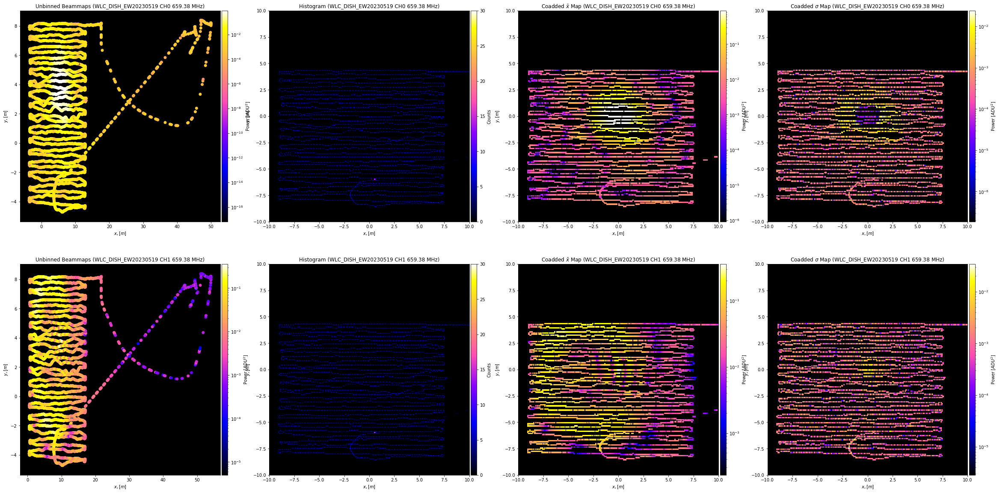

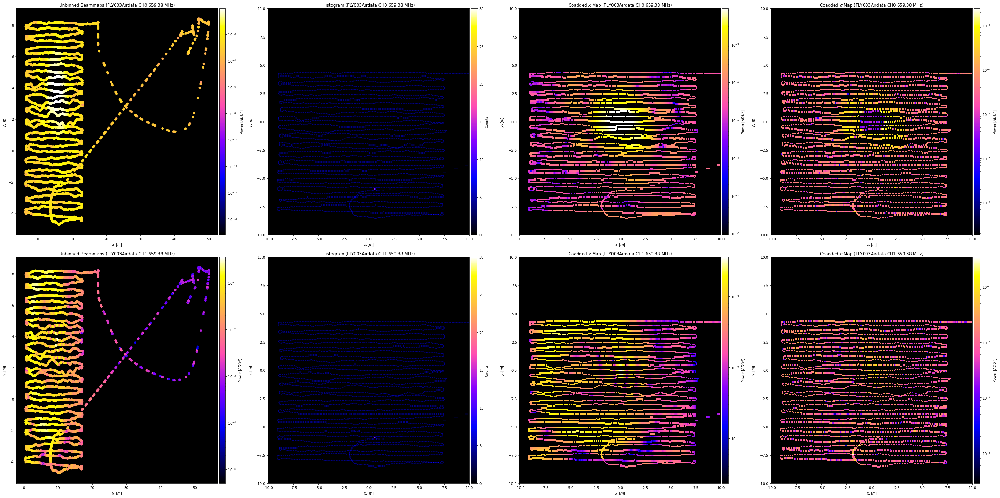

In [144]:
## NF File 2: ch0=Telescope_X_EWpol, ch1=Bicolog
#testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-18,16,0.45],Yargs=[-17,18,0.45],f_index=340,normalization='Gauss',operation='coadd',
#testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-20,20,0.225],Yargs=[-20,20,0.225],f_index=340,normalization='Gauss',operation='coadd',
#testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-16,16,0.45],Yargs=[-16,16,0.45],f_index=340,normalization='Gauss',operation='coadd',
NFEWbeam=Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],d0args=[-10,10,0.1],d1args=[-10,10,0.1],f_index_cc=360,normalization='Gauss',operation='coadd',
                         pickle_directory="/hirax/20240308_WLC_NFandFF/products/pickles/",\
                          gfit_directory="/hirax/20240308_WLC_NFandFF/products/gfits/",\
                         flightmasterpath="20240308_WLC_flights_forscripts.yaml",vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
# thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/beam_pickles/",include_cross_data=True)
# print(thingy.tmppath)
# with open(thingy.tmppath, 'wb') as outp:
#     pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
# print('DONE')

In [145]:
NFEWbeam.complex_interpolation(d0_interp=NFEWbeam.d0_centers[:,0], d1_interp=NFEWbeam.d1_centers[:,0],method='cubic',variogram_model='spherical',outputs=False,Fargs=[340,340])

/home/am3674/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:1540: RuntimeWarning: invalid value encountered in remainder
  ddmod = mod(dd + pi, 2*pi) - pi


In [146]:
NFEWbeam.krig_complex_interpolation([250,330,331],d0_interp=NFEWbeam.d0_centers[:,0],d1_interp=NFEWbeam.d1_centers[:,0],variogram_model='exponential')

Starting freq index: 250
Starting freq index: 330
Starting freq index: 331


<ipython-input-53-2de0f911b645>:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-53-2de0f911b645>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-53-2de0f911b645>:7: MatplotlibDeprecationWarnin

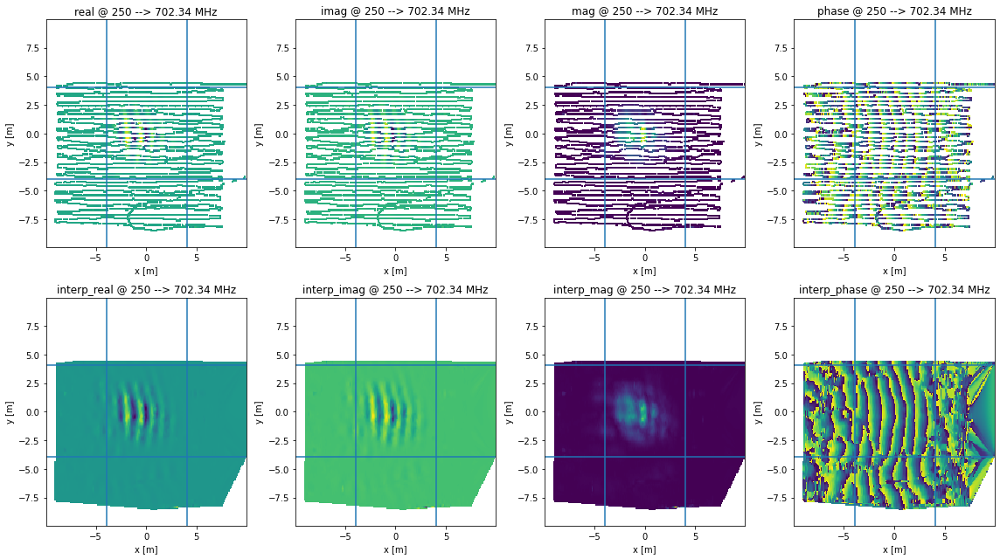

In [53]:
## plot the results of the interpolation and find where to cut to eliminate NAN values:

fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,9))
find=250
ax1.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.V_LC_cross.real[:,:,find,0,0])
ax2.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.V_LC_cross.imag[:,:,find,0,0])
ax3.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],np.abs(NFEWbeam.V_LC_cross)[:,:,find,0,0])#,norm=LogNorm())
ax4.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],np.angle(NFEWbeam.V_LC_cross)[:,:,find,0,0])

ax5.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.beam_linear_interp.real[:,:,find,0])
ax6.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.beam_linear_interp.imag[:,:,find,0])
ax7.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.beam_linear_interp_amp[:,:,find,0])#,norm=LogNorm())
ax8.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],NFEWbeam.beam_linear_interp_phase[:,:,find,0])

titles=['real','imag','mag','phase','interp_real','interp_imag','interp_mag','interp_phase']
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i]+' @ {} --> {:.2f} MHz'.format(find,NFEWbeam.freq[find]))
    ax.set_xlabel('x [m]')
    ax.set_ylabel('y [m]')
    ax.axvline(NFEWbeam.d0_centers_grid[60,0,0])
    ax.axhline(NFEWbeam.d1_centers_grid[0,60,0])
    ax.axvline(NFEWbeam.d0_centers_grid[-60,0,0])
    ax.axhline(NFEWbeam.d1_centers_grid[0,-60,0])
tight_layout()

In [54]:
NFEWbeam.beam_linear_interp_amp.shape

(200, 200, 1024, 1)

In [55]:
# cropping to a square and removing NaNs
stop
xmin,xmax,ymin,ymax=[60,-60,60,-60]
NFEWbeam.beam_linear_interp=NFEWbeam.beam_linear_interp[xmin:xmax,ymin:ymax]
NFEWbeam.beam_linear_interp_amp=NFEWbeam.beam_linear_interp_amp[xmin:xmax,ymin:ymax]
NFEWbeam.beam_linear_interp_phase=NFEWbeam.beam_linear_interp_phase[xmin:xmax,ymin:ymax]
NFEWbeam.beam_linear_interp_phase_unwrapped=NFEWbeam.beam_linear_interp_phase_unwrapped[xmin:xmax,ymin:ymax]
NFEWbeam.histogram_LC=NFEWbeam.histogram_LC[xmin:xmax,ymin:ymax]
NFEWbeam.V_LC_cross=NFEWbeam.V_LC_cross[xmin:xmax,ymin:ymax]
NFEWbeam.V_LC_mean=NFEWbeam.V_LC_mean[xmin:xmax,ymin:ymax]
NFEWbeam.V_LC_operation=NFEWbeam.V_LC_operation[xmin:xmax,ymin:ymax]
NFEWbeam.V_LC_std=NFEWbeam.V_LC_std[xmin:xmax,ymin:ymax]
NFEWbeam.d0_centers_grid=NFEWbeam.d0_centers_grid[xmin:xmax,ymin:ymax]
NFEWbeam.d0_edges_grid=NFEWbeam.d0_edges_grid[xmin:xmax,ymin:ymax]
NFEWbeam.d1_centers_grid=NFEWbeam.d1_centers_grid[xmin:xmax,ymin:ymax]
NFEWbeam.d1_edges_grid=NFEWbeam.d1_edges_grid[xmin:xmax,ymin:ymax]
    
    
NFEWbeam.d0_centers=NFEWbeam.d0_centers[xmin:xmax]
NFEWbeam.d0_edges=NFEWbeam.d0_edges[xmin:xmax]
NFEWbeam.d1_centers=NFEWbeam.d1_centers[ymin:ymax]
NFEWbeam.d1_edges=NFEWbeam.d1_edges[ymin:ymax]

In [56]:
NFEWbeam.beam_linear_interp_amp.shape

(80, 80, 1024, 1)

<ipython-input-57-111a7230e544>:8: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
<ipython-input-57-111a7230e544>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phiunwrap,cmap='gnuplot2')
<ipython-input-57-111a7230e544>:10: MatplotlibDeprecationWarning: shading='flat' when

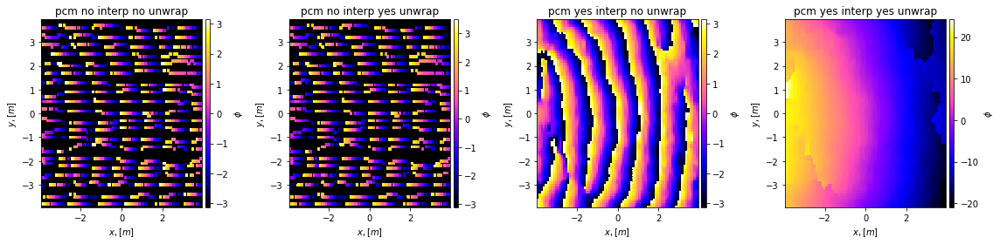

In [57]:
fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
find=331
phi1=np.angle(NFEWbeam.V_LC_cross[:,:,find,0,0])
phiunwrap=unwrap2d(phi1,wrap_args=(False,True))
phi_i=NFEWbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i,wrap_args=(False,True))

im1=ax1.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2=ax2.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phiunwrap,cmap='gnuplot2')
im3=ax3.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im4=ax4.pcolormesh(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2')
images=[im1,im2,im3,im4]
titles=["pcm no interp no unwrap","pcm no interp yes unwrap","pcm yes interp no unwrap","pcm yes interp yes unwrap"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
# for ax in [ax2,ax5,ax6]:
#     ax.plot(range(-20,20),range(-20,20),'r-',linewidth=10)
tight_layout()


(A,B,C)=(-33.511711,-1.266753,0.000029)
G=0.000


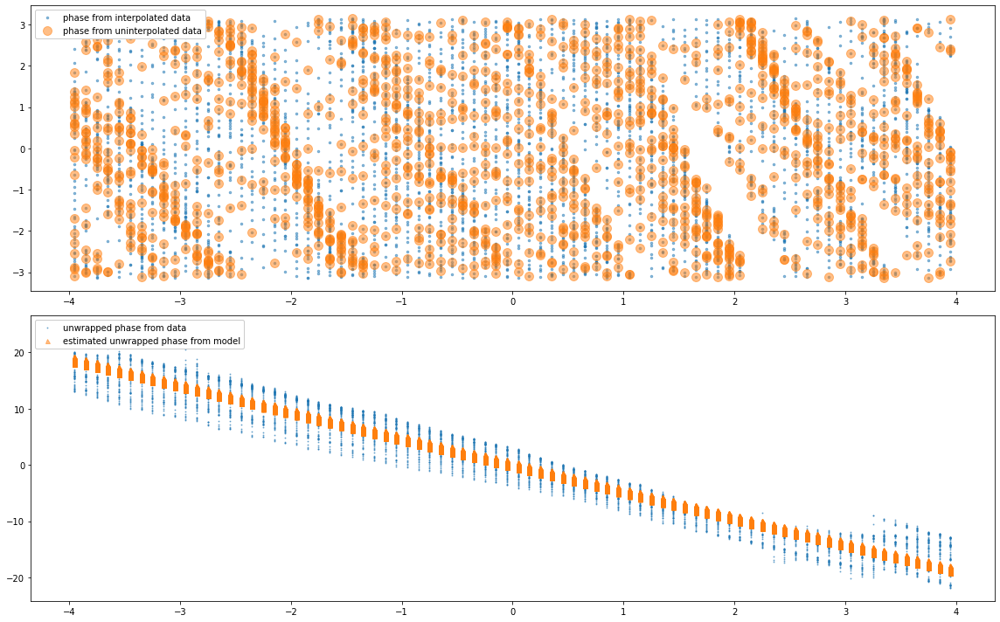

In [58]:
find=331
dx=NFEWbeam.d0_centers_grid[:,:,0]
dy=NFEWbeam.d1_centers_grid[:,:,1]
wl=(3.0e8/(NFEWbeam.freq[find]/1e-6))
dc=(NFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcabs=np.abs(NFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcang=phi_iunwrap.flatten()

phi1=np.angle(NFEWbeam.V_LC_cross[:,:,find,0,0])
phi1unwrap=unwrap2d(phi1)
phi_i=NFEWbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

dcang=phi_iunwrap.flatten()

dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(100*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))


def Fringe_Fit(P,dronepos,V,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi-V

def Fringe(P,dronepos,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi

popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
print("(A,B,C)=({:f},{:f},{:f})".format(popt[0],popt[1],popt[2]))
# print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(popt[3]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
ax1.plot(dcoords[:,0],phi_i.flatten(),'.',alpha=0.5,markersize=5,label='phase from interpolated data')
ax1.plot(dcoords[:,0],phi1.flatten(),'.',alpha=0.5,markersize=20,label='phase from uninterpolated data')
ax1.legend(loc=2,framealpha=1)
ax2.plot(dcoords[:,0],dcang,'.',alpha=0.5,markersize=2,label='unwrapped phase from data')
ax2.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'^',alpha=0.5,markersize=5,label='estimated unwrapped phase from model')
ax2.legend(loc=2,framealpha=1)
tight_layout()


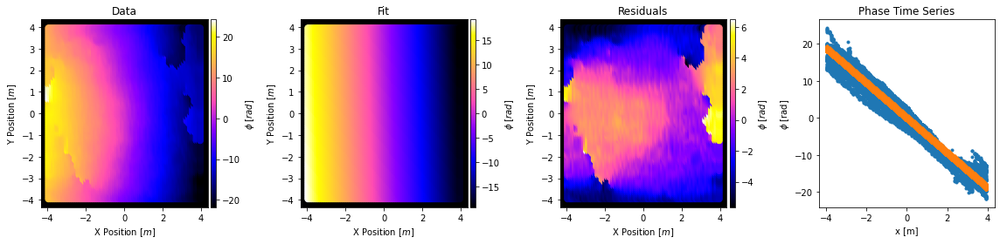

In [59]:
fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im2=ax2.scatter(dx,dy,s=50,c=Fringe(popt,unitvects,wl),cmap='gnuplot2')
im3=ax3.scatter(dx,dy,s=50,c=(dcang-Fringe(popt,unitvects,wl)),cmap='gnuplot2')
ax4.plot(dcoords[:,0],dcang,'.')
ax4.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


In [61]:
dx=NFEWbeam.d0_centers_grid[:,:,0]
dy=NFEWbeam.d1_centers_grid[:,:,0]
dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(97*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))

## I think this loop breaks when np.NaN occurs in the phi_i stage of the loop... going to check testbeam.beam_linear_interp_phase[:,:,find,0] for nan for each find...
fringepopt=np.NaN*np.ones((140,4))
fringedata=np.NaN*np.ones((80,80,140))
for k,find in enumerate(range(250,390)):
    print("{},{}".format(k,find),end='\r')
    wl=(3.0e8/(NFEWbeam.freq[find]/1e-6))
    dc=(NFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
    dcabs=np.abs(NFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
    phi_i=NFEWbeam.beam_linear_interp_phase[:,:,find,0]
#     if True in np.isnan(testbeam.beam_linear_interp_phase[:,:,find,0]):
#         print('true, breaking loop to skip index {}'.format(k))
#     else:
    phi_iunwrap=unwrap2d(phi_i,wrap_args=(False,True))
    dcang=phi_iunwrap.flatten()
    fringedata[:,:,k]=phi_iunwrap
    popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
    fringepopt[k,:]=popt    

<ipython-input-15-9da5a052bcdb>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  cax1 = ax1.pcolormesh(dx, dy, np.angle(NFEWbeam.V_LC_cross[:,:,250,0,0]), vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
<ipython-input-15-9da5a052bcdb>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  cax2 = ax2.pcolormesh(dx, dy, NFEWbeam.beam_linear_interp_phase[:,:,250,0], vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
<ipython-input-15-9da5a052bcdb>:5: MatplotlibDeprecationWarnin

TypeError: Fringe() missing 1 required positional argument: 'wavelengthm'

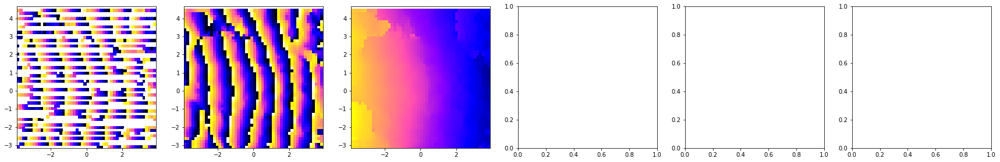

In [15]:
# making the gif
from matplotlib.animation import FuncAnimation
fig,[ax1,ax2,ax3,ax4,ax5,ax6]=subplots(nrows=1,ncols=6,figsize=(30,4.5))
cax1 = ax1.pcolormesh(dx, dy, np.angle(NFEWbeam.V_LC_cross[:,:,250,0,0]), vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax2 = ax2.pcolormesh(dx, dy, NFEWbeam.beam_linear_interp_phase[:,:,250,0], vmin=-1*np.pi, vmax=np.pi, cmap='gnuplot2')
cax3 = ax3.pcolormesh(dx, dy, fringedata[:,:,0], vmin=-30, vmax=30, cmap='gnuplot2')
cax4 = ax4.pcolormesh(dx, dy, Fringe(fringepopt[0,:],dcoords).reshape(dx.shape), vmin=-30, vmax=30, cmap='gnuplot2')
cax5 = ax5.pcolormesh(dx, dy, fringedata[:,:,0]-Fringe(fringepopt[0,:],dcoords).reshape(dx.shape), vmin=-4*np.pi, vmax=4*np.pi, cmap='gnuplot2')

images=[cax1,cax2,cax3,cax4,cax5]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$","$\phi$"]

for j,ax in enumerate([ax1,ax2,ax3,ax4,ax5]):
    #ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
    
# fig.colorbar(cax1)
# fig.colorbar(cax2)
# fig.colorbar(cax3)
# fig.colorbar(cax4)
txt1=ax1.text(-10,-10, "", fontsize=15)
txt2=ax2.text(-10,-10, "", fontsize=15)
txt3=ax3.text(-10,-10, "", fontsize=15)
txt4=ax4.text(-10,-10, "", fontsize=15)
txt5=ax5.text(-10,-10, "", fontsize=15)
tight_layout()


def animate(vvv):
    cax1.set_array(np.angle(testbeam.V_LC_cross[:,:,250+vvv,0,0]))
    cax2.set_array(testbeam.beam_linear_interp_phase[:,:,250+vvv,0])
    cax3.set_array(fringedata[:,:,vvv])
    cax4.set_array(Fringe(fringepopt[vvv],dcoords).reshape(dx.shape))
    cax5.set_array(fringedata[:,:,vvv]-Fringe(fringepopt[vvv],dcoords).reshape(dx.shape))
    
    ax6.clear()
    ax6.plot(dcoords[:,0],fringedata[:,:,vvv].flatten(),'.')
    ax6.plot(dcoords[:,0],Fringe(np.array(fringepopt[vvv,:]),dcoords).flatten(),'.')
    ax6.set_xlim(-15,15)
    ax6.set_ylim(-15,15)
    txt6=ax6.text(-10,-10, "", fontsize=15)
    
    txt1.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt2.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt3.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt4.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt5.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    txt6.set_text("ind{}:{}MHz".format(testbeam.faxis[250:420][vvv],testbeam.freq[250:420][vvv]))
    print("{}".format(vvv),end='\r')

anim = FuncAnimation(fig, animate, interval=100, frames=140)
anim.save('../../Desktop/NFphaseEW.gif')
show()

<ipython-input-62-88b05f3f89e2>:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
<ipython-input-62-88b05f3f89e2>:20: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')


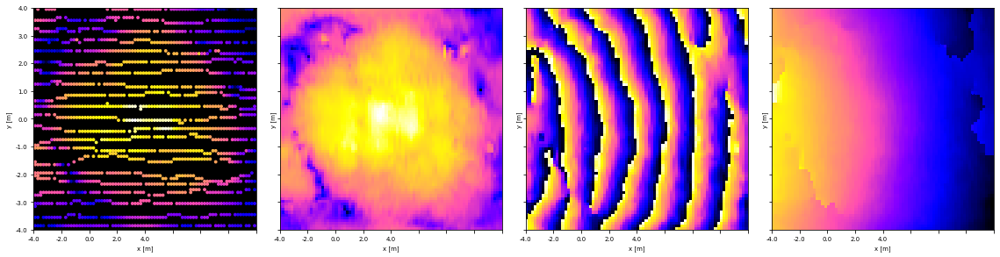

In [62]:
NFEWbeam.beam_linear_interp_phase_unwrapped.shape

fig,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4),sharex=True,sharey=True)
ax1.set_facecolor('k')
find=331
ax1.scatter(NFEWbeam.d0_centers_grid[:,:,0],NFEWbeam.d1_centers_grid[:,:,0],c=np.abs(NFEWbeam.V_LC_cross[:,:,find,0,0]),cmap='gnuplot2',s=8,norm=LogNorm())
#ax1.pcolormesh(testbeam.x_edges_grid[:,:,0],testbeam.y_edges_grid[:,:,0],(testbeam.V_LC_mean[:,:,find,0,0]),cmap='gnuplot2',norm=LogNorm())
ax2.pcolormesh(NFEWbeam.d0_edges_grid[:,:,0],NFEWbeam.d1_edges_grid[:,:,0],(NFEWbeam.beam_linear_interp_amp[:,:,find,0]),cmap='gnuplot2',norm=LogNorm())
ax1.set_xlim(ax2.get_xlim())
ax1.set_ylim(ax2.get_ylim())
ax3.pcolormesh(NFEWbeam.d0_edges_grid[:,:,0],NFEWbeam.d1_edges_grid[:,:,0],NFEWbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
ax4.pcolormesh(NFEWbeam.d0_edges_grid[:,:,0],NFEWbeam.d1_edges_grid[:,:,0],fringedata[:,:,find-250],cmap='gnuplot2')

for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    #ax.title(fontsize='x-small')
    ax.set_xlabel('x [m]',fontsize='x-small')
    ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
    #ax.set_xticks([])
    ax.set_ylabel('y [m]',fontsize='x-small')
    ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')
    #ax.set_yticks([])
    ax.set(aspect='equal')


tight_layout()


In [63]:
# making the complex E-fields to export to the npz
find=331
wl=(3.0e10/(NFEWbeam.freq[find]/1e-6))
zez=100
# zez=0
ampl=NFEWbeam.V_LC_mean[:,:,250+zez,0,0]
nanmask=ampl/ampl
phase=fringedata[:,:,zez]-Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape)
phasefactor=np.e**(1.0j*phase)
cplxEfieldEW=ampl*phasefactor

In [64]:
# making a logical mask to select only existing amplitude values
existing_mask = (np.nan_to_num(nanmask)).astype(int)
existing_mask = (existing_mask != 0)
print(np.any(np.isnan(existing_mask)))
print(np.all(np.isin(existing_mask, [0, 1])))
# flatten everything to mask better
dx_flattened = dx.flatten()
dy_flattened = dy.flatten()
ampl_flattened = ampl.flatten()
mask_flattened = existing_mask.flatten()
dx_masked = dx_flattened[mask_flattened]
dy_masked = dy_flattened[mask_flattened]
amplEW_masked = ampl_flattened[mask_flattened]
print(np.any(np.isnan(amplEW_masked)))

False
True
False


In [65]:
# now interpolate the data to the grid
amplEW_interped = griddata((dx_masked, dy_masked), amplEW_masked, (dx, dy), method='linear')

# some extra steps to deal with weird NaNs at the edges
nan_mask = np.isnan(amplEW_interped) # find the NaNs
amplEW_interped[nan_mask] = griddata((dx_masked, dy_masked), amplEW_masked, (dx, dy), method='nearest')[nan_mask]

In [66]:
# make a complex E field using the interpolated data and phase
phasefactorEW = np.exp(1.0j*phase)
# cplxEfieldNS=amplNS*phasefactorNS
cplxEfieldEW_interped=amplEW_interped*phasefactorEW
np.count_nonzero(np.isnan(cplxEfieldEW_interped))
print(np.count_nonzero(np.isnan(amplEW_interped)))

0


<ipython-input-67-e7ee9fc4a2ba>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(dx, dy, ampl, norm=LogNorm(), cmap='gnuplot2')
<ipython-input-67-e7ee9fc4a2ba>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(dx, dy, nanmask*phase, cmap='gnuplot2')
<ipython-input-67-e7ee9fc4a2ba>:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners

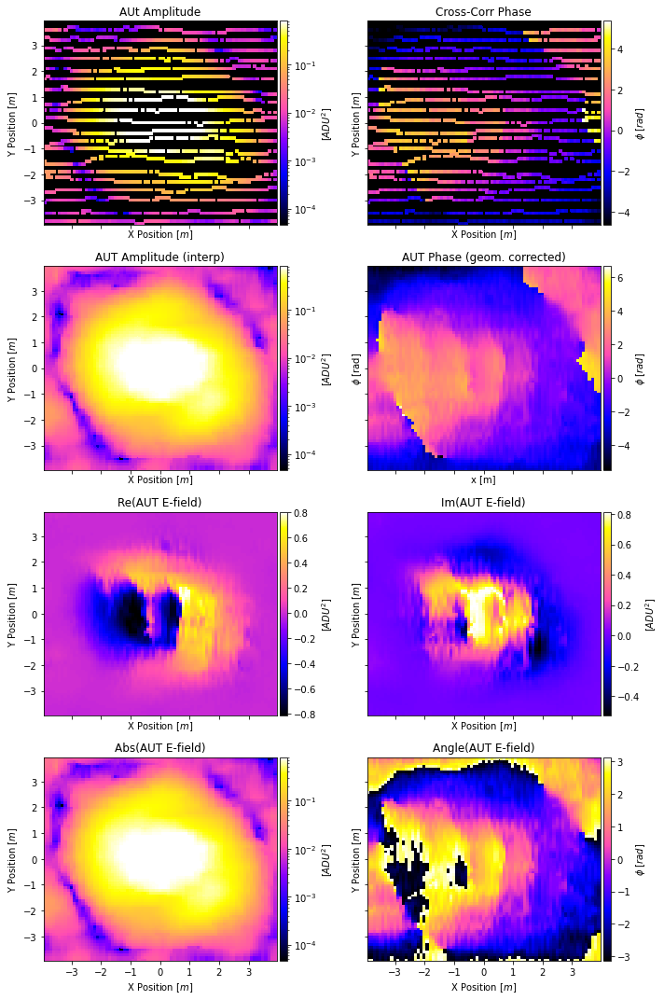

In [67]:
fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)


im1=ax1.pcolormesh(dx, dy, ampl, norm=LogNorm(), cmap='gnuplot2')
# im2=ax2.pcolormesh(dxNS, dyNS, phaseNS, cmap='gnuplot2')
im2=ax2.pcolormesh(dx, dy, nanmask*phase, cmap='gnuplot2')
im3=ax3.pcolormesh(dx, dy, amplEW_interped, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dx, dy, phase, cmap='gnuplot2')
im5=ax5.pcolormesh(dx, dy, np.real(cplxEfieldEW_interped), cmap='gnuplot2')
im6=ax6.pcolormesh(dx, dy, np.imag(cplxEfieldEW_interped), cmap='gnuplot2')
im7=ax7.pcolormesh(dx, dy, np.abs(cplxEfieldEW_interped), cmap = 'gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dx, dy, np.angle(cplxEfieldEW_interped), cmap = 'gnuplot2')


images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["AUt Amplitude","Cross-Corr Phase","AUT Amplitude (interp)","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

<ipython-input-105-520205df09a9>:2: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(dx, dy, NFEWbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
<ipython-input-105-520205df09a9>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(dx, dy, phase, cmap='gnuplot2')
<ipython-input-105-520205df09a9>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Eithe

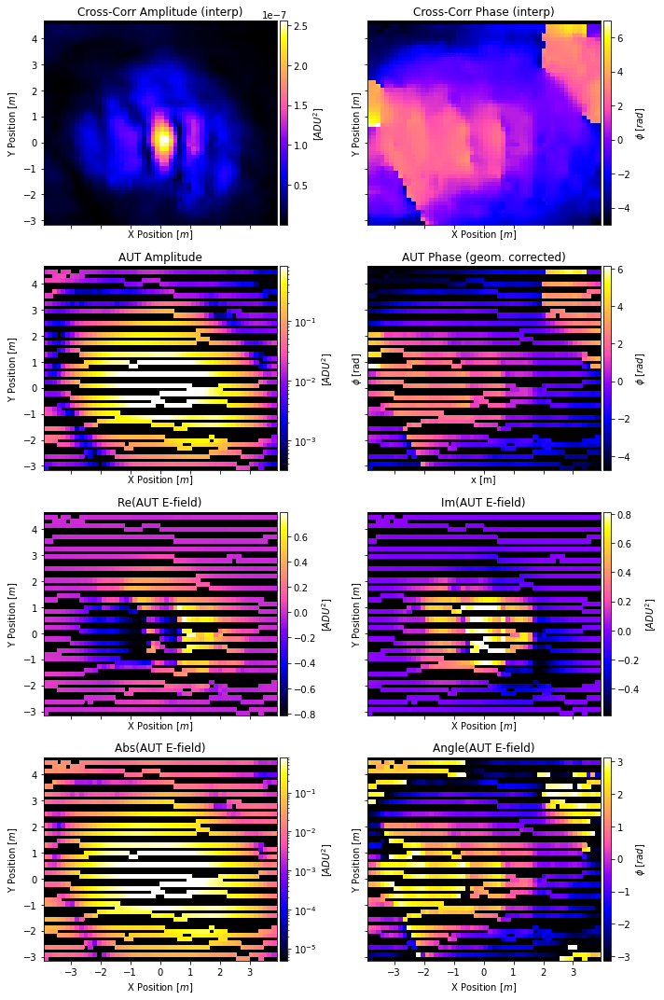

In [105]:
fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)
im1=ax1.pcolormesh(dx, dy, NFEWbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
im2=ax2.pcolormesh(dx, dy, phase, cmap='gnuplot2')
im3=ax3.pcolormesh(dx, dy, ampl, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dx, dy, nanmask*phase, cmap='gnuplot2')
im5=ax5.pcolormesh(dx, dy, np.real(cplxEfieldEW), cmap='gnuplot2')
im6=ax6.pcolormesh(dx, dy, np.imag(cplxEfieldEW), cmap='gnuplot2')
im7=ax7.pcolormesh(dx, dy, np.abs(cplxEfieldEW),cmap='gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dx, dy, np.angle(cplxEfieldEW), cmap='gnuplot2')

images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["Cross-Corr Amplitude (interp)","Cross-Corr Phase (interp)","AUT Amplitude","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

In [19]:
NFEWbeam.freq[350]

663.28125

### Exporting the fields into an npz file

Comment out `stop` below when you actually want to do it, and change to the directory you want.
This only exports the NFs, you would have to add the FF to np.savez below if you want it.

<ipython-input-68-f87544534bfc>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(dxNS,dyNS,np.abs(cplxEfieldEW_interped))
<ipython-input-68-f87544534bfc>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(dxNS,dyNS,np.abs(cplxEfieldNS_interped))


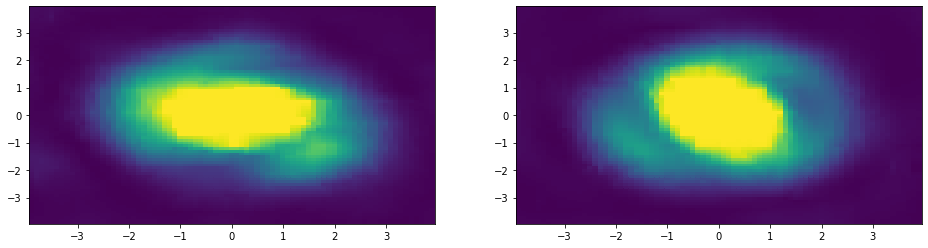

In [68]:
# stop
fig1,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,4))
ax1.pcolormesh(dxNS,dyNS,np.abs(cplxEfieldEW_interped))
ax2.pcolormesh(dxNS,dyNS,np.abs(cplxEfieldNS_interped))

# np.savez("/home/tyndall/Desktop/f354cplxEfield.npz",cplxEfieldEW=cplxEfieldEW,cplxEfieldNS=cplxEfieldNS)
# np.savez("cplxEfield_24042024.npz",cplxEfieldNS=cplxEfieldNS,cplxEfieldEW=cplxEfieldEW)
np.savez("/home/am3674/cplxEfield_fine_19112024.npz", cplxEfieldNS_interped=cplxEfieldNS_interped, cplxEfieldEW_interped=cplxEfieldEW_interped, x = dxNS, y = dyNS, freq = NFNSbeam.freq[331])

In [228]:
dat=np.load("/home/tyndall/Desktop/f354cplxEfield.npz")
for key in dat.keys():
    print(key)
dat['cplxEfieldEW']
dat['cplxEfieldNS']

cplxEfieldEW
cplxEfieldNS


(86, 86)

In [229]:
testbeam.freq[354]

661.71875

# Don't look below here

Just an older version of the code for getting the NF EW pol

In [ ]:
STOP

start of big ass loop is: 2024-01-23 14:28:09.963673


/home/tyndall/python/beamcals_venv/lib/python3.10/site-packages/beamcals/beammap.py:250: RuntimeWarning: divide by zero encountered in reciprocal
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]
/home/tyndall/python/beamcals_venv/lib/python3.10/site-packages/beamcals/beammap.py:250: RuntimeWarning: invalid value encountered in multiply
  Vvals=(np.repeat(np.swapaxes(g_norm[:,self.fmin:self.fmax:self.fstep],0,1)[np.newaxis,:,:],len(ccc.inds_on),axis=0)**-1)*ccc.V_bgsub[ccc.inds_on,self.fmin:self.fmax:self.fstep,:]


/home/tyndall/python/beamcals_venv/lib/python3.10/site-packages/scipy/stats/_binned_statistic.py:594: RuntimeWarning: invalid value encountered in subtract
  delta = values[vv] - flatsum[binnumbers] / flatcount[binnumbers]


end of chan/freq loop is: 2024-01-23 14:28:25.538382           


/home/tyndall/python/beamcals_venv/lib/python3.10/site-packages/beamcals/beammap.py:329: RuntimeWarning: Mean of empty slice
  self.V_LC_operation=np.nanmean(self.V_LC_mean,axis=4)
/home/tyndall/python/beamcals_venv/lib/python3.10/site-packages/beamcals/beammap.py:342: RuntimeWarning: Mean of empty slice
  im4=ax4.pcolormesh(self.x_edges_grid[:,:,i],self.y_edges_grid[:,:,i],np.nanmean(self.V_LC_std[:,:,find,i,:],axis=2),cmap=cm.gnuplot2,norm=LogNorm())


/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/beam_pickles/FLY781_20230519T190815Z_ver_20240123T142826beam_concat.pkl
DONE


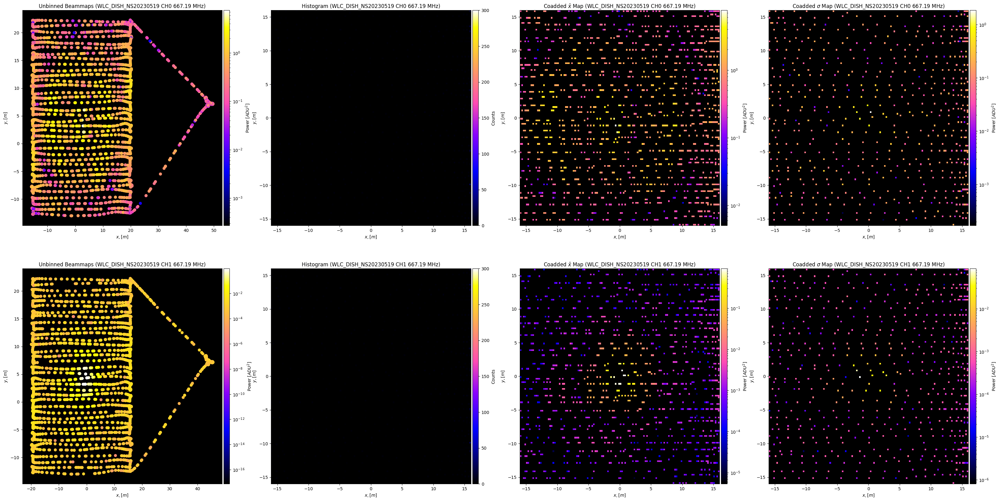

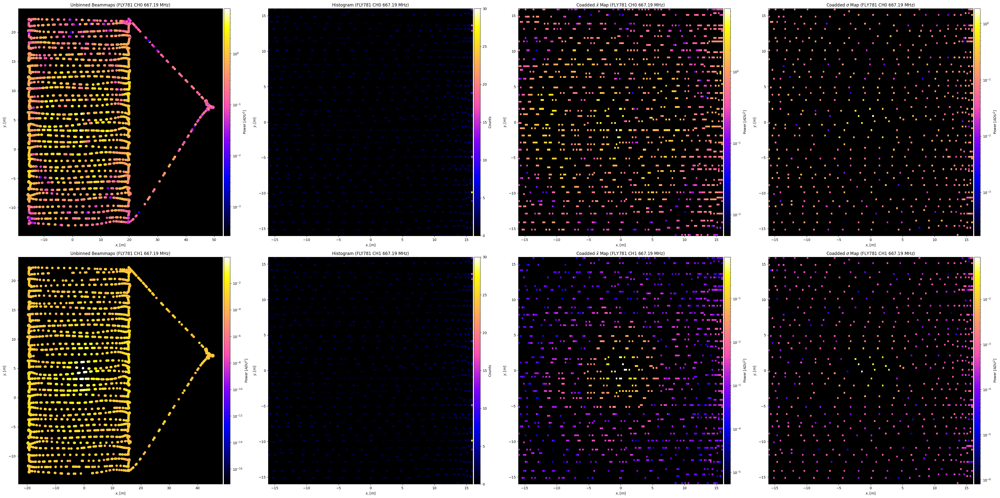

In [28]:
#NF
#testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-18,16,0.5],Yargs=[-17,18,0.5],f_index=340,normalization='Gauss',operation='coadd',
testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-16,16,0.25],Yargs=[-16,16,0.25],f_index=340,normalization='Gauss',operation='coadd',
#testbeam=beammap.Beammap(concatlist=[pcklarr[2]],gfitlist=[gfitarr[2]],Xargs=[-20,20,0.225],Yargs=[-20,20,0.225],f_index=340,normalization='Gauss',operation='coadd',
                         pickle_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/pickles/",\
                         gfit_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/gfits/",\
                         flightmasterpath="/home/tyndall/python/beamcals_venv/newburghlabdrone/analysis/WLC_flights_forscripts.yaml",vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20230519_WLC_NF2FF_Flights/products/beam_pickles/",include_cross_data=True)
print(thingy.tmppath)
with open(thingy.tmppath, 'wb') as outp:
    pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
print('DONE')

In [89]:
testbeam.complex_interpolation(x_interp=testbeam.x_centers[:,0], y_interp=testbeam.y_centers[:,0],method='linear',variogram_model='spherical',outputs=False,Fargs=[340,340])

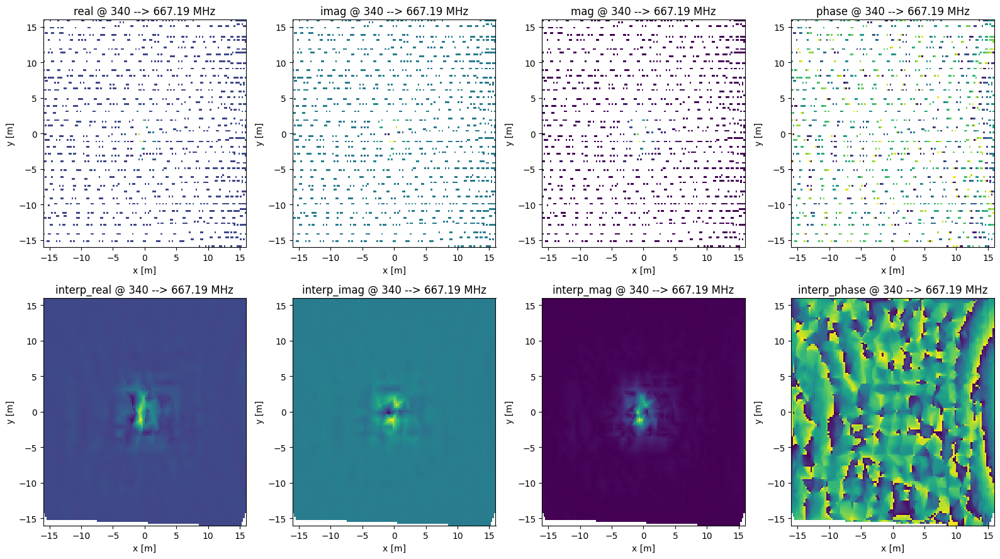

In [111]:
fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,9))
find=340
ax1.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.V_LC_cross.real[:,:,find,0,0])
ax2.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.V_LC_cross.imag[:,:,find,0,0])
ax3.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],np.abs(testbeam.V_LC_cross)[:,:,find,0,0])#,norm=LogNorm())
ax4.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],np.angle(testbeam.V_LC_cross)[:,:,find,0,0])

ax5.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.beam_linear_interp.real[:,:,find,0])
ax6.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.beam_linear_interp.imag[:,:,find,0])
ax7.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.beam_linear_interp_amp[:,:,find,0])#,norm=LogNorm())
ax8.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.beam_linear_interp_phase[:,:,find,0])

titles=['real','imag','mag','phase','interp_real','interp_imag','interp_mag','interp_phase']
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i]+' @ {} --> {:.2f} MHz'.format(find,testbeam.freq[find]))
    ax.set_xlabel('x [m]')
    ax.set_ylabel('y [m]')
tight_layout()

95

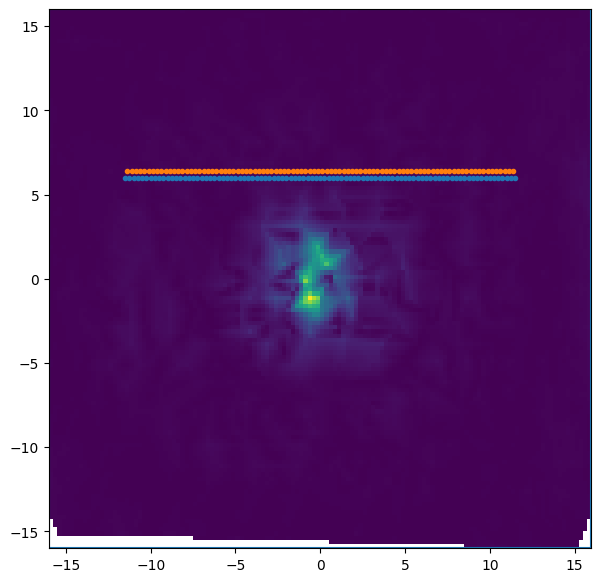

In [112]:
fig,ax1=subplots(nrows=1,ncols=1,figsize=(7,7))
ax1.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],testbeam.beam_linear_interp_amp[:,:,find,0])

testbeam.x_centers_grid.shape
177/2
ax1.axhline(16)
ax1.axhline(-16)
ax1.axvline(16)
ax1.axvline(-16)

plot(testbeam.x_edges_grid[18:-18,0,0],testbeam.y_edges_grid[18:-18,88,0],'.')
plot(testbeam.x_centers_grid[18:-18,0,0],testbeam.y_centers_grid[18:-18,89,0],'.')
len(testbeam.x_edges[17:-17])

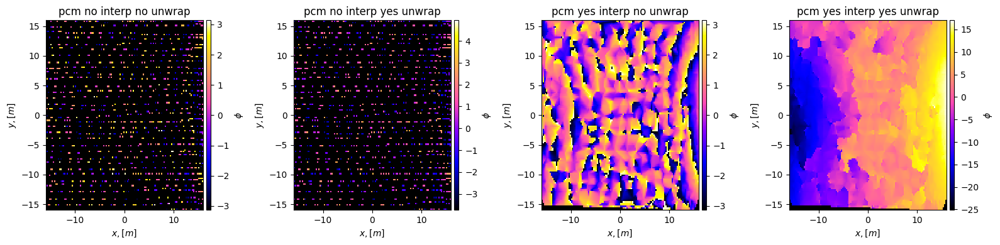

In [120]:
fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
find=340
phi1=np.angle(testbeam.V_LC_cross[:,:,find,0,0])
phiunwrap=unwrap2d(phi1)
phi_i=testbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

im1=ax1.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2=ax2.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phiunwrap,cmap='gnuplot2')
im3=ax3.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im4=ax4.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2')
images=[im1,im2,im3,im4]
titles=["pcm no interp no unwrap","pcm no interp yes unwrap","pcm yes interp no unwrap","pcm yes interp yes unwrap"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
# for ax in [ax2,ax5,ax6]:
#     ax.plot(range(-20,20),range(-20,20),'r-',linewidth=10)
tight_layout()


(A,B,C)=(5.436,0.209,-0.829)
(D,E,F)=(11.854,-7.616,15.083)
G=0.200


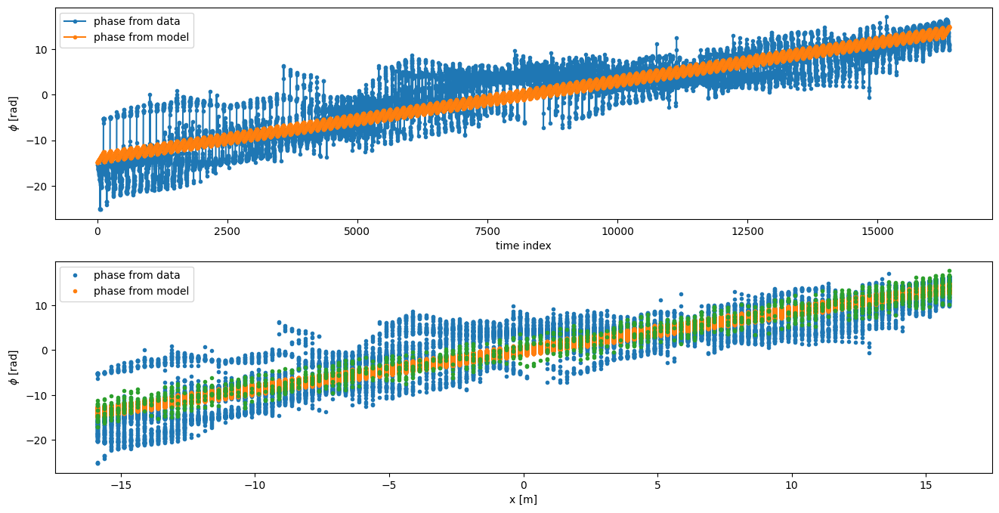

In [121]:
dx=testbeam.x_centers_grid[:,:,0]
dy=testbeam.y_centers_grid[:,:,1]
wl=(3.0e8/(testbeam.freq[find]/1e-6))
dc=(testbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcabs=np.abs(testbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcang=phi_iunwrap.flatten()

dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(18*np.ones((dx.shape[0]*dx.shape[1]))).flatten()

# dxax=np.linspace(-10,10,1000)
# dyax=np.linspace(-10,10,1000)
# griddx,griddy=np.meshgrid(dxax,dyax)
# sqware=np.outer(dxax,dyax)

popt=least_squares(Fringe_Fit,x0=np.array([1.4,0.0,0.25,4.0,0.0,0.5,0.2]),args=[dcoords[~np.isnan(dcang)],dcang[~np.isnan(dcang)]]).x
print("(A,B,C)=({:.3f},{:.3f},{:.3f})".format(2*np.pi*popt[0],2*np.pi*wl*popt[1],2*np.pi*wl*popt[2]))
print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(popt[6]))
#print(Fringe(popt,dcoords[tcut]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,8))
ax1.plot(dcang,'.-',label='phase from data')
ax1.plot(Fringe(np.array(popt),dcoords),'.-',label='phase from model')
ax1.set_xlabel("time index")
ax1.set_ylabel("$\phi$ [rad]")
ax1.legend()
ax2.plot(dcoords[:,0],dcang,'.',label='phase from data')
ax2.plot(dcoords[:,0],Fringe(np.array(popt),dcoords),'.',label='phase from model')
ax2.plot(testbeam.x_centers_grid[:,:,0].flatten(),(phi1+Fringe(np.array(popt),dcoords).reshape(testbeam.V_LC_cross[:,:,find,0,0].shape)).flatten(),'.')
#ax2.plot(dcoords[tcut][:,0],Fringe(np.array([1.5,0.1,0.4,0.0,0.0,0.9,0.9]),dcoords[tcut]),'.',label='phase from model')
ax2.set_xlabel("x [m]")
ax2.set_ylabel("$\phi$ [rad]")
ax2.legend()



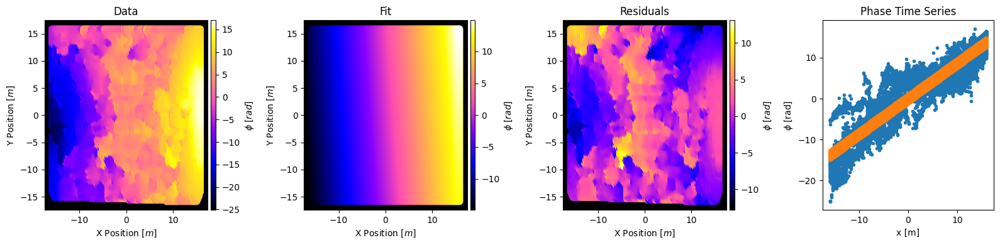

In [122]:
fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im2=ax2.scatter(dx,dy,s=50,c=Fringe(popt,dcoords),cmap='gnuplot2')
#im2=ax2.pcolormesh(dxax,dyax,Fringe(popt,np.array([griddx.flatten(),griddy.flatten(),30*np.ones(len(griddx.flatten()))]).T).reshape(griddx.shape),cmap='gnuplot2',alpha=0.6)
#im1=ax2.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im3=ax3.scatter(dx,dy,s=50,c=(dcang-Fringe(popt,dcoords)),cmap='gnuplot2')
ax4.plot(dcoords[:,0],dcang,'.')
ax4.plot(dcoords[:,0],Fringe(np.array(popt),dcoords),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


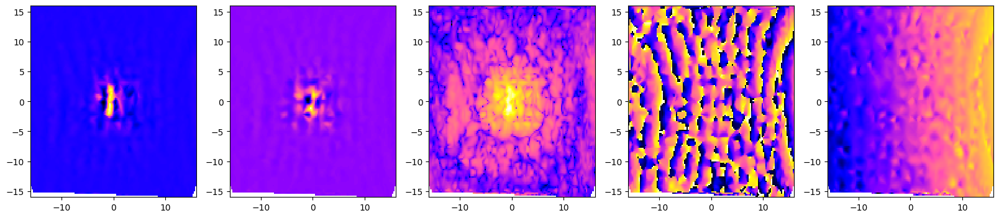

In [123]:
noNans = np.isfinite(testbeam.V_LC_cross[:,:,340,0,0]) # all x, y, chosen frequency and channel
x_noNan = testbeam.x_centers_grid[noNans,0]
y_noNan = testbeam.y_centers_grid[noNans,0]

x_interp=testbeam.x_centers[:,0]
y_interp=testbeam.y_centers[:,0]
x_interp_grid,y_interp_grid=np.meshgrid(x_interp,y_interp,indexing='ij')

fig,[ax1,ax2,ax3,ax4,ax5]=subplots(nrows=1,ncols=5,figsize=(20,4))
interp_re = griddata((x_noNan,y_noNan), np.real(testbeam.V_LC_cross[:,:,340,0,0][noNans]), (x_interp_grid,y_interp_grid), method='cubic')
interp_im = griddata((x_noNan,y_noNan), np.imag(testbeam.V_LC_cross[:,:,340,0,0][noNans]), (x_interp_grid,y_interp_grid), method='cubic')
interp_c = interp_re + 1.0j*interp_im
interp_phi = griddata((x_noNan,y_noNan),(np.angle(testbeam.V_LC_cross[:,:,340,0,0])+Fringe(np.array(popt),dcoords).reshape(testbeam.V_LC_cross[:,:,find,0,0].shape))[noNans], (x_interp_grid,y_interp_grid), method='cubic')

ax1.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],interp_re,cmap='gnuplot2')
ax2.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],interp_im,cmap='gnuplot2')
ax3.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],np.abs(interp_c),cmap='gnuplot2',norm=LogNorm())
ax4.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],np.angle(interp_c),cmap='gnuplot2')
ax5.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],interp_phi,cmap='gnuplot2')


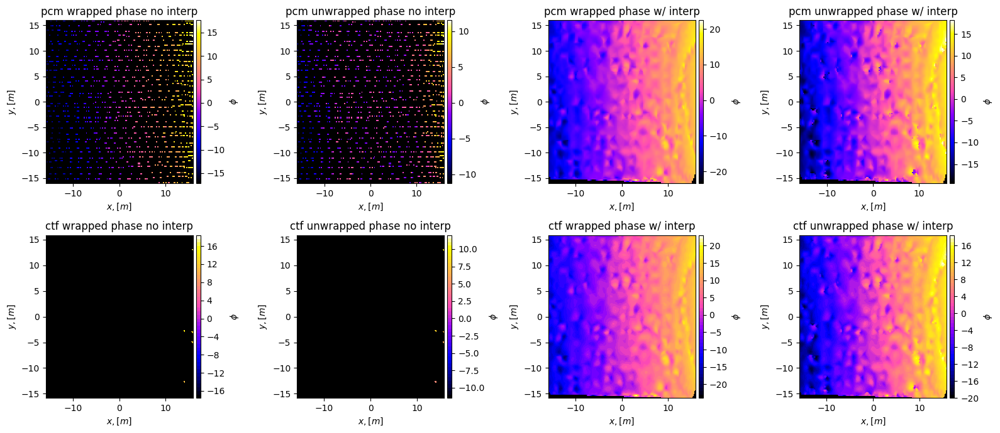

In [124]:
phi_re=(np.angle(testbeam.V_LC_cross[:,:,find,0,0])+Fringe(np.array(popt),dcoords).reshape(testbeam.V_LC_cross[:,:,find,0,0].shape))
phi_reunwrap=unwrap2d(phi_re)

phi_rei=interp_phi
phi_reiunwrap=unwrap2d(phi_rei)

fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,7))
im1=ax1.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_re,cmap='gnuplot2')
im2=ax2.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_reunwrap,cmap='gnuplot2')
im3=ax3.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_rei,cmap='gnuplot2')
im4=ax4.pcolormesh(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_reiunwrap,cmap='gnuplot2')
im5=ax5.contourf(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_re,50,cmap='gnuplot2')
im6=ax6.contourf(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_reunwrap,50,cmap='gnuplot2')
im7=ax7.contourf(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_rei,50,cmap='gnuplot2')
im8=ax8.contourf(testbeam.x_centers_grid[:,:,0],testbeam.y_centers_grid[:,:,0],phi_reiunwrap,50,cmap='gnuplot2')
images=[im1,im2,im3,im4,im5,im6,im7,im8]
titles=["pcm wrapped phase no interp","pcm unwrapped phase no interp","pcm wrapped phase w/ interp","pcm unwrapped phase w/ interp",\
        "ctf wrapped phase no interp","ctf unwrapped phase no interp","ctf wrapped phase w/ interp","ctf unwrapped phase w/ interp"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$","$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
tight_layout()

(A,B,C)=(5.436,0.209,-0.829)
(D,E,F)=(11.854,-7.616,15.083)
G=0.200
(A,B,C)=(5.381,0.213,-0.562)
(D,E,F)=(6.265,1.227,8.358)
G=0.200


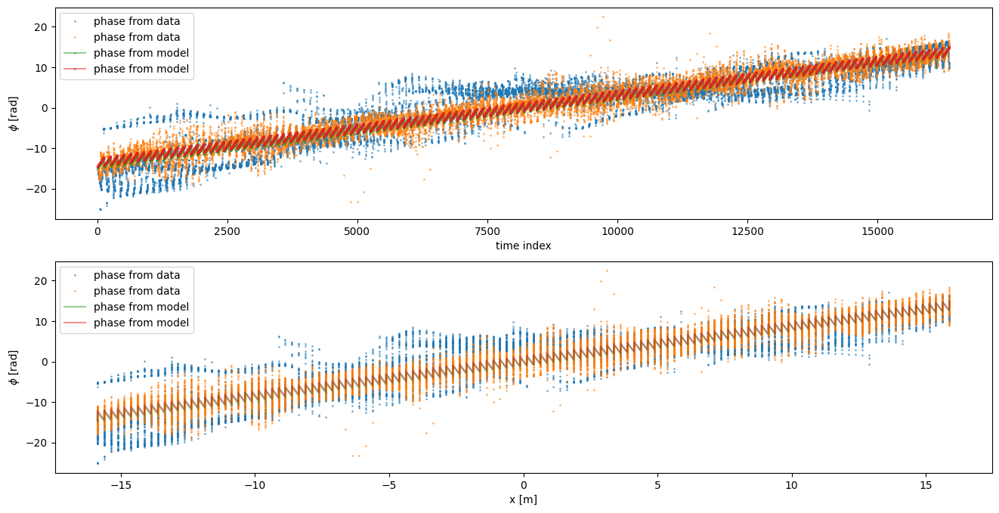

In [125]:
popt=least_squares(Fringe_Fit,x0=np.array([1.4,0.0,0.25,4.0,0.0,0.5,0.2]),args=[dcoords[~np.isnan(dcang)],dcang[~np.isnan(dcang)]]).x
print("(A,B,C)=({:.3f},{:.3f},{:.3f})".format(2*np.pi*popt[0],2*np.pi*wl*popt[1],2*np.pi*wl*popt[2]))
print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(popt[6]))
#print(Fringe(popt,dcoords[tcut]))

popt2=least_squares(Fringe_Fit,x0=np.array([1.4,0.0,0.25,0.0,0.0,0.5,0.2]),args=[dcoords[~np.isnan(interp_phi.flatten())],interp_phi[~np.isnan(interp_phi)].flatten()]).x
print("(A,B,C)=({:.3f},{:.3f},{:.3f})".format(2*np.pi*popt2[0],2*np.pi*wl*popt2[1],2*np.pi*wl*popt2[2]))
print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt2[3],popt2[4],popt2[5]))
print("G={:.3f}".format(popt2[6]))
#print(Fringe(popt,dcoords[tcut]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,8))
ax1.plot(dcang,'.',alpha=0.5,markersize=2,label='phase from data')
ax1.plot(interp_phi.flatten(),'.',alpha=0.5,markersize=2,label='phase from data')
ax1.plot(Fringe(np.array(popt),dcoords),'.-',alpha=0.5,markersize=2,label='phase from model')
ax1.plot(Fringe(np.array(popt2),dcoords),'.-',alpha=0.5,markersize=2,label='phase from model')
ax1.set_xlabel("time index")
ax1.set_ylabel("$\phi$ [rad]")
ax1.legend()
ax2.plot(dcoords[:,0],dcang,'.',alpha=0.5,markersize=2,label='phase from data')
ax2.plot(dcoords[:,0],interp_phi.flatten(),'.',alpha=0.5,markersize=2,label='phase from data')
ax2.plot(dcoords[:,0],Fringe(np.array(popt),dcoords),'-',alpha=0.5,markersize=2,label='phase from model')
ax2.plot(dcoords[:,0],Fringe(np.array(popt2),dcoords),'-',alpha=0.5,markersize=2,label='phase from model')

#ax2.plot(testbeam.x_centers_grid[:,:,0].flatten(),(phi1+Fringe(np.array(popt),dcoords).reshape(128,128)).flatten(),'.')
#ax2.plot(dcoords[tcut][:,0],Fringe(np.array([1.5,0.1,0.4,0.0,0.0,0.9,0.9]),dcoords[tcut]),'.',label='phase from model')
ax2.set_xlabel("x [m]")
ax2.set_ylabel("$\phi$ [rad]")
ax2.legend()

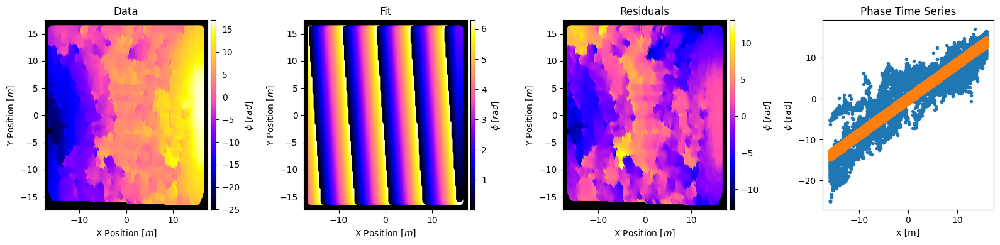

In [126]:
fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im2=ax2.scatter(dx,dy,s=50,c=Fringe(popt,dcoords)%(2*np.pi),cmap='gnuplot2')
#im2=ax2.pcolormesh(dxax,dyax,Fringe(popt,np.array([griddx.flatten(),griddy.flatten(),30*np.ones(len(griddx.flatten()))]).T).reshape(griddx.shape),cmap='gnuplot2',alpha=0.6)
#im1=ax2.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im3=ax3.scatter(dx,dy,s=50,c=(dcang-Fringe(popt,dcoords)),cmap='gnuplot2')
ax4.plot(dcoords[:,0],dcang,'.')
ax4.plot(dcoords[:,0],Fringe(np.array(popt),dcoords),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()

In [58]:
def Fringe_Spacing(freq,find,h,b,x=0):
    
    f = freq
    wavelength=3e8/(f*1e6)
    print('lambda at f_ind 345: {}'.format(wavelength))
    
    if x==0:
        theta=np.pi/2
    else:
        theta = np.arctan(h/np.abs(x))
        
    print(np.sin(theta))
    dtheta=wavelength/(b*np.sin(theta))
    print('delta theta at find={} in radians: {}'.format(find,dtheta))
    x_dist = h*np.tan(dtheta)
    print('Delta_x: {}'.format(x_dist))
    
    return x_dist

In [61]:
Fringe_Spacing(testbeam.freq[340],340,20,13.5,x=testbeam.x_centers[50,0])

lambda at f_ind 345: 0.4496487119437939
0.5605146115728086
delta theta at find=340 in radians: 0.0594227363714498
Delta_x: 1.1898555416230296


1.1898555416230296

In [60]:
np.arctan(20/np.abs(testbeam.x_centers[50,0]))

0.5950070725094485

## FF phase extraction for EW pol flight

start of concat loop is: 2024-11-04 22:41:59.335160
end of concat loop is: 2024-11-04 22:46:59.40477324,           


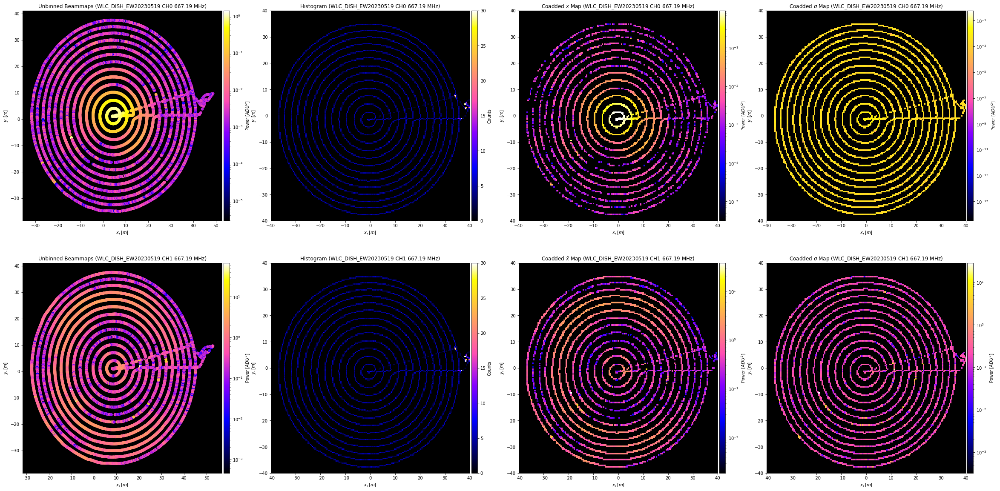

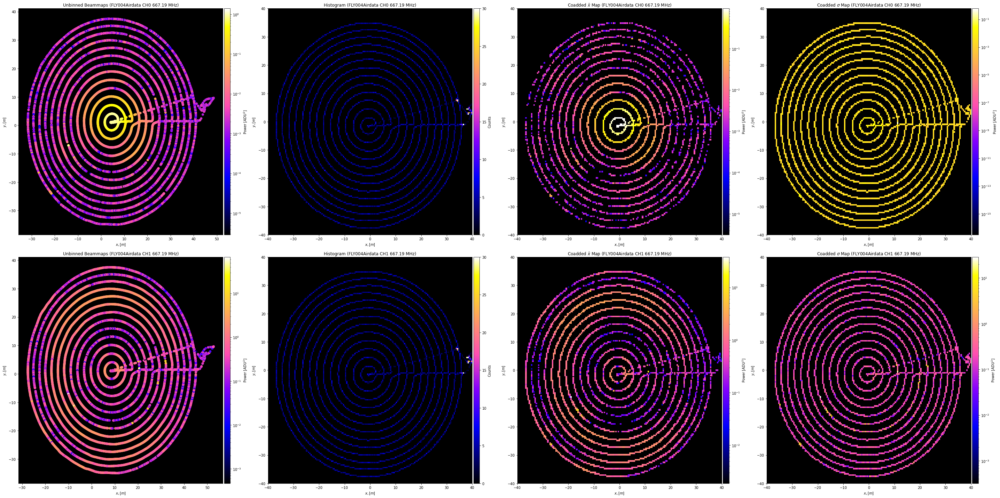

In [122]:
# Create the beammap class for FF Flight, EW Pol:

FFEWbeam=beammap.Beammap(concatlist=[pcklarr[3]],gfitlist=[gfitarr[3]],\
                         ## These parameters might be interesting to explore: [xmin,xmax,dx],[ymin,ymax,dy], frequency plotted
                         d0args=[-40,40,0.45],d1args=[-40,40,0.45],f_index_cc=340,\
                         normalization='Gauss',operation='coadd',
                         pickle_directory="/hirax/20240308_WLC_NFandFF/products/pickles/",\
                         gfit_directory="/hirax/20240308_WLC_NFandFF/products/gfits/",\
                         flightmasterpath="20240308_WLC_flights_forscripts.yaml",\
                         vplot=True,include_cross_data=True)

#export pickle for reduced class data for beammap function (include_cross_data=True will save V_cross_bgsub):
# thingy = rc.Smallify_comap(beamclass=testbeam,pickle_directory="/home/tyndall/Desktop/20240308_WLC_NFandFF/products/beam_pickles/",include_cross_data=True)
# print(thingy.tmppath)
# with open(thingy.tmppath, 'wb') as outp:
#     pickle.dump(thingy, outp, pickle.HIGHEST_PROTOCOL)
# print('DONE')

In [123]:
FFEWbeam.complex_interpolation(d0_interp=FFEWbeam.d0_centers[:,0], d1_interp=FFEWbeam.d1_centers[:,0],method='cubic',variogram_model='spherical',outputs=False,Fargs=[340,340])

<ipython-input-124-4fb7d58f2b99>:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax1.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.V_LC_cross.real[:,:,find,0,0])
<ipython-input-124-4fb7d58f2b99>:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax2.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.V_LC_cross.imag[:,:,find,0,0])
<ipython-input-124-4fb7d58f2b99>:7: MatplotlibDeprecationWar

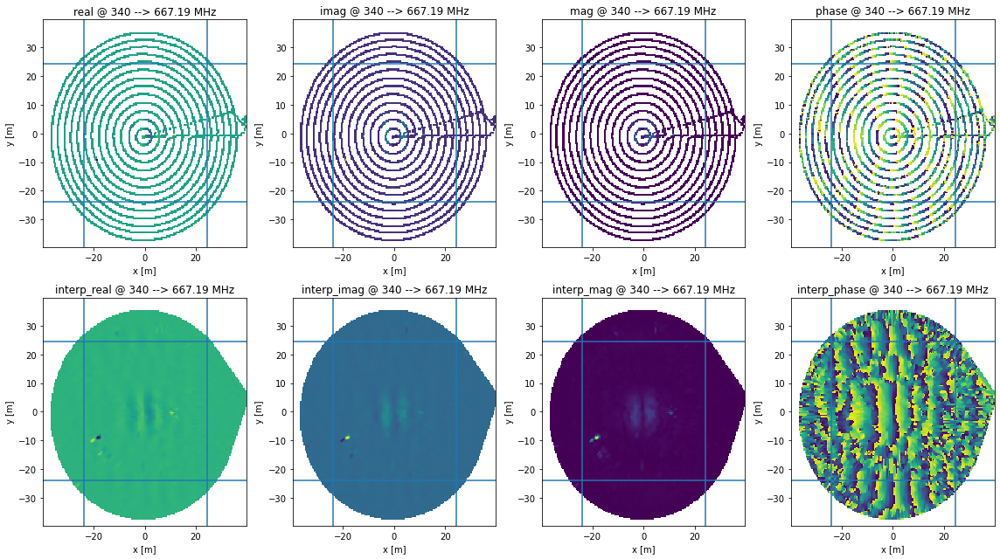

In [124]:
## plot the results of the interpolation and find where to cut to eliminate NAN values:

fig,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,9))
find=340
ax1.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.V_LC_cross.real[:,:,find,0,0])
ax2.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.V_LC_cross.imag[:,:,find,0,0])
ax3.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],np.abs(FFEWbeam.V_LC_cross)[:,:,find,0,0])#,norm=LogNorm())
ax4.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],np.angle(FFEWbeam.V_LC_cross)[:,:,find,0,0])

ax5.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.beam_linear_interp.real[:,:,find,0])
ax6.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.beam_linear_interp.imag[:,:,find,0])
ax7.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.beam_linear_interp_amp[:,:,find,0])#,norm=LogNorm())
ax8.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],FFEWbeam.beam_linear_interp_phase[:,:,find,0])

titles=['real','imag','mag','phase','interp_real','interp_imag','interp_mag','interp_phase']
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i]+' @ {} --> {:.2f} MHz'.format(find,FFNSbeam.freq[find]))
    ax.set_xlabel('x [m]')
    ax.set_ylabel('y [m]')
    ## Plot the lines where we will do the reassignment/dimension change
    ax.axvline(FFEWbeam.d0_centers_grid[35,0,0])
    ax.axhline(FFEWbeam.d1_centers_grid[0,35,0])
    ax.axvline(FFEWbeam.d0_centers_grid[-35,0,0])
    ax.axhline(FFEWbeam.d1_centers_grid[0,-35,0])
    
tight_layout()

In [125]:
## This is where we reassign the arrays to a restricted range (inside the lines above)--this is to remove NaNs before interpolating
## Careful not to run this twice, or things will start to break!

stop # comment this out after you've run it once
xmin,xmax,ymin,ymax=[35,-35,35,-35]
FFEWbeam.beam_linear_interp=FFEWbeam.beam_linear_interp[xmin:xmax,ymin:ymax]
FFEWbeam.beam_linear_interp_amp=FFEWbeam.beam_linear_interp_amp[xmin:xmax,ymin:ymax]
FFEWbeam.beam_linear_interp_phase=FFEWbeam.beam_linear_interp_phase[xmin:xmax,ymin:ymax]
FFEWbeam.beam_linear_interp_phase_unwrapped=FFEWbeam.beam_linear_interp_phase_unwrapped[xmin:xmax,ymin:ymax]
FFEWbeam.histogram_LC=FFEWbeam.histogram_LC[xmin:xmax,ymin:ymax]
FFEWbeam.V_LC_cross=FFEWbeam.V_LC_cross[xmin:xmax,ymin:ymax]
FFEWbeam.V_LC_mean=FFEWbeam.V_LC_mean[xmin:xmax,ymin:ymax]
FFEWbeam.V_LC_operation=FFEWbeam.V_LC_operation[xmin:xmax,ymin:ymax]
FFEWbeam.V_LC_std=FFEWbeam.V_LC_std[xmin:xmax,ymin:ymax]
FFEWbeam.d0_centers_grid=FFEWbeam.d0_centers_grid[xmin:xmax,ymin:ymax]
FFEWbeam.d0_edges_grid=FFEWbeam.d0_edges_grid[xmin:xmax,ymin:ymax]
FFEWbeam.d1_centers_grid=FFEWbeam.d1_centers_grid[xmin:xmax,ymin:ymax]
FFEWbeam.d1_edges_grid=FFEWbeam.d1_edges_grid[xmin:xmax,ymin:ymax]
    
FFEWbeam.d0_centers=FFEWbeam.d0_centers[xmin:xmax]
FFEWbeam.d0_edges=FFEWbeam.d0_edges[xmin:xmax]
FFEWbeam.d1_centers=FFEWbeam.d1_centers[ymin:ymax]
FFEWbeam.d1_edges=FFEWbeam.d1_edges[ymin:ymax]

### The cell here is the main part where we unwrap the phase

There's some more fitting and stuff further down, but this is the main part!

<ipython-input-128-0203ee5cd773>:11: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1=ax1.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
<ipython-input-128-0203ee5cd773>:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2=ax2.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1unwrap,cmap='gnuplot2')
<ipython-input-128-0203ee5cd773>:13: MatplotlibDeprecationWarning: shading='flat

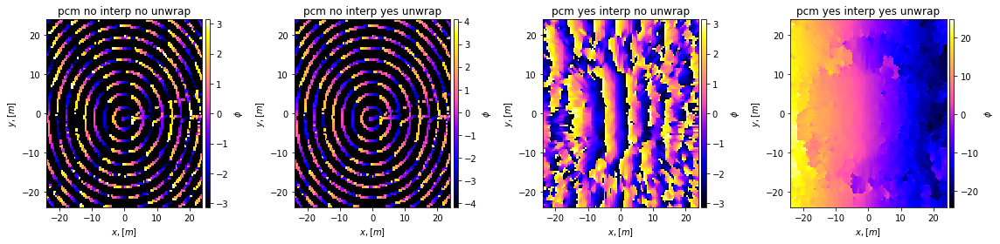

In [128]:
# Perform the phase unwrapping and plot the results, hopefully it appears as a gradient!
## pick a frequency by changing 'find', but be careful to change it in the other places it appears...

fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
find=331
phi1=np.angle(FFEWbeam.V_LC_cross[:,:,find,0,0])
phi1unwrap=unwrap2d(phi1)
phi_i=FFEWbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

im1=ax1.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2=ax2.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1unwrap,cmap='gnuplot2')
im3=ax3.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im4=ax4.pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2')
images=[im1,im2,im3,im4]
titles=["pcm no interp no unwrap","pcm no interp yes unwrap","pcm yes interp no unwrap","pcm yes interp yes unwrap"]
cbarlabels=["$\phi$","$\phi$","$\phi$","$\phi$"]
for j,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[j])
    ax.set_facecolor('k')
    ax.set_xlabel('$x,[m]$')
    ax.set_ylabel('$y, [m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig.colorbar(images[j],cax=cax)
    cbar.set_label(cbarlabels[j])
# for ax in [ax2,ax5,ax6]:
#     ax.plot(range(-20,20),range(-20,20),'r-',linewidth=10)
tight_layout()


(A,B,C)=(-6.064634,-0.280253,-0.000363)
G=0.000


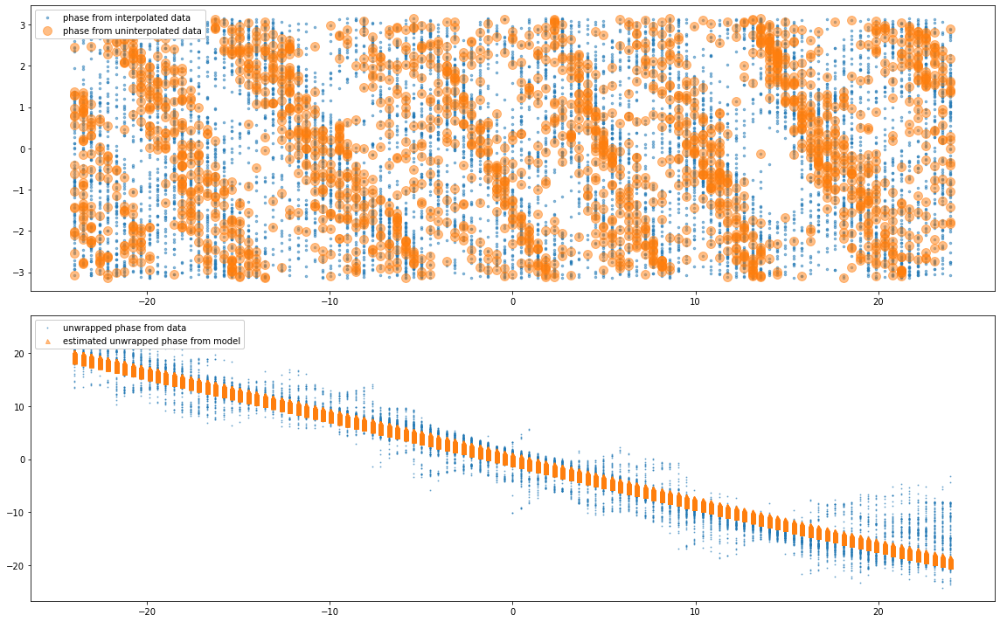

In [129]:
## Plot the wrapped and unwrapped phase, and see if a linear regression fits to the data... it should have a slope!

find=331

dx=FFEWbeam.d0_centers_grid[:,:,0]
dy=FFEWbeam.d1_centers_grid[:,:,0]
wl=(3.0e8/(FFEWbeam.freq[find]*1e6))
dc=(FFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
dcabs=np.abs(FFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()

phi1=np.angle(FFEWbeam.V_LC_cross[:,:,find,0,0])
phi1unwrap=unwrap2d(phi1)
phi_i=FFEWbeam.beam_linear_interp_phase[:,:,find,0]
phi_iunwrap=unwrap2d(phi_i)

dcang=phi_iunwrap.flatten()

dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(100*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))


def Fringe_Fit(P,dronepos,V,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi-V

def Fringe(P,dronepos,wavelengthm):
    A,B,C,G=P
    phi=(2.0*np.pi/wavelengthm)*((A*(dronepos[:,0]))+(B*(dronepos[:,1]))+(C*(dronepos[:,2])))
    return phi

popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
print("(A,B,C)=({:f},{:f},{:f})".format(popt[0],popt[1],popt[2]))
# print("(D,E,F)=({:.3f},{:.3f},{:.3f})".format(popt[3],popt[4],popt[5]))
print("G={:.3f}".format(popt[3]))

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
ax1.plot(dcoords[:,0],phi_i.flatten(),'.',alpha=0.5,markersize=5,label='phase from interpolated data')
ax1.plot(dcoords[:,0],phi1.flatten(),'.',alpha=0.5,markersize=20,label='phase from uninterpolated data')
ax1.legend(loc=2,framealpha=1)
ax2.plot(dcoords[:,0],dcang,'.',alpha=0.5,markersize=2,label='unwrapped phase from data')
ax2.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'^',alpha=0.5,markersize=5,label='estimated unwrapped phase from model')
ax2.legend(loc=2,framealpha=1)
tight_layout()


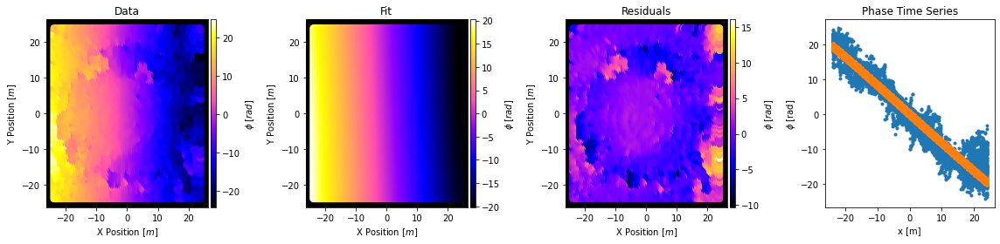

In [130]:
## Plot some stuff

fig1,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4))
im1=ax1.scatter(dx,dy,s=50,c=dcang,cmap='gnuplot2')
im2=ax2.scatter(dx,dy,s=50,c=Fringe(popt,unitvects,wl),cmap='gnuplot2')
im3=ax3.scatter(dx,dy,s=50,c=(dcang-Fringe(popt,unitvects,wl)),cmap='gnuplot2')
ax4.plot(dcoords[:,0],dcang,'.')
ax4.plot(dcoords[:,0],Fringe(np.array(popt),unitvects,wl),'.')
images=[im1,im2,im3]
cbars=['$\phi$ [$rad$]','$\phi$ [$rad$]','$\phi$ [$rad$]']
titles=["Data","Fit","Residuals","Phase Time Series"]
for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()


<ipython-input-131-0e2a1d661572>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im1 = ax[0].pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
<ipython-input-131-0e2a1d661572>:4: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im2 = ax[1].pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
<ipython-input-131-0e2a1d661572>:5: MatplotlibDeprecationWarning: shading='flat

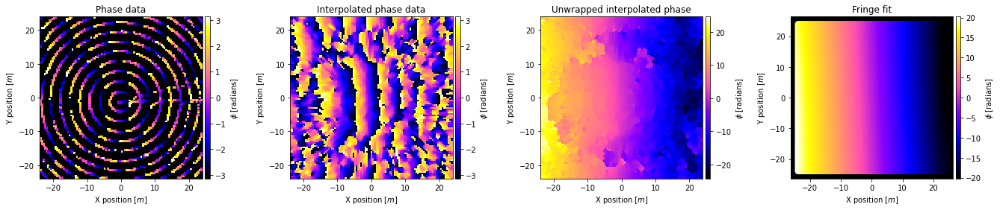

In [131]:
# plots for presentation
fig, ax = subplots(nrows=1,ncols=4, figsize=(23, 4))
im1 = ax[0].pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi1,cmap='gnuplot2')
im2 = ax[1].pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi_i,cmap='gnuplot2')
im3 = ax[2].pcolormesh(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],phi_iunwrap,cmap='gnuplot2') # the unwrapped interped data
im4 = ax[3].scatter(dx,dy,s=50,c=Fringe(popt,unitvects,wl),cmap='gnuplot2') # the fringe fit
# possibly add the final phase after it's subtracted?

images=[im1,im2,im3,im4]
titles=['Phase data','Interpolated phase data','Unwrapped interpolated phase','Fringe fit']
for i, ax in enumerate(ax):
    ax.set_facecolor('k')
    ax.set_xlabel('X position $[m]$')
    ax.set_ylabel('Y position $[m]$')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right',size='3%',pad=0.05)
    cbar=fig.colorbar(images[i],cax=cax)
    cbar.set_label('$\phi$ [radians]')
    ax.set_title(titles[i])
    ax.set_aspect('equal')

In [132]:
## Fitting loop for the fringing formula?

dx=FFEWbeam.d0_centers_grid[:,:,0]
dy=FFEWbeam.d1_centers_grid[:,:,0]
dcoords=np.zeros((dx.shape[0]*dx.shape[1],3))
dcoords[:,0]=dx.flatten()
dcoords[:,1]=dy.flatten()
dcoords[:,2]=(97*np.ones((dx.shape[0]*dx.shape[1]))).flatten()
unitvects=dcoords*np.outer(np.nansum((dcoords)**2.0,axis=1)**-0.5,np.ones(3))

## I think this loop breaks when np.NaN occurs in the phi_i stage of the loop... going to check testbeam.beam_linear_interp_phase[:,:,find,0] for nan for each find...
fringepopt=np.NaN*np.ones((140,4))
fringedata=np.NaN*np.ones((107,107,140))
for k,find in enumerate(range(250,390)):
    print("{},{}".format(k,find),end='\r')
    wl=(3.0e8/(FFEWbeam.freq[find]/1e-6))
    dc=(FFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
    dcabs=np.abs(FFEWbeam.V_LC_cross[:,:,find,0,0]).flatten()
    phi_i=FFEWbeam.beam_linear_interp_phase[:,:,find,0]
    if True in np.isnan(FFEWbeam.beam_linear_interp_phase[:,:,find,0]):
        print('true, breaking loop to skip index {}'.format(k))
    else:
        phi_iunwrap=unwrap2d(phi_i,wrap_args=(False,True))
        dcang=phi_iunwrap.flatten()
        fringedata[:,:,k]=phi_iunwrap
        popt=least_squares(Fringe_Fit,x0=np.array([0.0,0.0,0.0,0.0]),args=[unitvects[~np.isnan(dcang)],dcang[~np.isnan(dcang)],wl]).x
        fringepopt[k,:]=popt    

true, breaking loop to skip index 71
true, breaking loop to skip index 85
true, breaking loop to skip index 134
true, breaking loop to skip index 135
true, breaking loop to skip index 137
true, breaking loop to skip index 138


<ipython-input-134-975de2c9662f>:19: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
<ipython-input-134-975de2c9662f>:22: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')


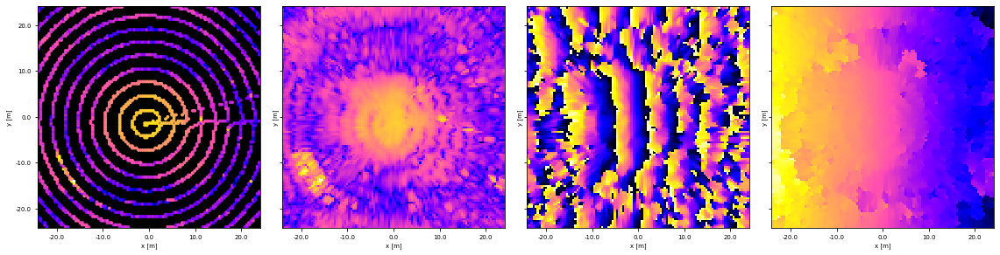

In [134]:
## This was where i was making plots for a presentation, nothing vital here!
# Will made these and it's just more plots of the phase
FFEWbeam.beam_linear_interp_phase_unwrapped.shape

fig,[ax1,ax2,ax3,ax4]=subplots(nrows=1,ncols=4,figsize=(16,4),sharex=True,sharey=True)
ax1.set_facecolor('k')
find=331
ax1.scatter(FFEWbeam.d0_centers_grid[:,:,0],FFEWbeam.d1_centers_grid[:,:,0],c=np.abs(FFEWbeam.V_LC_cross[:,:,find,0,0]),cmap='gnuplot2',s=8,norm=LogNorm())
#ax1.pcolormesh(testbeam.x_edges_grid[:,:,0],testbeam.y_edges_grid[:,:,0],(testbeam.V_LC_mean[:,:,find,0,0]),cmap='gnuplot2',norm=LogNorm())
ax2.pcolormesh(FFEWbeam.d0_edges_grid[:,:,0],FFEWbeam.d1_edges_grid[:,:,0],(FFEWbeam.beam_linear_interp_amp[:,:,find,0]),cmap='gnuplot2',norm=LogNorm())
ax1.set_xlim(ax2.get_xlim())
ax1.set_ylim(ax2.get_ylim())
ax3.pcolormesh(FFEWbeam.d0_edges_grid[:,:,0],FFEWbeam.d1_edges_grid[:,:,0],FFEWbeam.beam_linear_interp_phase[:,:,find,0],cmap='gnuplot2')
ax4.pcolormesh(FFEWbeam.d0_edges_grid[:,:,0],FFEWbeam.d1_edges_grid[:,:,0],fringedata[:,:,find-250],cmap='gnuplot2')

for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    #ax.title(fontsize='x-small')
    ax.set_xlabel('x [m]',fontsize='x-small')
    ax.set_xticklabels(ax.get_xticks(),fontsize='x-small')
    #ax.set_xticks([])
    ax.set_ylabel('y [m]',fontsize='x-small')
    ax.set_yticklabels(ax.get_yticks(),fontsize='x-small')
    #ax.set_yticks([])
    ax.set(aspect='equal')


tight_layout()


<ipython-input-135-5d3e4acfd8b6>:14: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(dx, dy, fringedata[:,:,zez])
<ipython-input-135-5d3e4acfd8b6>:15: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1].pcolormesh(dx, dy, Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape),cmap='gnuplot2')
<ipython-input-135-5d3e4acfd8b6>:19: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Eith

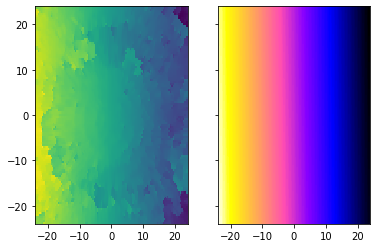

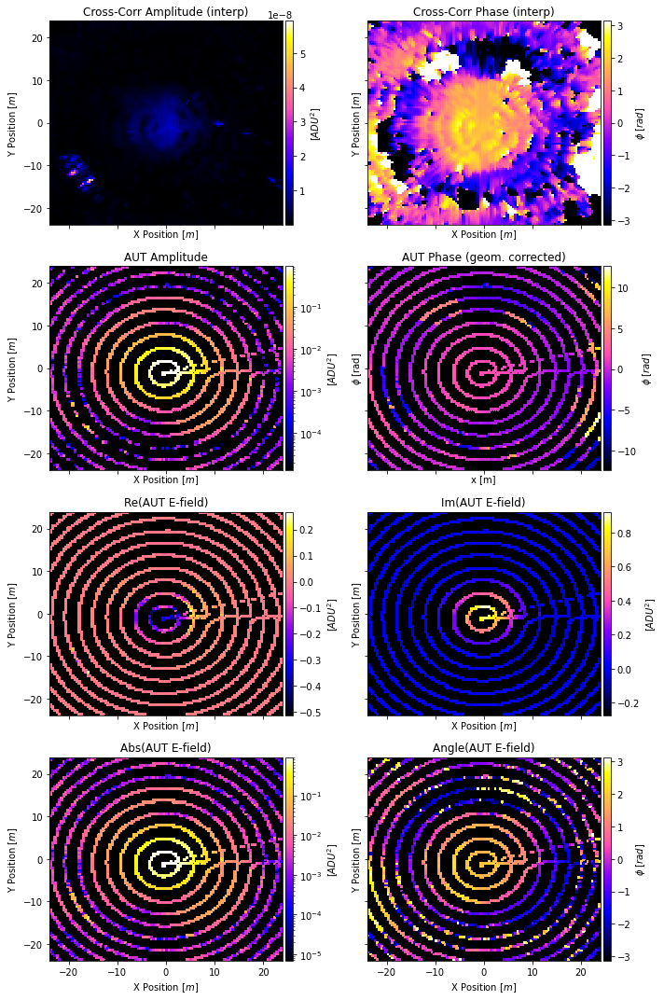

In [135]:
# here, we put the phase and the amplitude together into a complex electric field

find=331
wl=(3.0e10/(FFEWbeam.freq[find]/1e-6))
zez=find-250
# zez=0
ampl=FFEWbeam.V_LC_mean[:,:,250+zez,0,0]
nanmask=ampl/ampl
phase=fringedata[:,:,zez]-Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape)
phasefactor=np.e**(1.0j*phase)
cplxEfieldEWFF=ampl*phasefactor

fig,ax=subplots(nrows=1,ncols=2,sharex=True,sharey=True)
ax[0].pcolormesh(dx, dy, fringedata[:,:,zez])
ax[1].pcolormesh(dx, dy, Fringe(fringepopt[zez],dcoords,wl).reshape(dx.shape),cmap='gnuplot2')


fig,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8]]=subplots(nrows=4,ncols=2,figsize=(10,15),sharex=True,sharey=True)
im1=ax1.pcolormesh(dx, dy, FFEWbeam.beam_linear_interp_amp[:,:,250+zez,0], cmap='gnuplot2')
im2=ax2.pcolormesh(dx, dy, phase, cmap='gnuplot2',vmin=-np.pi, vmax=np.pi)
im3=ax3.pcolormesh(dx, dy, ampl, norm=LogNorm(), cmap='gnuplot2')
im4=ax4.pcolormesh(dx, dy, nanmask*phase, cmap='gnuplot2')
im5=ax5.pcolormesh(dx, dy, np.real(cplxEfieldEWFF), cmap='gnuplot2')
im6=ax6.pcolormesh(dx, dy, np.imag(cplxEfieldEWFF), cmap='gnuplot2')
im7=ax7.pcolormesh(dx, dy, np.abs(cplxEfieldEWFF),cmap='gnuplot2', norm=LogNorm())
im8=ax8.pcolormesh(dx, dy, np.angle(cplxEfieldEWFF), cmap='gnuplot2')

images=[im1,im2,im3,im4,im5,im6,im7,im8]
cbars=['[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','$\phi$ [$rad$]','[$ADU^2$]','[$ADU^2$]','[$ADU^2$]','$\phi$ [$rad$]']
titles=["Cross-Corr Amplitude (interp)","Cross-Corr Phase (interp)","AUT Amplitude","AUT Phase (geom. corrected)","Re(AUT E-field)","Im(AUT E-field)","Abs(AUT E-field)","Angle(AUT E-field)"]
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_facecolor("k")
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(images[i],cax=cax)
    cbar.set_label(cbars[i])
for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_title(titles[i])
ax4.set_xlabel("x [m]")
ax4.set_ylabel("$\phi$ [rad]")
tight_layout()
